# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:28, 6.50MB/s]                              
SVHN Testing Set: 64.3MB [00:09, 6.77MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

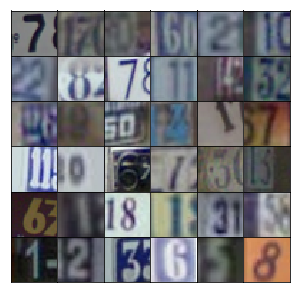

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu1, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256
        
        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
                
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [20]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 2.4655... Generator Loss: 0.1999
Epoch 1/25... Discriminator Loss: 1.1857... Generator Loss: 0.8440
Epoch 1/25... Discriminator Loss: 0.6764... Generator Loss: 1.4872
Epoch 1/25... Discriminator Loss: 0.6149... Generator Loss: 1.3872
Epoch 1/25... Discriminator Loss: 0.6332... Generator Loss: 1.6219
Epoch 1/25... Discriminator Loss: 0.3258... Generator Loss: 1.8618
Epoch 1/25... Discriminator Loss: 0.3662... Generator Loss: 1.8327
Epoch 1/25... Discriminator Loss: 0.3748... Generator Loss: 2.1340
Epoch 1/25... Discriminator Loss: 0.4710... Generator Loss: 1.5096
Epoch 1/25... Discriminator Loss: 0.4456... Generator Loss: 1.9727


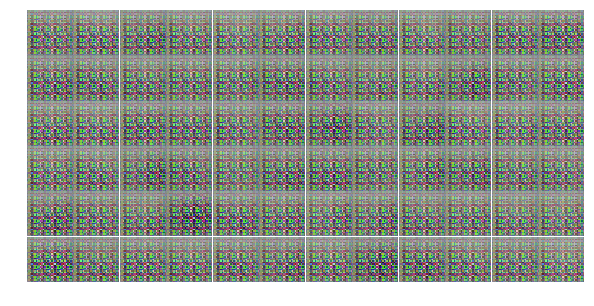

Epoch 1/25... Discriminator Loss: 0.4390... Generator Loss: 1.6562
Epoch 1/25... Discriminator Loss: 0.5598... Generator Loss: 1.7018
Epoch 1/25... Discriminator Loss: 0.7572... Generator Loss: 1.4226
Epoch 1/25... Discriminator Loss: 0.6602... Generator Loss: 1.5396
Epoch 1/25... Discriminator Loss: 0.6987... Generator Loss: 1.4645
Epoch 1/25... Discriminator Loss: 0.5271... Generator Loss: 1.6073
Epoch 1/25... Discriminator Loss: 0.5102... Generator Loss: 1.6787
Epoch 1/25... Discriminator Loss: 0.5041... Generator Loss: 1.6709
Epoch 1/25... Discriminator Loss: 0.5781... Generator Loss: 1.4297
Epoch 1/25... Discriminator Loss: 0.6277... Generator Loss: 1.1756


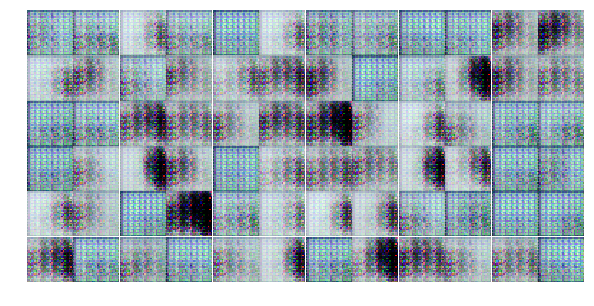

Epoch 1/25... Discriminator Loss: 0.7529... Generator Loss: 1.1788
Epoch 1/25... Discriminator Loss: 0.5798... Generator Loss: 1.4959
Epoch 1/25... Discriminator Loss: 0.8733... Generator Loss: 0.9810
Epoch 1/25... Discriminator Loss: 0.7771... Generator Loss: 0.9615
Epoch 1/25... Discriminator Loss: 0.8871... Generator Loss: 0.9785
Epoch 1/25... Discriminator Loss: 1.0733... Generator Loss: 0.8181
Epoch 1/25... Discriminator Loss: 0.9557... Generator Loss: 1.0986
Epoch 1/25... Discriminator Loss: 1.0846... Generator Loss: 0.9148
Epoch 1/25... Discriminator Loss: 1.0736... Generator Loss: 1.0213
Epoch 1/25... Discriminator Loss: 1.1025... Generator Loss: 0.8736


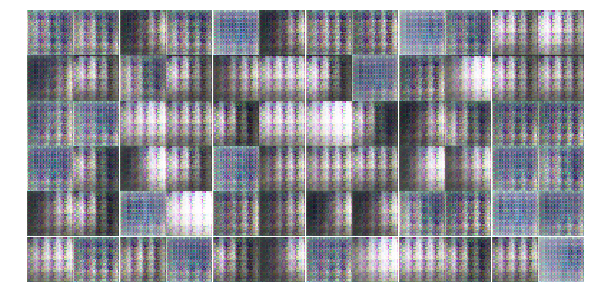

Epoch 1/25... Discriminator Loss: 1.2170... Generator Loss: 0.8621
Epoch 1/25... Discriminator Loss: 1.2021... Generator Loss: 0.8632
Epoch 1/25... Discriminator Loss: 0.9634... Generator Loss: 0.9858
Epoch 1/25... Discriminator Loss: 1.1268... Generator Loss: 1.0486
Epoch 1/25... Discriminator Loss: 1.0141... Generator Loss: 1.1042
Epoch 1/25... Discriminator Loss: 0.8556... Generator Loss: 1.2746
Epoch 1/25... Discriminator Loss: 1.1383... Generator Loss: 1.0019
Epoch 1/25... Discriminator Loss: 1.1335... Generator Loss: 0.9203
Epoch 1/25... Discriminator Loss: 0.9248... Generator Loss: 1.0241
Epoch 1/25... Discriminator Loss: 1.0752... Generator Loss: 0.9905


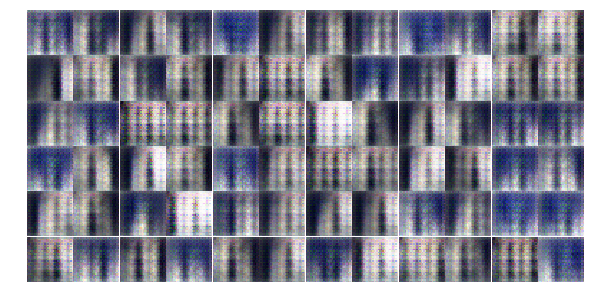

Epoch 1/25... Discriminator Loss: 0.8523... Generator Loss: 1.0533
Epoch 1/25... Discriminator Loss: 0.8466... Generator Loss: 1.1816
Epoch 1/25... Discriminator Loss: 1.0085... Generator Loss: 0.8668
Epoch 1/25... Discriminator Loss: 0.9439... Generator Loss: 1.3317
Epoch 1/25... Discriminator Loss: 1.0886... Generator Loss: 0.8988
Epoch 1/25... Discriminator Loss: 1.0768... Generator Loss: 0.8551
Epoch 1/25... Discriminator Loss: 1.0963... Generator Loss: 0.8737
Epoch 1/25... Discriminator Loss: 1.0516... Generator Loss: 1.0248
Epoch 1/25... Discriminator Loss: 1.0804... Generator Loss: 0.8908
Epoch 1/25... Discriminator Loss: 1.1183... Generator Loss: 1.0871


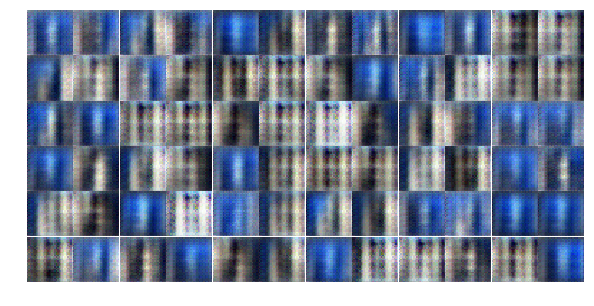

Epoch 1/25... Discriminator Loss: 1.0507... Generator Loss: 0.9929
Epoch 1/25... Discriminator Loss: 0.9846... Generator Loss: 0.9098
Epoch 1/25... Discriminator Loss: 0.8401... Generator Loss: 1.1619
Epoch 1/25... Discriminator Loss: 1.0118... Generator Loss: 0.9606
Epoch 1/25... Discriminator Loss: 0.8252... Generator Loss: 1.1859
Epoch 1/25... Discriminator Loss: 0.7621... Generator Loss: 1.4722
Epoch 1/25... Discriminator Loss: 1.0281... Generator Loss: 0.9624
Epoch 2/25... Discriminator Loss: 0.9418... Generator Loss: 1.0725
Epoch 2/25... Discriminator Loss: 0.9806... Generator Loss: 1.0201
Epoch 2/25... Discriminator Loss: 1.0998... Generator Loss: 0.7706


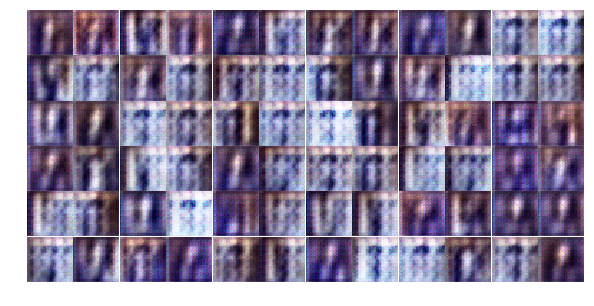

Epoch 2/25... Discriminator Loss: 1.0907... Generator Loss: 0.8449
Epoch 2/25... Discriminator Loss: 0.9215... Generator Loss: 1.2742
Epoch 2/25... Discriminator Loss: 1.0054... Generator Loss: 1.0872
Epoch 2/25... Discriminator Loss: 0.6970... Generator Loss: 1.5834
Epoch 2/25... Discriminator Loss: 1.1405... Generator Loss: 0.8090
Epoch 2/25... Discriminator Loss: 1.1038... Generator Loss: 0.8568
Epoch 2/25... Discriminator Loss: 0.8944... Generator Loss: 1.2282
Epoch 2/25... Discriminator Loss: 0.9885... Generator Loss: 1.3170
Epoch 2/25... Discriminator Loss: 1.2214... Generator Loss: 0.9807
Epoch 2/25... Discriminator Loss: 0.7721... Generator Loss: 1.2994


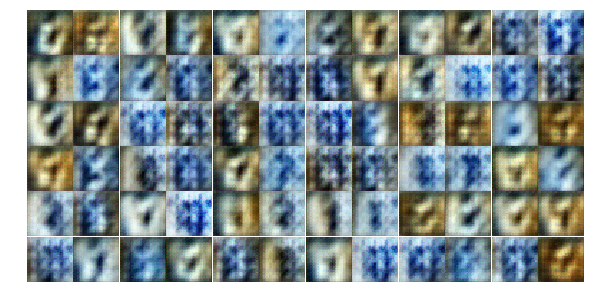

Epoch 2/25... Discriminator Loss: 1.0673... Generator Loss: 0.9622
Epoch 2/25... Discriminator Loss: 1.1704... Generator Loss: 0.8808
Epoch 2/25... Discriminator Loss: 0.7421... Generator Loss: 1.6894
Epoch 2/25... Discriminator Loss: 0.8296... Generator Loss: 1.1633
Epoch 2/25... Discriminator Loss: 1.1062... Generator Loss: 0.8762
Epoch 2/25... Discriminator Loss: 1.1862... Generator Loss: 0.8835
Epoch 2/25... Discriminator Loss: 1.2691... Generator Loss: 0.6368
Epoch 2/25... Discriminator Loss: 1.4570... Generator Loss: 0.6238
Epoch 2/25... Discriminator Loss: 1.0450... Generator Loss: 0.9404
Epoch 2/25... Discriminator Loss: 1.2701... Generator Loss: 0.6758


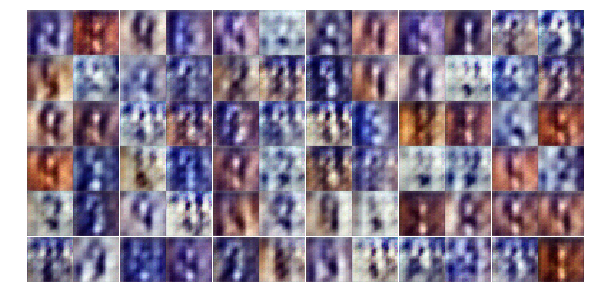

Epoch 2/25... Discriminator Loss: 1.2788... Generator Loss: 0.8685
Epoch 2/25... Discriminator Loss: 1.2547... Generator Loss: 0.8638
Epoch 2/25... Discriminator Loss: 1.1099... Generator Loss: 1.0997
Epoch 2/25... Discriminator Loss: 1.1467... Generator Loss: 0.8759
Epoch 2/25... Discriminator Loss: 1.1122... Generator Loss: 1.0987
Epoch 2/25... Discriminator Loss: 1.1024... Generator Loss: 0.9498
Epoch 2/25... Discriminator Loss: 1.1165... Generator Loss: 1.3189
Epoch 2/25... Discriminator Loss: 1.2317... Generator Loss: 0.7630
Epoch 2/25... Discriminator Loss: 0.9766... Generator Loss: 0.9481
Epoch 2/25... Discriminator Loss: 1.1004... Generator Loss: 0.9536


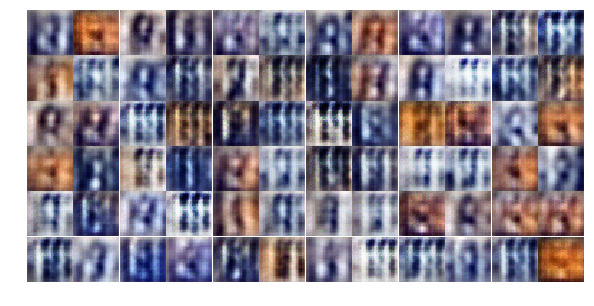

Epoch 2/25... Discriminator Loss: 1.0547... Generator Loss: 0.9852
Epoch 2/25... Discriminator Loss: 1.1271... Generator Loss: 0.8421
Epoch 2/25... Discriminator Loss: 1.1242... Generator Loss: 0.8429
Epoch 2/25... Discriminator Loss: 1.1401... Generator Loss: 0.7125
Epoch 2/25... Discriminator Loss: 1.1078... Generator Loss: 0.8722
Epoch 2/25... Discriminator Loss: 1.2962... Generator Loss: 0.6978
Epoch 2/25... Discriminator Loss: 1.1418... Generator Loss: 0.8164
Epoch 2/25... Discriminator Loss: 1.2162... Generator Loss: 0.8539
Epoch 2/25... Discriminator Loss: 0.9552... Generator Loss: 1.0757
Epoch 2/25... Discriminator Loss: 1.5408... Generator Loss: 0.4833


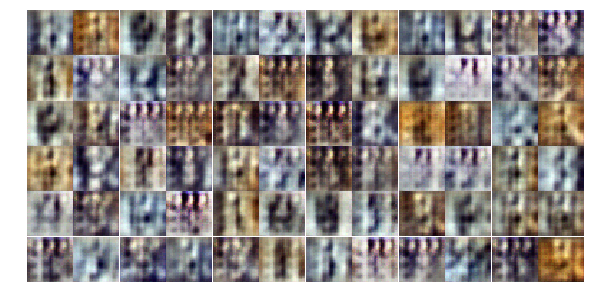

Epoch 2/25... Discriminator Loss: 1.3255... Generator Loss: 0.8227
Epoch 2/25... Discriminator Loss: 0.9509... Generator Loss: 1.0538
Epoch 2/25... Discriminator Loss: 1.0505... Generator Loss: 0.8706
Epoch 2/25... Discriminator Loss: 1.1430... Generator Loss: 0.9340
Epoch 2/25... Discriminator Loss: 1.1533... Generator Loss: 0.6819
Epoch 2/25... Discriminator Loss: 1.5200... Generator Loss: 0.4859
Epoch 2/25... Discriminator Loss: 1.3530... Generator Loss: 1.0546
Epoch 2/25... Discriminator Loss: 1.1805... Generator Loss: 1.1381
Epoch 2/25... Discriminator Loss: 1.0764... Generator Loss: 0.8696
Epoch 2/25... Discriminator Loss: 1.0112... Generator Loss: 1.2032


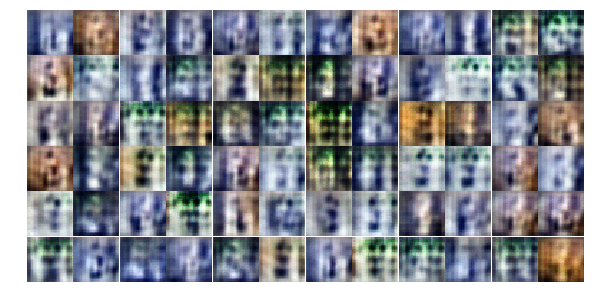

Epoch 2/25... Discriminator Loss: 1.3133... Generator Loss: 0.8396
Epoch 2/25... Discriminator Loss: 1.3865... Generator Loss: 1.0053
Epoch 2/25... Discriminator Loss: 1.2580... Generator Loss: 0.6778
Epoch 2/25... Discriminator Loss: 1.0889... Generator Loss: 0.9888
Epoch 3/25... Discriminator Loss: 0.9022... Generator Loss: 1.1195
Epoch 3/25... Discriminator Loss: 1.2487... Generator Loss: 0.9826
Epoch 3/25... Discriminator Loss: 1.1764... Generator Loss: 0.8291
Epoch 3/25... Discriminator Loss: 1.0762... Generator Loss: 0.8400
Epoch 3/25... Discriminator Loss: 1.1702... Generator Loss: 0.8899
Epoch 3/25... Discriminator Loss: 1.3555... Generator Loss: 0.7755


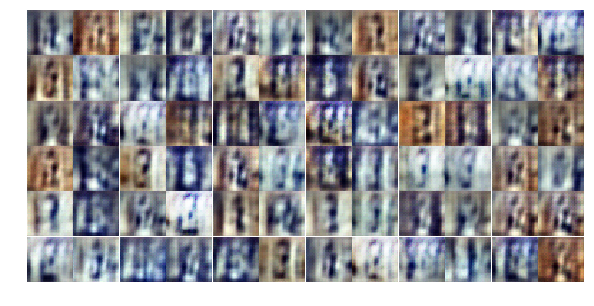

Epoch 3/25... Discriminator Loss: 1.1283... Generator Loss: 0.8293
Epoch 3/25... Discriminator Loss: 1.3079... Generator Loss: 0.7547
Epoch 3/25... Discriminator Loss: 1.0644... Generator Loss: 0.9462
Epoch 3/25... Discriminator Loss: 1.2063... Generator Loss: 0.7426
Epoch 3/25... Discriminator Loss: 1.0498... Generator Loss: 0.9047
Epoch 3/25... Discriminator Loss: 1.2754... Generator Loss: 0.8442
Epoch 3/25... Discriminator Loss: 1.3266... Generator Loss: 1.0218
Epoch 3/25... Discriminator Loss: 1.2592... Generator Loss: 0.6951
Epoch 3/25... Discriminator Loss: 1.0374... Generator Loss: 1.1771
Epoch 3/25... Discriminator Loss: 1.0711... Generator Loss: 0.9883


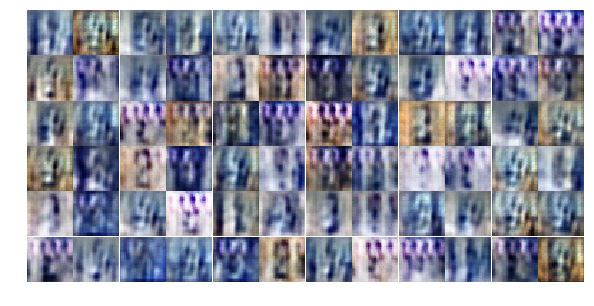

Epoch 3/25... Discriminator Loss: 1.1708... Generator Loss: 0.9922
Epoch 3/25... Discriminator Loss: 0.9918... Generator Loss: 1.0040
Epoch 3/25... Discriminator Loss: 1.0984... Generator Loss: 0.8465
Epoch 3/25... Discriminator Loss: 1.1638... Generator Loss: 0.9027
Epoch 3/25... Discriminator Loss: 1.2559... Generator Loss: 0.7959
Epoch 3/25... Discriminator Loss: 1.2943... Generator Loss: 0.7208
Epoch 3/25... Discriminator Loss: 1.3053... Generator Loss: 0.6562
Epoch 3/25... Discriminator Loss: 1.3092... Generator Loss: 0.8432
Epoch 3/25... Discriminator Loss: 1.2687... Generator Loss: 0.7888
Epoch 3/25... Discriminator Loss: 1.2341... Generator Loss: 0.9029


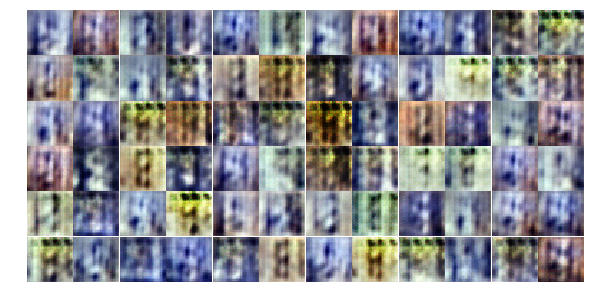

Epoch 3/25... Discriminator Loss: 1.2347... Generator Loss: 0.8287
Epoch 3/25... Discriminator Loss: 1.3110... Generator Loss: 0.7638
Epoch 3/25... Discriminator Loss: 1.3101... Generator Loss: 0.7200
Epoch 3/25... Discriminator Loss: 1.5237... Generator Loss: 0.4593
Epoch 3/25... Discriminator Loss: 1.1902... Generator Loss: 0.8221
Epoch 3/25... Discriminator Loss: 1.1810... Generator Loss: 0.9655
Epoch 3/25... Discriminator Loss: 1.2381... Generator Loss: 0.9565
Epoch 3/25... Discriminator Loss: 1.3227... Generator Loss: 0.7923
Epoch 3/25... Discriminator Loss: 1.3652... Generator Loss: 0.7992
Epoch 3/25... Discriminator Loss: 1.2289... Generator Loss: 0.7094


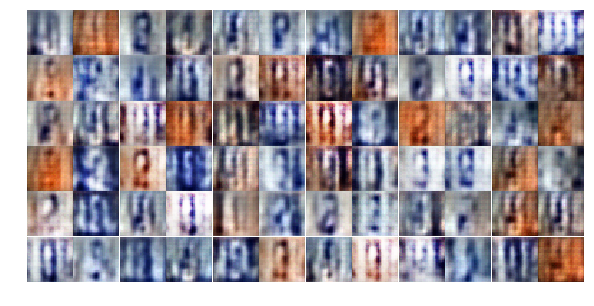

Epoch 3/25... Discriminator Loss: 1.2370... Generator Loss: 0.8223
Epoch 3/25... Discriminator Loss: 1.1242... Generator Loss: 0.8770
Epoch 3/25... Discriminator Loss: 1.0331... Generator Loss: 1.1010
Epoch 3/25... Discriminator Loss: 1.2374... Generator Loss: 0.7586
Epoch 3/25... Discriminator Loss: 1.0732... Generator Loss: 0.9530
Epoch 3/25... Discriminator Loss: 1.4421... Generator Loss: 0.6237
Epoch 3/25... Discriminator Loss: 1.2683... Generator Loss: 0.8357
Epoch 3/25... Discriminator Loss: 1.1038... Generator Loss: 1.0540
Epoch 3/25... Discriminator Loss: 1.1493... Generator Loss: 1.3435
Epoch 3/25... Discriminator Loss: 1.3952... Generator Loss: 0.7174


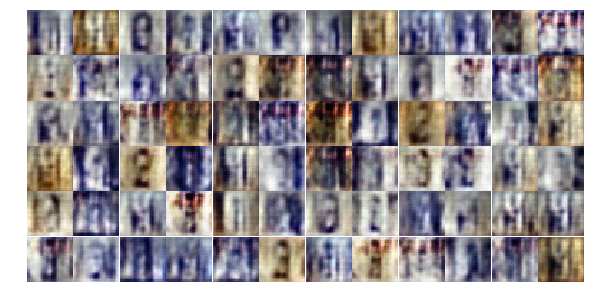

Epoch 3/25... Discriminator Loss: 1.0390... Generator Loss: 0.9444
Epoch 3/25... Discriminator Loss: 1.3115... Generator Loss: 0.7725
Epoch 3/25... Discriminator Loss: 1.3633... Generator Loss: 0.7310
Epoch 3/25... Discriminator Loss: 1.0815... Generator Loss: 0.9833
Epoch 3/25... Discriminator Loss: 1.1150... Generator Loss: 1.0301
Epoch 3/25... Discriminator Loss: 1.1081... Generator Loss: 0.8926
Epoch 3/25... Discriminator Loss: 1.3401... Generator Loss: 0.7665
Epoch 3/25... Discriminator Loss: 1.0746... Generator Loss: 0.9879
Epoch 3/25... Discriminator Loss: 1.2948... Generator Loss: 0.7741
Epoch 3/25... Discriminator Loss: 1.3688... Generator Loss: 0.7753


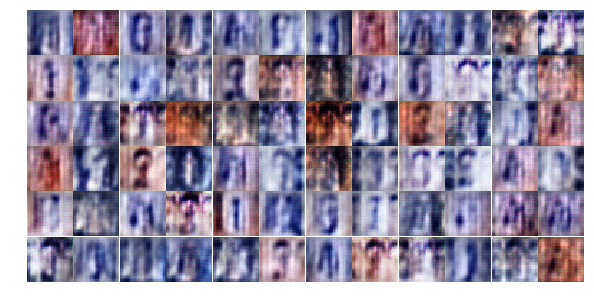

Epoch 3/25... Discriminator Loss: 1.5154... Generator Loss: 0.5418
Epoch 4/25... Discriminator Loss: 1.7135... Generator Loss: 0.4560
Epoch 4/25... Discriminator Loss: 1.0994... Generator Loss: 1.0494
Epoch 4/25... Discriminator Loss: 1.1795... Generator Loss: 0.7728
Epoch 4/25... Discriminator Loss: 1.2150... Generator Loss: 0.9044
Epoch 4/25... Discriminator Loss: 1.4981... Generator Loss: 0.7018
Epoch 4/25... Discriminator Loss: 1.2308... Generator Loss: 0.7785
Epoch 4/25... Discriminator Loss: 1.2504... Generator Loss: 0.7465
Epoch 4/25... Discriminator Loss: 1.1733... Generator Loss: 0.8230
Epoch 4/25... Discriminator Loss: 1.2250... Generator Loss: 0.7521


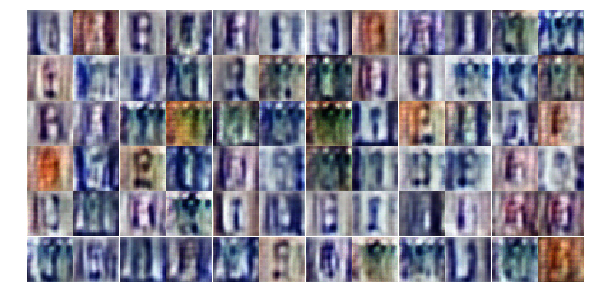

Epoch 4/25... Discriminator Loss: 1.1782... Generator Loss: 0.7932
Epoch 4/25... Discriminator Loss: 1.0250... Generator Loss: 0.9720
Epoch 4/25... Discriminator Loss: 1.4779... Generator Loss: 0.5527
Epoch 4/25... Discriminator Loss: 1.1303... Generator Loss: 1.1292
Epoch 4/25... Discriminator Loss: 1.1753... Generator Loss: 0.7888
Epoch 4/25... Discriminator Loss: 1.1359... Generator Loss: 0.7723
Epoch 4/25... Discriminator Loss: 1.2328... Generator Loss: 0.8205
Epoch 4/25... Discriminator Loss: 0.9573... Generator Loss: 1.3489
Epoch 4/25... Discriminator Loss: 1.4421... Generator Loss: 0.6507
Epoch 4/25... Discriminator Loss: 1.0565... Generator Loss: 0.9569


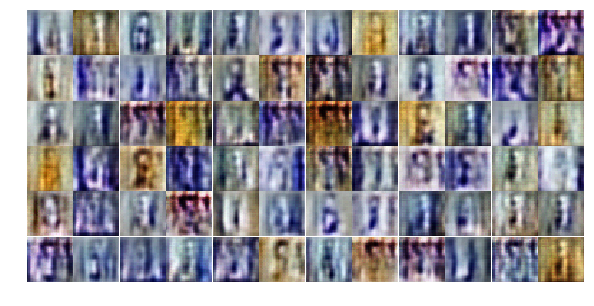

Epoch 4/25... Discriminator Loss: 1.3942... Generator Loss: 0.8649
Epoch 4/25... Discriminator Loss: 1.2306... Generator Loss: 0.9929
Epoch 4/25... Discriminator Loss: 1.4016... Generator Loss: 0.6035
Epoch 4/25... Discriminator Loss: 1.0890... Generator Loss: 0.9650
Epoch 4/25... Discriminator Loss: 1.0830... Generator Loss: 0.8630
Epoch 4/25... Discriminator Loss: 1.3845... Generator Loss: 0.8457
Epoch 4/25... Discriminator Loss: 1.4545... Generator Loss: 0.5008
Epoch 4/25... Discriminator Loss: 1.1298... Generator Loss: 0.8403
Epoch 4/25... Discriminator Loss: 1.1034... Generator Loss: 1.0136
Epoch 4/25... Discriminator Loss: 1.2703... Generator Loss: 0.7916


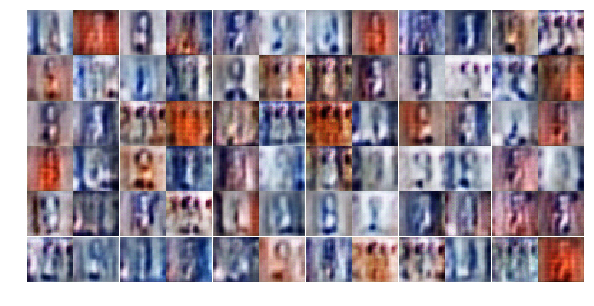

Epoch 4/25... Discriminator Loss: 1.1891... Generator Loss: 0.9309
Epoch 4/25... Discriminator Loss: 1.2208... Generator Loss: 1.0115
Epoch 4/25... Discriminator Loss: 1.1473... Generator Loss: 0.9093
Epoch 4/25... Discriminator Loss: 1.0930... Generator Loss: 0.9405
Epoch 4/25... Discriminator Loss: 1.1424... Generator Loss: 0.9724
Epoch 4/25... Discriminator Loss: 1.3562... Generator Loss: 0.9359
Epoch 4/25... Discriminator Loss: 1.4511... Generator Loss: 0.4376
Epoch 4/25... Discriminator Loss: 1.4955... Generator Loss: 0.5543
Epoch 4/25... Discriminator Loss: 1.2655... Generator Loss: 0.6746
Epoch 4/25... Discriminator Loss: 1.0514... Generator Loss: 0.8106


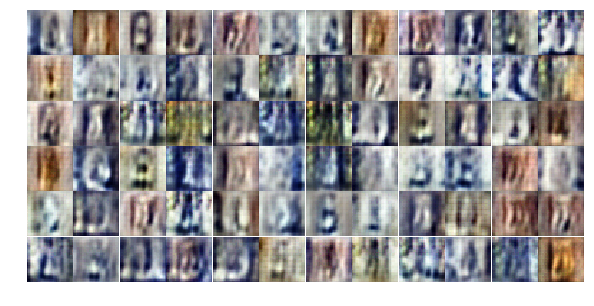

Epoch 4/25... Discriminator Loss: 1.2432... Generator Loss: 0.7243
Epoch 4/25... Discriminator Loss: 1.2257... Generator Loss: 0.9012
Epoch 4/25... Discriminator Loss: 1.3781... Generator Loss: 0.7332
Epoch 4/25... Discriminator Loss: 1.3075... Generator Loss: 0.7308
Epoch 4/25... Discriminator Loss: 1.1537... Generator Loss: 0.8590
Epoch 4/25... Discriminator Loss: 1.2121... Generator Loss: 0.7773
Epoch 4/25... Discriminator Loss: 1.3176... Generator Loss: 0.7592
Epoch 4/25... Discriminator Loss: 1.2210... Generator Loss: 0.8283
Epoch 4/25... Discriminator Loss: 1.2897... Generator Loss: 0.8089
Epoch 4/25... Discriminator Loss: 1.2046... Generator Loss: 0.9609


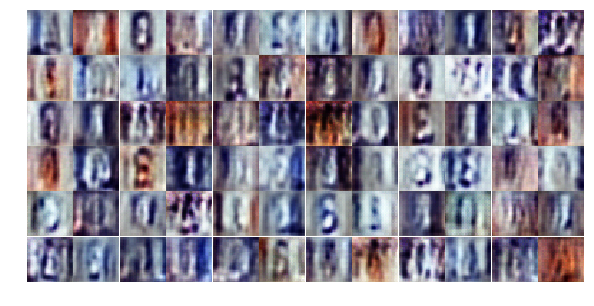

Epoch 4/25... Discriminator Loss: 1.3331... Generator Loss: 0.7023
Epoch 4/25... Discriminator Loss: 1.1188... Generator Loss: 0.9751
Epoch 4/25... Discriminator Loss: 1.1721... Generator Loss: 0.9691
Epoch 4/25... Discriminator Loss: 1.0048... Generator Loss: 0.9442
Epoch 4/25... Discriminator Loss: 1.1660... Generator Loss: 0.9293
Epoch 4/25... Discriminator Loss: 1.1498... Generator Loss: 0.8695
Epoch 4/25... Discriminator Loss: 1.2354... Generator Loss: 0.7625
Epoch 4/25... Discriminator Loss: 1.2105... Generator Loss: 0.8609
Epoch 4/25... Discriminator Loss: 1.2108... Generator Loss: 0.9532
Epoch 5/25... Discriminator Loss: 1.5406... Generator Loss: 0.6762


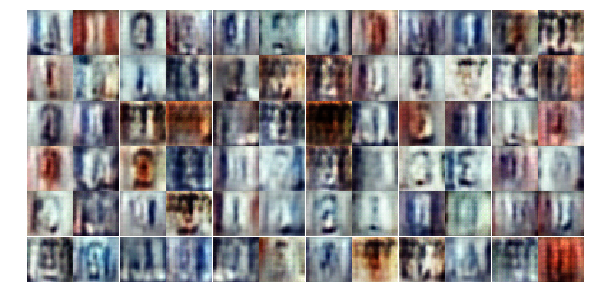

Epoch 5/25... Discriminator Loss: 1.4037... Generator Loss: 0.7603
Epoch 5/25... Discriminator Loss: 1.3000... Generator Loss: 0.6945
Epoch 5/25... Discriminator Loss: 1.3299... Generator Loss: 0.9367
Epoch 5/25... Discriminator Loss: 1.2244... Generator Loss: 0.6948
Epoch 5/25... Discriminator Loss: 1.0749... Generator Loss: 1.0043
Epoch 5/25... Discriminator Loss: 1.1604... Generator Loss: 0.8801
Epoch 5/25... Discriminator Loss: 1.2077... Generator Loss: 0.7997
Epoch 5/25... Discriminator Loss: 1.2666... Generator Loss: 0.7801
Epoch 5/25... Discriminator Loss: 1.3825... Generator Loss: 0.7745
Epoch 5/25... Discriminator Loss: 1.4134... Generator Loss: 0.6691


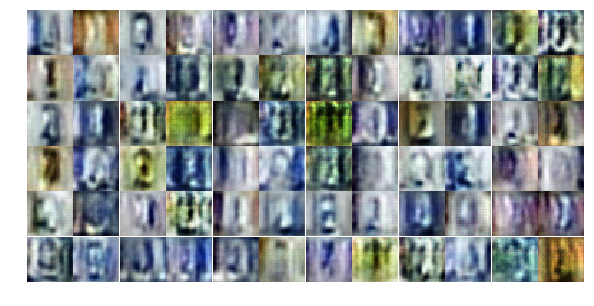

Epoch 5/25... Discriminator Loss: 1.3755... Generator Loss: 0.6201
Epoch 5/25... Discriminator Loss: 1.1384... Generator Loss: 1.0411
Epoch 5/25... Discriminator Loss: 1.2121... Generator Loss: 0.7454
Epoch 5/25... Discriminator Loss: 1.4017... Generator Loss: 0.6870
Epoch 5/25... Discriminator Loss: 1.0747... Generator Loss: 1.0300
Epoch 5/25... Discriminator Loss: 1.2315... Generator Loss: 0.7950
Epoch 5/25... Discriminator Loss: 1.3148... Generator Loss: 0.7900
Epoch 5/25... Discriminator Loss: 1.1932... Generator Loss: 0.8412
Epoch 5/25... Discriminator Loss: 1.4868... Generator Loss: 0.4861
Epoch 5/25... Discriminator Loss: 1.3131... Generator Loss: 0.8797


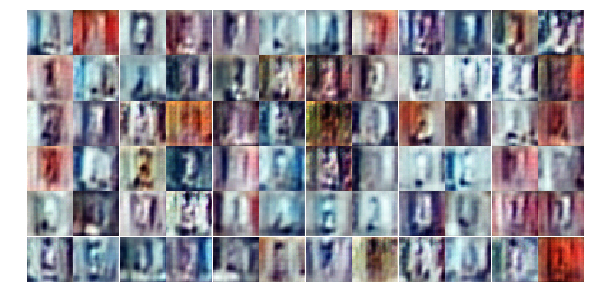

Epoch 5/25... Discriminator Loss: 1.1534... Generator Loss: 0.9459
Epoch 5/25... Discriminator Loss: 1.2388... Generator Loss: 0.7816
Epoch 5/25... Discriminator Loss: 1.3341... Generator Loss: 0.7830
Epoch 5/25... Discriminator Loss: 1.0950... Generator Loss: 0.9159
Epoch 5/25... Discriminator Loss: 1.3310... Generator Loss: 0.7094
Epoch 5/25... Discriminator Loss: 1.1239... Generator Loss: 0.9286
Epoch 5/25... Discriminator Loss: 1.2729... Generator Loss: 0.7566
Epoch 5/25... Discriminator Loss: 1.1821... Generator Loss: 0.9594
Epoch 5/25... Discriminator Loss: 1.1867... Generator Loss: 0.8207
Epoch 5/25... Discriminator Loss: 1.1589... Generator Loss: 0.7861


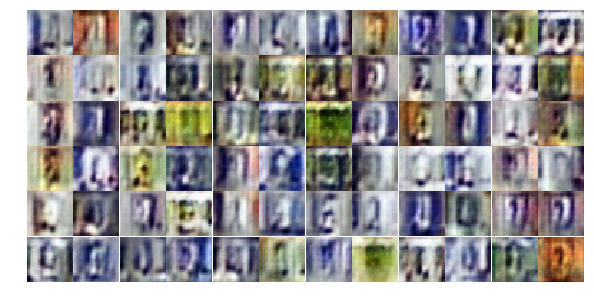

Epoch 5/25... Discriminator Loss: 1.2342... Generator Loss: 0.8666
Epoch 5/25... Discriminator Loss: 1.2640... Generator Loss: 0.7902
Epoch 5/25... Discriminator Loss: 1.2273... Generator Loss: 0.8391
Epoch 5/25... Discriminator Loss: 1.1532... Generator Loss: 0.8963
Epoch 5/25... Discriminator Loss: 1.4429... Generator Loss: 0.6072
Epoch 5/25... Discriminator Loss: 1.0057... Generator Loss: 1.1723
Epoch 5/25... Discriminator Loss: 1.0802... Generator Loss: 0.9773
Epoch 5/25... Discriminator Loss: 1.1809... Generator Loss: 1.0056
Epoch 5/25... Discriminator Loss: 1.2569... Generator Loss: 0.7043
Epoch 5/25... Discriminator Loss: 1.2085... Generator Loss: 1.0232


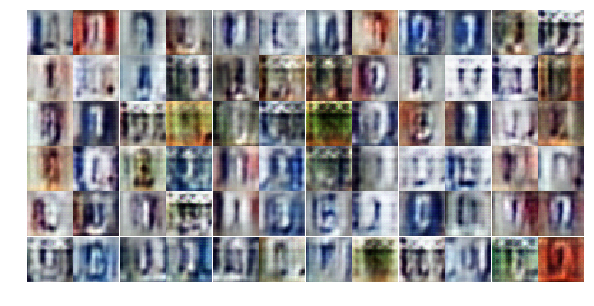

Epoch 5/25... Discriminator Loss: 1.3389... Generator Loss: 0.7595
Epoch 5/25... Discriminator Loss: 0.9524... Generator Loss: 1.0432
Epoch 5/25... Discriminator Loss: 1.1506... Generator Loss: 0.7712
Epoch 5/25... Discriminator Loss: 1.3048... Generator Loss: 0.7477
Epoch 5/25... Discriminator Loss: 1.3170... Generator Loss: 0.5440
Epoch 5/25... Discriminator Loss: 1.4532... Generator Loss: 0.5461
Epoch 5/25... Discriminator Loss: 1.2737... Generator Loss: 0.7915
Epoch 5/25... Discriminator Loss: 1.2076... Generator Loss: 0.7662
Epoch 5/25... Discriminator Loss: 1.3564... Generator Loss: 0.6315
Epoch 5/25... Discriminator Loss: 1.2736... Generator Loss: 0.8626


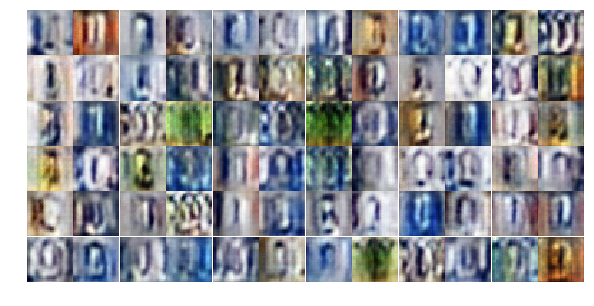

Epoch 5/25... Discriminator Loss: 1.0700... Generator Loss: 0.8930
Epoch 5/25... Discriminator Loss: 1.0817... Generator Loss: 1.1748
Epoch 5/25... Discriminator Loss: 0.9642... Generator Loss: 0.9970
Epoch 5/25... Discriminator Loss: 1.3675... Generator Loss: 0.6450
Epoch 5/25... Discriminator Loss: 1.6941... Generator Loss: 0.4651
Epoch 5/25... Discriminator Loss: 1.1031... Generator Loss: 0.9329
Epoch 6/25... Discriminator Loss: 1.3919... Generator Loss: 0.7677
Epoch 6/25... Discriminator Loss: 1.1501... Generator Loss: 0.8557
Epoch 6/25... Discriminator Loss: 1.0480... Generator Loss: 1.2460
Epoch 6/25... Discriminator Loss: 1.2172... Generator Loss: 0.8164


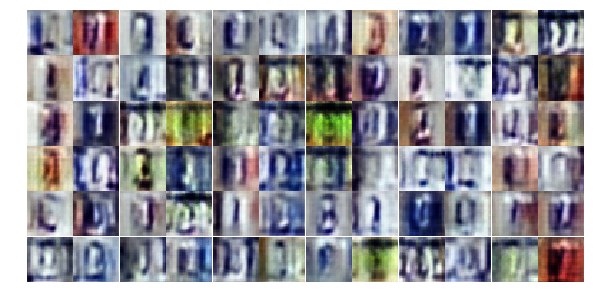

Epoch 6/25... Discriminator Loss: 1.0715... Generator Loss: 1.2232
Epoch 6/25... Discriminator Loss: 1.1935... Generator Loss: 0.7741
Epoch 6/25... Discriminator Loss: 1.2018... Generator Loss: 0.8502
Epoch 6/25... Discriminator Loss: 1.0275... Generator Loss: 1.0214
Epoch 6/25... Discriminator Loss: 1.1072... Generator Loss: 0.8669
Epoch 6/25... Discriminator Loss: 1.1324... Generator Loss: 0.9067
Epoch 6/25... Discriminator Loss: 0.9391... Generator Loss: 1.2667
Epoch 6/25... Discriminator Loss: 1.1353... Generator Loss: 0.9559
Epoch 6/25... Discriminator Loss: 0.8041... Generator Loss: 1.6889
Epoch 6/25... Discriminator Loss: 0.9039... Generator Loss: 1.1828


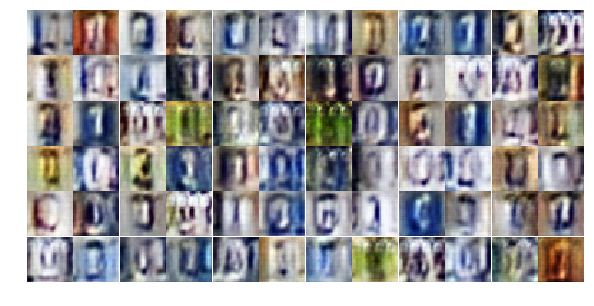

Epoch 6/25... Discriminator Loss: 0.8717... Generator Loss: 1.4106
Epoch 6/25... Discriminator Loss: 0.9453... Generator Loss: 1.1201
Epoch 6/25... Discriminator Loss: 1.0929... Generator Loss: 0.9570
Epoch 6/25... Discriminator Loss: 1.0911... Generator Loss: 0.8928
Epoch 6/25... Discriminator Loss: 1.3274... Generator Loss: 0.5952
Epoch 6/25... Discriminator Loss: 1.0654... Generator Loss: 1.5546
Epoch 6/25... Discriminator Loss: 0.9495... Generator Loss: 1.3961
Epoch 6/25... Discriminator Loss: 1.1512... Generator Loss: 0.7755
Epoch 6/25... Discriminator Loss: 1.1186... Generator Loss: 1.1415
Epoch 6/25... Discriminator Loss: 1.1970... Generator Loss: 0.9638


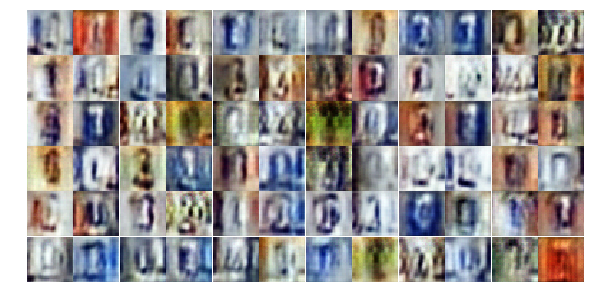

Epoch 6/25... Discriminator Loss: 0.9516... Generator Loss: 1.0392
Epoch 6/25... Discriminator Loss: 1.2816... Generator Loss: 0.6352
Epoch 6/25... Discriminator Loss: 1.2238... Generator Loss: 0.8603
Epoch 6/25... Discriminator Loss: 1.2196... Generator Loss: 0.6984
Epoch 6/25... Discriminator Loss: 0.7929... Generator Loss: 1.5491
Epoch 6/25... Discriminator Loss: 1.2895... Generator Loss: 0.8216
Epoch 6/25... Discriminator Loss: 0.9919... Generator Loss: 0.8217
Epoch 6/25... Discriminator Loss: 0.9203... Generator Loss: 1.0913
Epoch 6/25... Discriminator Loss: 0.9698... Generator Loss: 0.8620
Epoch 6/25... Discriminator Loss: 1.1402... Generator Loss: 0.9346


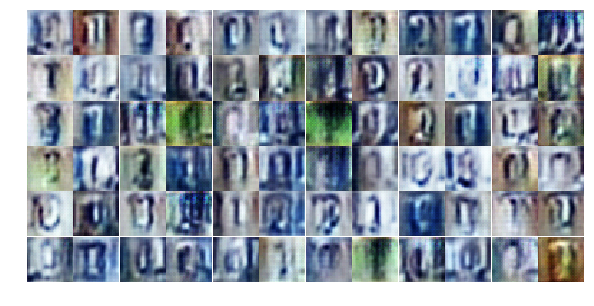

Epoch 6/25... Discriminator Loss: 1.0685... Generator Loss: 0.9941
Epoch 6/25... Discriminator Loss: 1.0785... Generator Loss: 0.8400
Epoch 6/25... Discriminator Loss: 1.0804... Generator Loss: 1.2751
Epoch 6/25... Discriminator Loss: 1.1356... Generator Loss: 0.9044
Epoch 6/25... Discriminator Loss: 0.9942... Generator Loss: 0.7671
Epoch 6/25... Discriminator Loss: 1.1776... Generator Loss: 0.7864
Epoch 6/25... Discriminator Loss: 1.0094... Generator Loss: 1.0345
Epoch 6/25... Discriminator Loss: 1.1518... Generator Loss: 0.8737
Epoch 6/25... Discriminator Loss: 1.0874... Generator Loss: 1.4431
Epoch 6/25... Discriminator Loss: 1.0607... Generator Loss: 1.2671


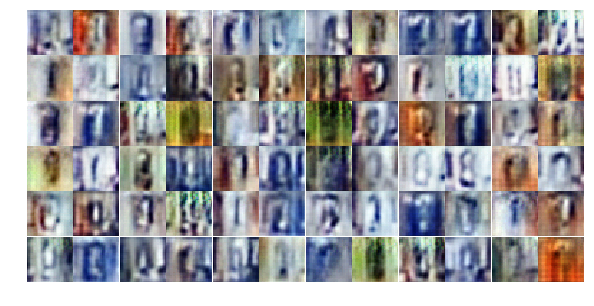

Epoch 6/25... Discriminator Loss: 1.1717... Generator Loss: 0.6634
Epoch 6/25... Discriminator Loss: 1.1629... Generator Loss: 0.7612
Epoch 6/25... Discriminator Loss: 1.2536... Generator Loss: 0.7143
Epoch 6/25... Discriminator Loss: 1.3014... Generator Loss: 0.5817
Epoch 6/25... Discriminator Loss: 0.7468... Generator Loss: 1.1877
Epoch 6/25... Discriminator Loss: 0.8842... Generator Loss: 1.2950
Epoch 6/25... Discriminator Loss: 0.9435... Generator Loss: 1.5676
Epoch 6/25... Discriminator Loss: 1.1568... Generator Loss: 0.6161
Epoch 6/25... Discriminator Loss: 1.1083... Generator Loss: 0.8702
Epoch 6/25... Discriminator Loss: 1.4182... Generator Loss: 0.6501


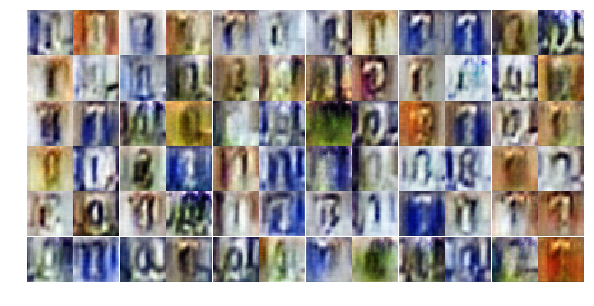

Epoch 6/25... Discriminator Loss: 1.2398... Generator Loss: 0.6573
Epoch 6/25... Discriminator Loss: 0.8854... Generator Loss: 1.0302
Epoch 6/25... Discriminator Loss: 1.0659... Generator Loss: 0.9922
Epoch 7/25... Discriminator Loss: 1.4023... Generator Loss: 0.4834
Epoch 7/25... Discriminator Loss: 1.0805... Generator Loss: 1.0661
Epoch 7/25... Discriminator Loss: 1.2244... Generator Loss: 0.6260
Epoch 7/25... Discriminator Loss: 1.1960... Generator Loss: 0.8532
Epoch 7/25... Discriminator Loss: 1.0686... Generator Loss: 1.0393
Epoch 7/25... Discriminator Loss: 1.2593... Generator Loss: 0.7561
Epoch 7/25... Discriminator Loss: 1.2168... Generator Loss: 0.7909


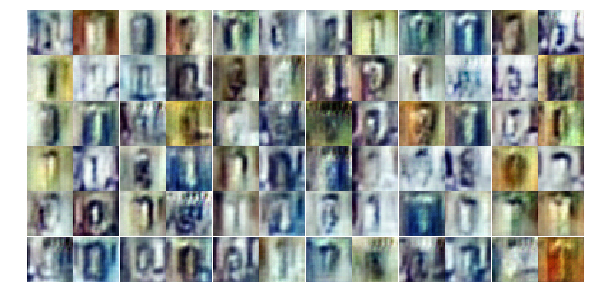

Epoch 7/25... Discriminator Loss: 1.1433... Generator Loss: 0.7965
Epoch 7/25... Discriminator Loss: 1.2297... Generator Loss: 0.6732
Epoch 7/25... Discriminator Loss: 0.9971... Generator Loss: 1.3426
Epoch 7/25... Discriminator Loss: 1.0380... Generator Loss: 1.1227
Epoch 7/25... Discriminator Loss: 1.4117... Generator Loss: 0.5833
Epoch 7/25... Discriminator Loss: 0.9666... Generator Loss: 1.2148
Epoch 7/25... Discriminator Loss: 0.9985... Generator Loss: 1.0997
Epoch 7/25... Discriminator Loss: 1.0830... Generator Loss: 0.9896
Epoch 7/25... Discriminator Loss: 1.2655... Generator Loss: 0.8270
Epoch 7/25... Discriminator Loss: 0.7233... Generator Loss: 1.8750


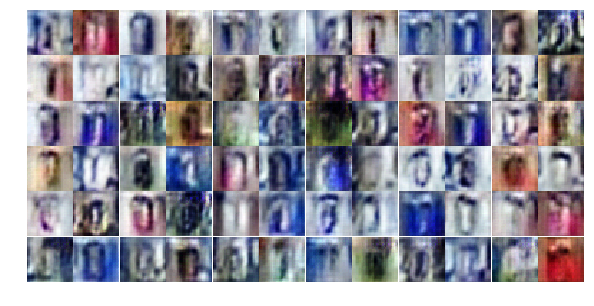

Epoch 7/25... Discriminator Loss: 1.0573... Generator Loss: 1.1343
Epoch 7/25... Discriminator Loss: 1.0722... Generator Loss: 0.8049
Epoch 7/25... Discriminator Loss: 0.8397... Generator Loss: 1.5217
Epoch 7/25... Discriminator Loss: 1.1574... Generator Loss: 0.9815
Epoch 7/25... Discriminator Loss: 1.1551... Generator Loss: 0.8678
Epoch 7/25... Discriminator Loss: 0.9352... Generator Loss: 0.9890
Epoch 7/25... Discriminator Loss: 1.1780... Generator Loss: 0.8693
Epoch 7/25... Discriminator Loss: 1.3801... Generator Loss: 0.5028
Epoch 7/25... Discriminator Loss: 1.1379... Generator Loss: 1.0913
Epoch 7/25... Discriminator Loss: 1.2422... Generator Loss: 0.7031


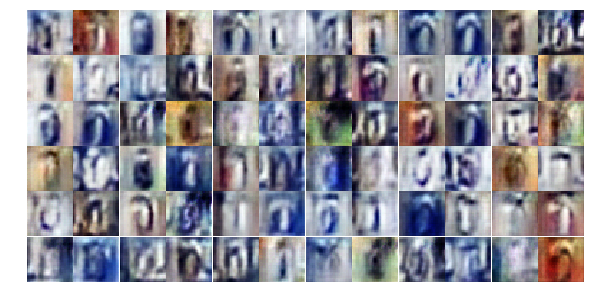

Epoch 7/25... Discriminator Loss: 1.0979... Generator Loss: 0.8606
Epoch 7/25... Discriminator Loss: 1.1773... Generator Loss: 0.8696
Epoch 7/25... Discriminator Loss: 1.2929... Generator Loss: 0.7298
Epoch 7/25... Discriminator Loss: 1.0908... Generator Loss: 1.0839
Epoch 7/25... Discriminator Loss: 1.1380... Generator Loss: 0.9846
Epoch 7/25... Discriminator Loss: 1.4099... Generator Loss: 0.5533
Epoch 7/25... Discriminator Loss: 1.1403... Generator Loss: 0.8289
Epoch 7/25... Discriminator Loss: 1.3029... Generator Loss: 0.9415
Epoch 7/25... Discriminator Loss: 1.2089... Generator Loss: 0.9653
Epoch 7/25... Discriminator Loss: 1.3917... Generator Loss: 0.5942


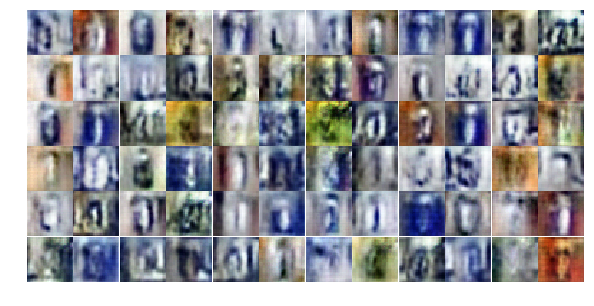

Epoch 7/25... Discriminator Loss: 1.4972... Generator Loss: 0.4742
Epoch 7/25... Discriminator Loss: 1.1170... Generator Loss: 1.2957
Epoch 7/25... Discriminator Loss: 1.1397... Generator Loss: 0.7214
Epoch 7/25... Discriminator Loss: 0.9893... Generator Loss: 1.0295
Epoch 7/25... Discriminator Loss: 1.4211... Generator Loss: 0.7012
Epoch 7/25... Discriminator Loss: 1.1622... Generator Loss: 0.9218
Epoch 7/25... Discriminator Loss: 1.2376... Generator Loss: 0.8263
Epoch 7/25... Discriminator Loss: 1.1482... Generator Loss: 0.9909
Epoch 7/25... Discriminator Loss: 0.8719... Generator Loss: 1.2820
Epoch 7/25... Discriminator Loss: 1.1622... Generator Loss: 0.8320


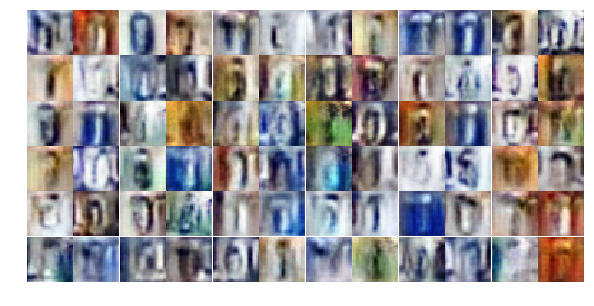

Epoch 7/25... Discriminator Loss: 1.2387... Generator Loss: 0.7629
Epoch 7/25... Discriminator Loss: 1.2902... Generator Loss: 0.7592
Epoch 7/25... Discriminator Loss: 1.1678... Generator Loss: 0.9073
Epoch 7/25... Discriminator Loss: 1.0281... Generator Loss: 0.9080
Epoch 7/25... Discriminator Loss: 1.0171... Generator Loss: 1.2438
Epoch 7/25... Discriminator Loss: 1.1325... Generator Loss: 0.8865
Epoch 7/25... Discriminator Loss: 1.0036... Generator Loss: 0.8982
Epoch 7/25... Discriminator Loss: 1.1759... Generator Loss: 0.9733
Epoch 7/25... Discriminator Loss: 1.2775... Generator Loss: 0.8133
Epoch 7/25... Discriminator Loss: 1.0040... Generator Loss: 1.0603


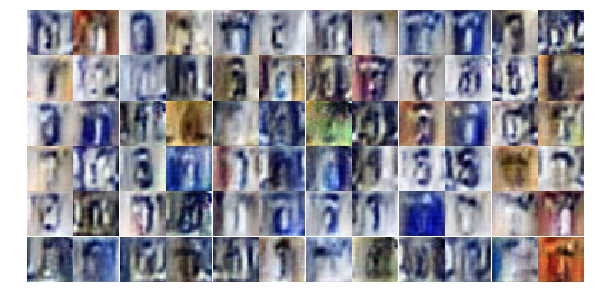

Epoch 7/25... Discriminator Loss: 1.0821... Generator Loss: 0.8931
Epoch 8/25... Discriminator Loss: 1.2109... Generator Loss: 0.7424
Epoch 8/25... Discriminator Loss: 1.3282... Generator Loss: 0.6392
Epoch 8/25... Discriminator Loss: 1.2447... Generator Loss: 0.9490
Epoch 8/25... Discriminator Loss: 1.2397... Generator Loss: 0.8245
Epoch 8/25... Discriminator Loss: 1.1884... Generator Loss: 0.9321
Epoch 8/25... Discriminator Loss: 1.1486... Generator Loss: 0.8110
Epoch 8/25... Discriminator Loss: 1.1152... Generator Loss: 1.0766
Epoch 8/25... Discriminator Loss: 1.2553... Generator Loss: 0.7756
Epoch 8/25... Discriminator Loss: 1.1647... Generator Loss: 0.8014


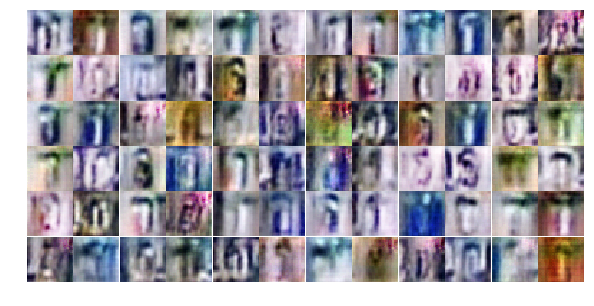

Epoch 8/25... Discriminator Loss: 0.9893... Generator Loss: 1.2128
Epoch 8/25... Discriminator Loss: 1.0012... Generator Loss: 0.9448
Epoch 8/25... Discriminator Loss: 1.3654... Generator Loss: 0.6341
Epoch 8/25... Discriminator Loss: 1.1600... Generator Loss: 1.0564
Epoch 8/25... Discriminator Loss: 1.2623... Generator Loss: 0.8167
Epoch 8/25... Discriminator Loss: 1.1961... Generator Loss: 0.8008
Epoch 8/25... Discriminator Loss: 1.3091... Generator Loss: 0.8500
Epoch 8/25... Discriminator Loss: 0.9812... Generator Loss: 1.1188
Epoch 8/25... Discriminator Loss: 1.0991... Generator Loss: 0.9779
Epoch 8/25... Discriminator Loss: 1.2925... Generator Loss: 0.6936


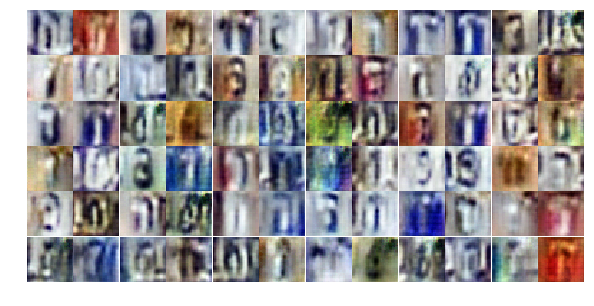

Epoch 8/25... Discriminator Loss: 1.1824... Generator Loss: 0.9010
Epoch 8/25... Discriminator Loss: 1.2537... Generator Loss: 0.8307
Epoch 8/25... Discriminator Loss: 1.1258... Generator Loss: 0.8504
Epoch 8/25... Discriminator Loss: 1.1864... Generator Loss: 0.9303
Epoch 8/25... Discriminator Loss: 1.2638... Generator Loss: 0.8156
Epoch 8/25... Discriminator Loss: 1.1596... Generator Loss: 0.8562
Epoch 8/25... Discriminator Loss: 1.3179... Generator Loss: 0.6629
Epoch 8/25... Discriminator Loss: 1.1805... Generator Loss: 0.9182
Epoch 8/25... Discriminator Loss: 1.2013... Generator Loss: 0.8604
Epoch 8/25... Discriminator Loss: 1.2179... Generator Loss: 0.8826


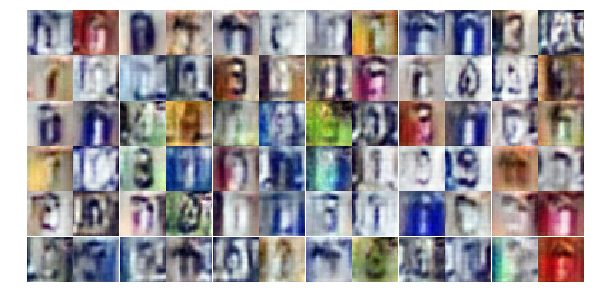

Epoch 8/25... Discriminator Loss: 1.2659... Generator Loss: 0.7202
Epoch 8/25... Discriminator Loss: 1.1832... Generator Loss: 0.8156
Epoch 8/25... Discriminator Loss: 1.1574... Generator Loss: 0.8889
Epoch 8/25... Discriminator Loss: 1.2027... Generator Loss: 0.7938
Epoch 8/25... Discriminator Loss: 1.0843... Generator Loss: 0.9042
Epoch 8/25... Discriminator Loss: 1.0537... Generator Loss: 1.1870
Epoch 8/25... Discriminator Loss: 1.2150... Generator Loss: 0.9851
Epoch 8/25... Discriminator Loss: 0.9899... Generator Loss: 1.0960
Epoch 8/25... Discriminator Loss: 1.1917... Generator Loss: 0.8127
Epoch 8/25... Discriminator Loss: 1.1964... Generator Loss: 0.8337


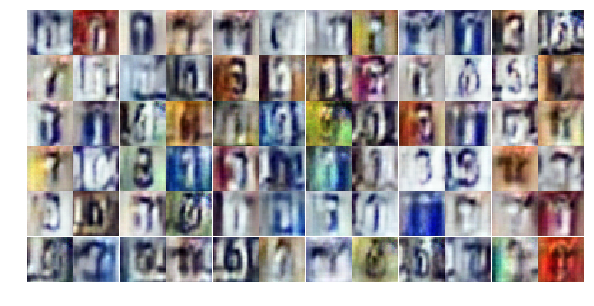

Epoch 8/25... Discriminator Loss: 1.2222... Generator Loss: 0.7091
Epoch 8/25... Discriminator Loss: 1.3415... Generator Loss: 0.7644
Epoch 8/25... Discriminator Loss: 1.0831... Generator Loss: 0.8312
Epoch 8/25... Discriminator Loss: 1.2712... Generator Loss: 0.7876
Epoch 8/25... Discriminator Loss: 1.3360... Generator Loss: 0.7871
Epoch 8/25... Discriminator Loss: 1.0627... Generator Loss: 0.9031
Epoch 8/25... Discriminator Loss: 1.3791... Generator Loss: 0.6244
Epoch 8/25... Discriminator Loss: 1.1936... Generator Loss: 0.7844
Epoch 8/25... Discriminator Loss: 1.2194... Generator Loss: 0.6667
Epoch 8/25... Discriminator Loss: 1.1683... Generator Loss: 0.8707


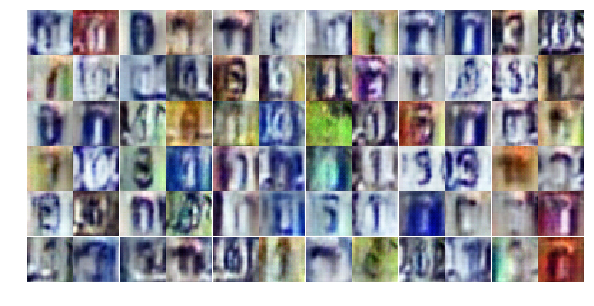

Epoch 8/25... Discriminator Loss: 1.1973... Generator Loss: 0.9024
Epoch 8/25... Discriminator Loss: 1.1801... Generator Loss: 0.8704
Epoch 8/25... Discriminator Loss: 1.2683... Generator Loss: 0.8009
Epoch 8/25... Discriminator Loss: 1.2313... Generator Loss: 0.7228
Epoch 8/25... Discriminator Loss: 1.2102... Generator Loss: 0.8607
Epoch 8/25... Discriminator Loss: 1.2809... Generator Loss: 0.8010
Epoch 8/25... Discriminator Loss: 1.1962... Generator Loss: 0.8626
Epoch 8/25... Discriminator Loss: 1.1272... Generator Loss: 0.8745
Epoch 9/25... Discriminator Loss: 1.1259... Generator Loss: 0.8598
Epoch 9/25... Discriminator Loss: 1.2443... Generator Loss: 0.8226


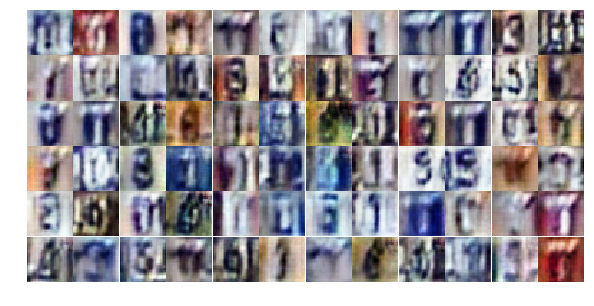

Epoch 9/25... Discriminator Loss: 1.2442... Generator Loss: 0.8456
Epoch 9/25... Discriminator Loss: 1.2527... Generator Loss: 0.8386
Epoch 9/25... Discriminator Loss: 1.2739... Generator Loss: 0.6999
Epoch 9/25... Discriminator Loss: 1.2802... Generator Loss: 0.8185
Epoch 9/25... Discriminator Loss: 1.2408... Generator Loss: 0.7868
Epoch 9/25... Discriminator Loss: 1.1208... Generator Loss: 1.0420
Epoch 9/25... Discriminator Loss: 1.2262... Generator Loss: 0.8199
Epoch 9/25... Discriminator Loss: 1.2209... Generator Loss: 0.8499
Epoch 9/25... Discriminator Loss: 1.3132... Generator Loss: 0.7240
Epoch 9/25... Discriminator Loss: 1.1822... Generator Loss: 0.9326


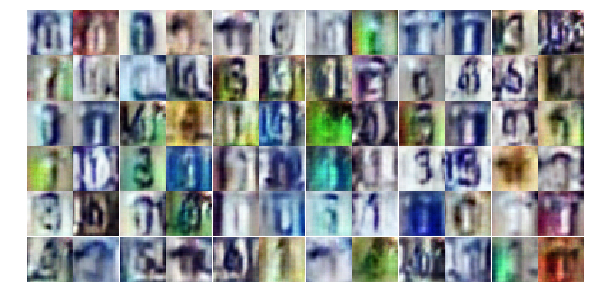

Epoch 9/25... Discriminator Loss: 1.2136... Generator Loss: 0.7715
Epoch 9/25... Discriminator Loss: 1.3348... Generator Loss: 0.7705
Epoch 9/25... Discriminator Loss: 1.2497... Generator Loss: 0.7158
Epoch 9/25... Discriminator Loss: 1.1039... Generator Loss: 0.9356
Epoch 9/25... Discriminator Loss: 1.1576... Generator Loss: 0.9272
Epoch 9/25... Discriminator Loss: 1.3315... Generator Loss: 0.6398
Epoch 9/25... Discriminator Loss: 1.2320... Generator Loss: 0.7631
Epoch 9/25... Discriminator Loss: 1.3773... Generator Loss: 0.6554
Epoch 9/25... Discriminator Loss: 1.2917... Generator Loss: 0.7541
Epoch 9/25... Discriminator Loss: 1.2607... Generator Loss: 0.7366


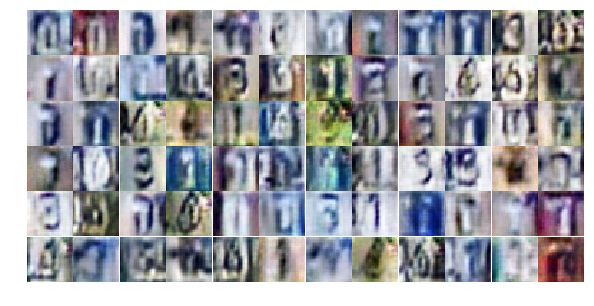

Epoch 9/25... Discriminator Loss: 1.2289... Generator Loss: 0.8756
Epoch 9/25... Discriminator Loss: 1.0090... Generator Loss: 0.9484
Epoch 9/25... Discriminator Loss: 1.2840... Generator Loss: 0.7988
Epoch 9/25... Discriminator Loss: 1.1552... Generator Loss: 1.2195
Epoch 9/25... Discriminator Loss: 1.0868... Generator Loss: 0.8316
Epoch 9/25... Discriminator Loss: 1.2999... Generator Loss: 0.8192
Epoch 9/25... Discriminator Loss: 1.3465... Generator Loss: 0.8896
Epoch 9/25... Discriminator Loss: 1.1902... Generator Loss: 0.8950
Epoch 9/25... Discriminator Loss: 1.2143... Generator Loss: 0.8297
Epoch 9/25... Discriminator Loss: 1.1247... Generator Loss: 0.8175


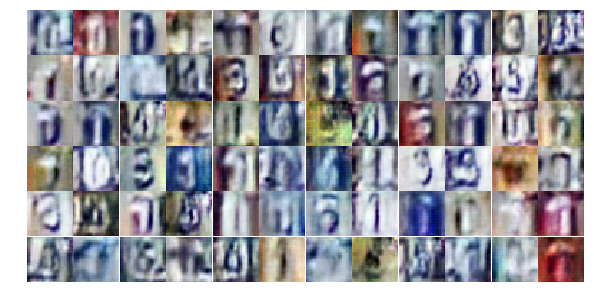

Epoch 9/25... Discriminator Loss: 1.1551... Generator Loss: 0.8842
Epoch 9/25... Discriminator Loss: 1.2448... Generator Loss: 0.7566
Epoch 9/25... Discriminator Loss: 1.0109... Generator Loss: 1.0132
Epoch 9/25... Discriminator Loss: 1.1326... Generator Loss: 0.9190
Epoch 9/25... Discriminator Loss: 1.1531... Generator Loss: 0.9666
Epoch 9/25... Discriminator Loss: 1.1350... Generator Loss: 0.8174
Epoch 9/25... Discriminator Loss: 1.2278... Generator Loss: 0.8239
Epoch 9/25... Discriminator Loss: 1.4406... Generator Loss: 0.7275
Epoch 9/25... Discriminator Loss: 1.1740... Generator Loss: 0.8131
Epoch 9/25... Discriminator Loss: 1.2574... Generator Loss: 0.8315


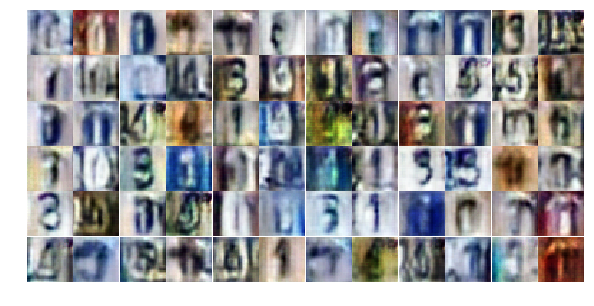

Epoch 9/25... Discriminator Loss: 1.2166... Generator Loss: 0.8024
Epoch 9/25... Discriminator Loss: 1.0659... Generator Loss: 0.9717
Epoch 9/25... Discriminator Loss: 1.1794... Generator Loss: 0.7600
Epoch 9/25... Discriminator Loss: 1.1752... Generator Loss: 0.8855
Epoch 9/25... Discriminator Loss: 1.1826... Generator Loss: 0.9411
Epoch 9/25... Discriminator Loss: 1.3291... Generator Loss: 0.8134
Epoch 9/25... Discriminator Loss: 1.0884... Generator Loss: 1.0336
Epoch 9/25... Discriminator Loss: 1.2956... Generator Loss: 0.7140
Epoch 9/25... Discriminator Loss: 1.1731... Generator Loss: 0.8972
Epoch 9/25... Discriminator Loss: 1.2734... Generator Loss: 0.7878


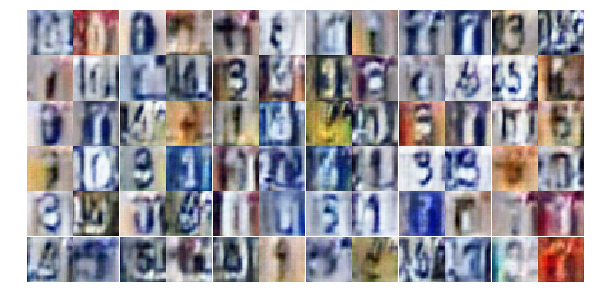

Epoch 9/25... Discriminator Loss: 1.2521... Generator Loss: 0.8721
Epoch 9/25... Discriminator Loss: 1.4018... Generator Loss: 0.7348
Epoch 9/25... Discriminator Loss: 1.1110... Generator Loss: 1.0427
Epoch 9/25... Discriminator Loss: 1.1592... Generator Loss: 0.8036
Epoch 9/25... Discriminator Loss: 1.3417... Generator Loss: 0.7537
Epoch 10/25... Discriminator Loss: 1.4437... Generator Loss: 0.6580
Epoch 10/25... Discriminator Loss: 1.1730... Generator Loss: 0.9456
Epoch 10/25... Discriminator Loss: 1.3017... Generator Loss: 0.7044
Epoch 10/25... Discriminator Loss: 1.2615... Generator Loss: 0.7912
Epoch 10/25... Discriminator Loss: 1.3156... Generator Loss: 0.7694


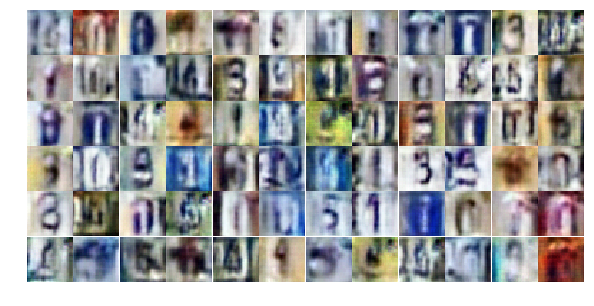

Epoch 10/25... Discriminator Loss: 1.2582... Generator Loss: 0.7698
Epoch 10/25... Discriminator Loss: 1.3047... Generator Loss: 0.7557
Epoch 10/25... Discriminator Loss: 1.2463... Generator Loss: 1.0184
Epoch 10/25... Discriminator Loss: 1.1571... Generator Loss: 0.9062
Epoch 10/25... Discriminator Loss: 1.2441... Generator Loss: 0.8767
Epoch 10/25... Discriminator Loss: 1.2723... Generator Loss: 0.7740
Epoch 10/25... Discriminator Loss: 1.2579... Generator Loss: 0.8781
Epoch 10/25... Discriminator Loss: 1.2489... Generator Loss: 0.7347
Epoch 10/25... Discriminator Loss: 1.2235... Generator Loss: 0.7672
Epoch 10/25... Discriminator Loss: 1.2997... Generator Loss: 0.8361


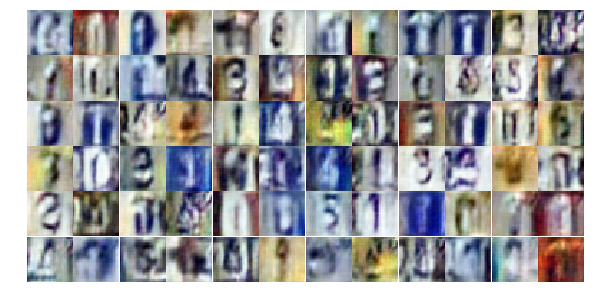

Epoch 10/25... Discriminator Loss: 1.1893... Generator Loss: 0.8768
Epoch 10/25... Discriminator Loss: 1.3013... Generator Loss: 0.6729
Epoch 10/25... Discriminator Loss: 1.2804... Generator Loss: 0.6340
Epoch 10/25... Discriminator Loss: 1.2719... Generator Loss: 0.7176
Epoch 10/25... Discriminator Loss: 1.1505... Generator Loss: 0.8315
Epoch 10/25... Discriminator Loss: 1.2468... Generator Loss: 0.8143
Epoch 10/25... Discriminator Loss: 1.1775... Generator Loss: 0.7590
Epoch 10/25... Discriminator Loss: 1.1136... Generator Loss: 0.8762
Epoch 10/25... Discriminator Loss: 1.3552... Generator Loss: 0.7174
Epoch 10/25... Discriminator Loss: 1.1186... Generator Loss: 1.1907


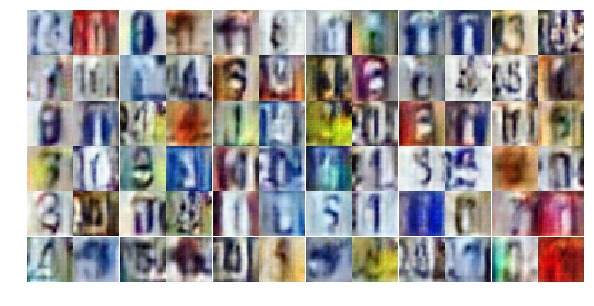

Epoch 10/25... Discriminator Loss: 1.2908... Generator Loss: 1.0130
Epoch 10/25... Discriminator Loss: 1.3594... Generator Loss: 0.6950
Epoch 10/25... Discriminator Loss: 1.2778... Generator Loss: 0.7679
Epoch 10/25... Discriminator Loss: 1.1544... Generator Loss: 0.7636
Epoch 10/25... Discriminator Loss: 1.2658... Generator Loss: 0.6616
Epoch 10/25... Discriminator Loss: 1.3104... Generator Loss: 0.7915
Epoch 10/25... Discriminator Loss: 1.1844... Generator Loss: 0.8243
Epoch 10/25... Discriminator Loss: 1.0724... Generator Loss: 1.1257
Epoch 10/25... Discriminator Loss: 1.2586... Generator Loss: 0.7568
Epoch 10/25... Discriminator Loss: 1.1709... Generator Loss: 0.8129


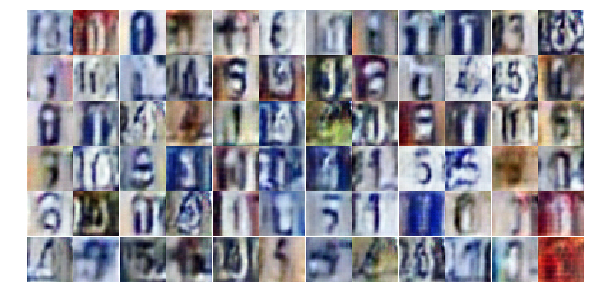

Epoch 10/25... Discriminator Loss: 1.1700... Generator Loss: 0.9495
Epoch 10/25... Discriminator Loss: 1.2131... Generator Loss: 0.8779
Epoch 10/25... Discriminator Loss: 1.2417... Generator Loss: 0.7528
Epoch 10/25... Discriminator Loss: 1.2168... Generator Loss: 0.8122
Epoch 10/25... Discriminator Loss: 1.1307... Generator Loss: 0.9045
Epoch 10/25... Discriminator Loss: 1.2347... Generator Loss: 0.7724
Epoch 10/25... Discriminator Loss: 1.2307... Generator Loss: 0.9254
Epoch 10/25... Discriminator Loss: 1.1992... Generator Loss: 0.7797
Epoch 10/25... Discriminator Loss: 1.1539... Generator Loss: 0.7563
Epoch 10/25... Discriminator Loss: 1.2396... Generator Loss: 0.7878


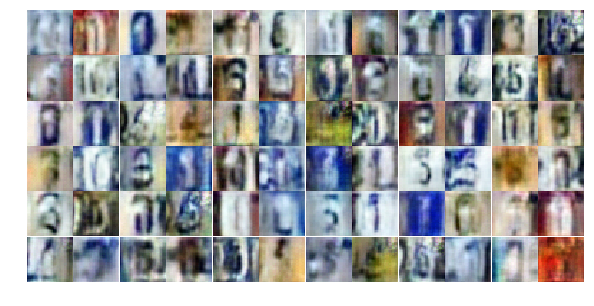

Epoch 10/25... Discriminator Loss: 1.2586... Generator Loss: 0.7133
Epoch 10/25... Discriminator Loss: 1.0875... Generator Loss: 1.0198
Epoch 10/25... Discriminator Loss: 1.1596... Generator Loss: 0.7527
Epoch 10/25... Discriminator Loss: 1.1718... Generator Loss: 0.9480
Epoch 10/25... Discriminator Loss: 1.2985... Generator Loss: 0.9290
Epoch 10/25... Discriminator Loss: 1.2224... Generator Loss: 0.6027
Epoch 10/25... Discriminator Loss: 1.2312... Generator Loss: 0.8922
Epoch 10/25... Discriminator Loss: 1.2879... Generator Loss: 0.9523
Epoch 10/25... Discriminator Loss: 1.2434... Generator Loss: 0.8235
Epoch 10/25... Discriminator Loss: 1.0245... Generator Loss: 1.0493


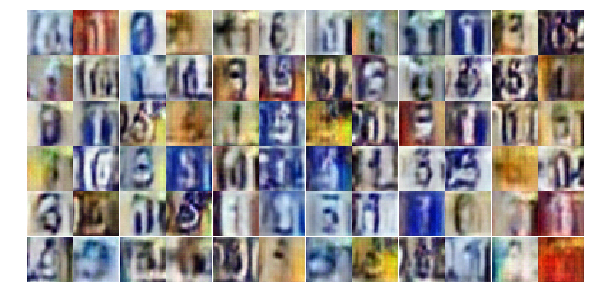

Epoch 10/25... Discriminator Loss: 1.2592... Generator Loss: 0.7718
Epoch 10/25... Discriminator Loss: 1.3522... Generator Loss: 0.7235
Epoch 10/25... Discriminator Loss: 0.7838... Generator Loss: 1.3335
Epoch 11/25... Discriminator Loss: 1.2135... Generator Loss: 0.8037
Epoch 11/25... Discriminator Loss: 1.2370... Generator Loss: 0.8468
Epoch 11/25... Discriminator Loss: 1.3665... Generator Loss: 0.6977
Epoch 11/25... Discriminator Loss: 1.1732... Generator Loss: 0.8169
Epoch 11/25... Discriminator Loss: 1.2727... Generator Loss: 0.8461
Epoch 11/25... Discriminator Loss: 1.2533... Generator Loss: 0.7164
Epoch 11/25... Discriminator Loss: 1.1508... Generator Loss: 0.9336


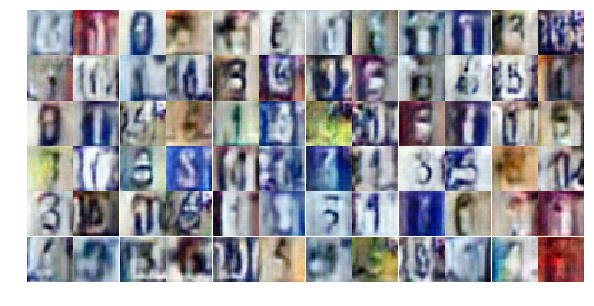

Epoch 11/25... Discriminator Loss: 1.2616... Generator Loss: 0.8036
Epoch 11/25... Discriminator Loss: 1.1614... Generator Loss: 0.8817
Epoch 11/25... Discriminator Loss: 1.2235... Generator Loss: 0.8301
Epoch 11/25... Discriminator Loss: 1.2825... Generator Loss: 0.8494
Epoch 11/25... Discriminator Loss: 1.3683... Generator Loss: 0.8522
Epoch 11/25... Discriminator Loss: 1.1598... Generator Loss: 0.7973
Epoch 11/25... Discriminator Loss: 1.2107... Generator Loss: 0.7856
Epoch 11/25... Discriminator Loss: 1.1944... Generator Loss: 0.9448
Epoch 11/25... Discriminator Loss: 1.2359... Generator Loss: 0.7715
Epoch 11/25... Discriminator Loss: 1.2268... Generator Loss: 0.7308


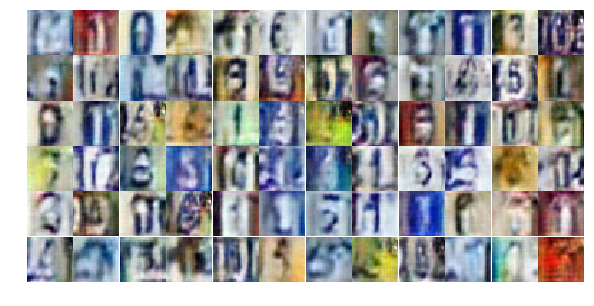

Epoch 11/25... Discriminator Loss: 1.3540... Generator Loss: 0.7089
Epoch 11/25... Discriminator Loss: 1.2329... Generator Loss: 0.9833
Epoch 11/25... Discriminator Loss: 1.3381... Generator Loss: 0.6311
Epoch 11/25... Discriminator Loss: 1.1793... Generator Loss: 0.8372
Epoch 11/25... Discriminator Loss: 1.2516... Generator Loss: 0.9178
Epoch 11/25... Discriminator Loss: 1.0263... Generator Loss: 1.0877
Epoch 11/25... Discriminator Loss: 1.2532... Generator Loss: 0.7594
Epoch 11/25... Discriminator Loss: 1.1802... Generator Loss: 0.8629
Epoch 11/25... Discriminator Loss: 1.2430... Generator Loss: 1.0369
Epoch 11/25... Discriminator Loss: 1.3156... Generator Loss: 0.7318


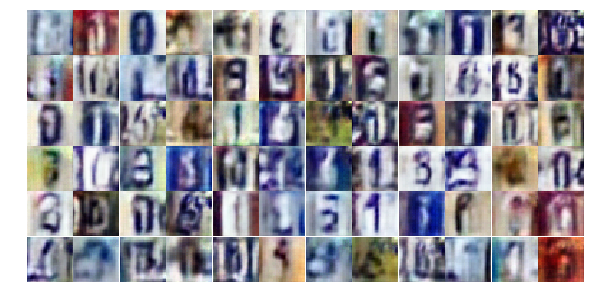

Epoch 11/25... Discriminator Loss: 1.2882... Generator Loss: 0.7582
Epoch 11/25... Discriminator Loss: 1.2653... Generator Loss: 0.7299
Epoch 11/25... Discriminator Loss: 1.2516... Generator Loss: 0.8499
Epoch 11/25... Discriminator Loss: 1.2236... Generator Loss: 0.8470
Epoch 11/25... Discriminator Loss: 1.2893... Generator Loss: 0.7729
Epoch 11/25... Discriminator Loss: 1.1796... Generator Loss: 0.9979
Epoch 11/25... Discriminator Loss: 1.3430... Generator Loss: 0.6546
Epoch 11/25... Discriminator Loss: 1.2202... Generator Loss: 0.8781
Epoch 11/25... Discriminator Loss: 1.3306... Generator Loss: 0.8053
Epoch 11/25... Discriminator Loss: 1.2891... Generator Loss: 0.7075


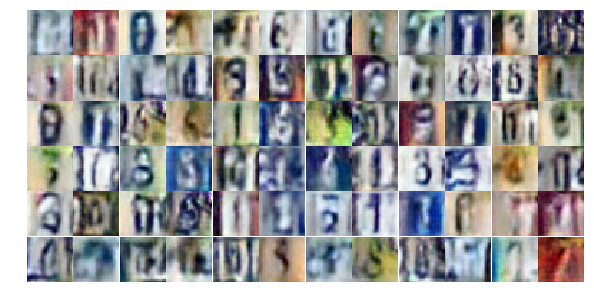

Epoch 11/25... Discriminator Loss: 1.2837... Generator Loss: 0.7630
Epoch 11/25... Discriminator Loss: 1.0467... Generator Loss: 0.9982
Epoch 11/25... Discriminator Loss: 1.2944... Generator Loss: 0.8123
Epoch 11/25... Discriminator Loss: 1.2711... Generator Loss: 0.9486
Epoch 11/25... Discriminator Loss: 1.1908... Generator Loss: 0.7509
Epoch 11/25... Discriminator Loss: 1.3117... Generator Loss: 0.8032
Epoch 11/25... Discriminator Loss: 1.1191... Generator Loss: 0.9936
Epoch 11/25... Discriminator Loss: 1.3190... Generator Loss: 0.7135
Epoch 11/25... Discriminator Loss: 1.2810... Generator Loss: 0.8161
Epoch 11/25... Discriminator Loss: 1.2507... Generator Loss: 0.8298


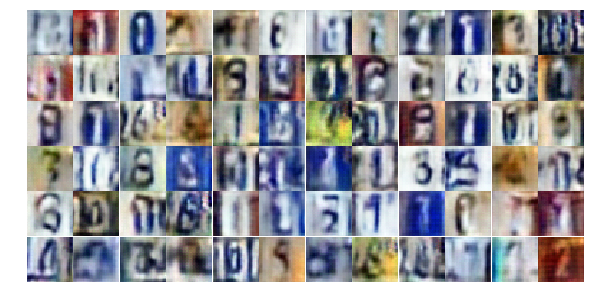

Epoch 11/25... Discriminator Loss: 1.2023... Generator Loss: 0.7756
Epoch 11/25... Discriminator Loss: 1.3185... Generator Loss: 0.6966
Epoch 11/25... Discriminator Loss: 1.1686... Generator Loss: 0.8214
Epoch 11/25... Discriminator Loss: 1.3673... Generator Loss: 0.7257
Epoch 11/25... Discriminator Loss: 1.2929... Generator Loss: 0.7761
Epoch 11/25... Discriminator Loss: 1.2423... Generator Loss: 0.8507
Epoch 11/25... Discriminator Loss: 1.3200... Generator Loss: 0.5790
Epoch 11/25... Discriminator Loss: 1.4473... Generator Loss: 0.5753
Epoch 11/25... Discriminator Loss: 1.5131... Generator Loss: 0.4688
Epoch 11/25... Discriminator Loss: 1.3005... Generator Loss: 0.7086


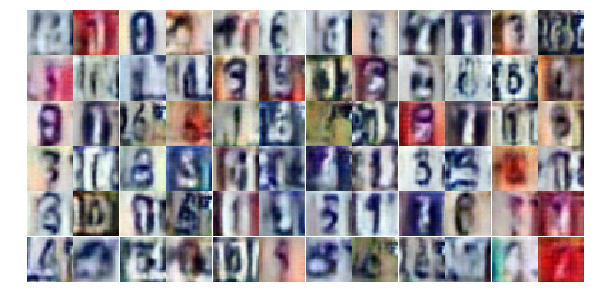

Epoch 12/25... Discriminator Loss: 1.5449... Generator Loss: 1.0668
Epoch 12/25... Discriminator Loss: 1.3230... Generator Loss: 0.7235
Epoch 12/25... Discriminator Loss: 1.2836... Generator Loss: 0.6897
Epoch 12/25... Discriminator Loss: 1.2439... Generator Loss: 0.7625
Epoch 12/25... Discriminator Loss: 1.2342... Generator Loss: 0.7873
Epoch 12/25... Discriminator Loss: 1.2068... Generator Loss: 0.7834
Epoch 12/25... Discriminator Loss: 1.0987... Generator Loss: 0.9276
Epoch 12/25... Discriminator Loss: 1.2317... Generator Loss: 0.7446
Epoch 12/25... Discriminator Loss: 1.4061... Generator Loss: 0.8728
Epoch 12/25... Discriminator Loss: 1.2568... Generator Loss: 0.7772


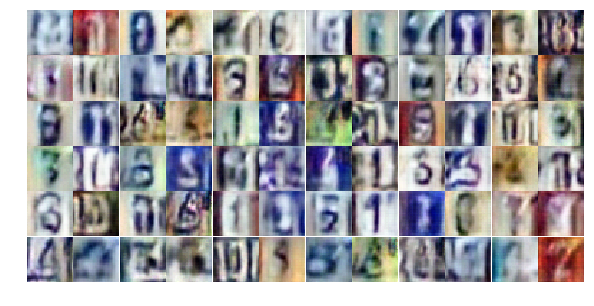

Epoch 12/25... Discriminator Loss: 1.1529... Generator Loss: 1.0152
Epoch 12/25... Discriminator Loss: 1.2910... Generator Loss: 0.7343
Epoch 12/25... Discriminator Loss: 1.1889... Generator Loss: 0.7983
Epoch 12/25... Discriminator Loss: 1.4722... Generator Loss: 0.9318
Epoch 12/25... Discriminator Loss: 1.1555... Generator Loss: 0.9415
Epoch 12/25... Discriminator Loss: 1.3145... Generator Loss: 0.7665
Epoch 12/25... Discriminator Loss: 1.2857... Generator Loss: 0.7552
Epoch 12/25... Discriminator Loss: 1.2367... Generator Loss: 0.9817
Epoch 12/25... Discriminator Loss: 1.1865... Generator Loss: 0.8450
Epoch 12/25... Discriminator Loss: 1.2526... Generator Loss: 0.8074


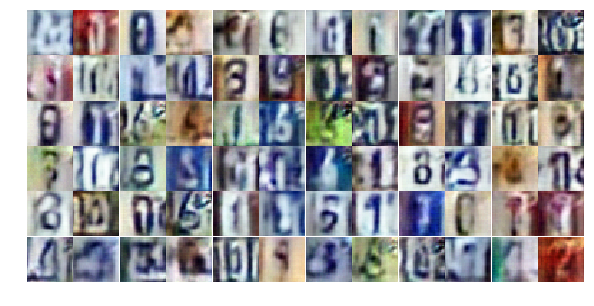

Epoch 12/25... Discriminator Loss: 1.1759... Generator Loss: 0.8251
Epoch 12/25... Discriminator Loss: 1.2054... Generator Loss: 0.8974
Epoch 12/25... Discriminator Loss: 1.2013... Generator Loss: 0.8229
Epoch 12/25... Discriminator Loss: 1.1209... Generator Loss: 0.7893
Epoch 12/25... Discriminator Loss: 0.9874... Generator Loss: 1.0838
Epoch 12/25... Discriminator Loss: 0.9729... Generator Loss: 1.2225
Epoch 12/25... Discriminator Loss: 1.2837... Generator Loss: 0.7818
Epoch 12/25... Discriminator Loss: 1.1402... Generator Loss: 0.9386
Epoch 12/25... Discriminator Loss: 1.2705... Generator Loss: 0.8054
Epoch 12/25... Discriminator Loss: 1.0850... Generator Loss: 0.9226


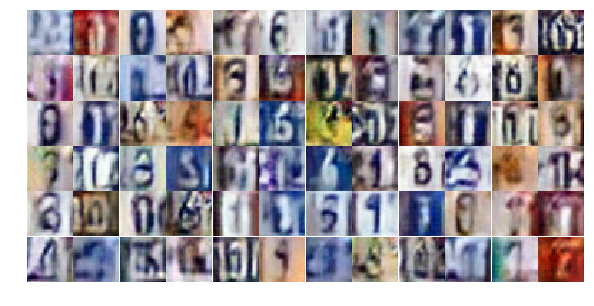

Epoch 12/25... Discriminator Loss: 1.2175... Generator Loss: 0.7765
Epoch 12/25... Discriminator Loss: 1.2673... Generator Loss: 0.6606
Epoch 12/25... Discriminator Loss: 1.0853... Generator Loss: 0.9041
Epoch 12/25... Discriminator Loss: 1.3510... Generator Loss: 0.6163
Epoch 12/25... Discriminator Loss: 1.2841... Generator Loss: 0.7654
Epoch 12/25... Discriminator Loss: 1.2511... Generator Loss: 0.7259
Epoch 12/25... Discriminator Loss: 1.3633... Generator Loss: 0.6279
Epoch 12/25... Discriminator Loss: 1.1687... Generator Loss: 0.8345
Epoch 12/25... Discriminator Loss: 1.2650... Generator Loss: 0.9440
Epoch 12/25... Discriminator Loss: 1.0645... Generator Loss: 1.0473


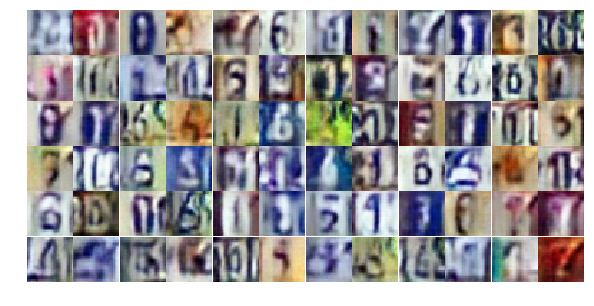

Epoch 12/25... Discriminator Loss: 1.3227... Generator Loss: 0.7716
Epoch 12/25... Discriminator Loss: 1.2302... Generator Loss: 0.7501
Epoch 12/25... Discriminator Loss: 1.1042... Generator Loss: 0.8792
Epoch 12/25... Discriminator Loss: 1.2805... Generator Loss: 0.8109
Epoch 12/25... Discriminator Loss: 1.1719... Generator Loss: 0.9468
Epoch 12/25... Discriminator Loss: 1.1570... Generator Loss: 0.7499
Epoch 12/25... Discriminator Loss: 1.1186... Generator Loss: 1.0659
Epoch 12/25... Discriminator Loss: 1.3013... Generator Loss: 0.6823
Epoch 12/25... Discriminator Loss: 1.2822... Generator Loss: 0.7045
Epoch 12/25... Discriminator Loss: 1.2986... Generator Loss: 0.7087


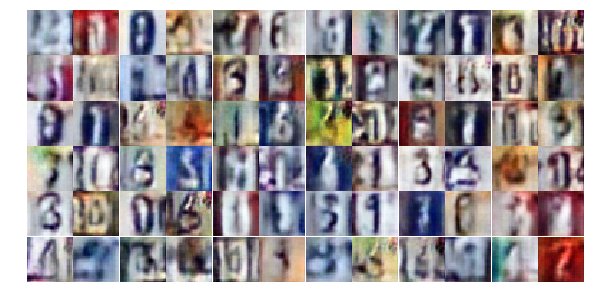

Epoch 12/25... Discriminator Loss: 1.2994... Generator Loss: 0.7385
Epoch 12/25... Discriminator Loss: 1.1681... Generator Loss: 0.8728
Epoch 12/25... Discriminator Loss: 1.2073... Generator Loss: 0.9586
Epoch 12/25... Discriminator Loss: 1.4221... Generator Loss: 0.7805
Epoch 12/25... Discriminator Loss: 1.2706... Generator Loss: 0.8269
Epoch 12/25... Discriminator Loss: 1.3671... Generator Loss: 0.6753
Epoch 12/25... Discriminator Loss: 1.2062... Generator Loss: 0.9121
Epoch 13/25... Discriminator Loss: 1.1120... Generator Loss: 1.1478
Epoch 13/25... Discriminator Loss: 1.2537... Generator Loss: 0.7912
Epoch 13/25... Discriminator Loss: 1.3379... Generator Loss: 0.6853


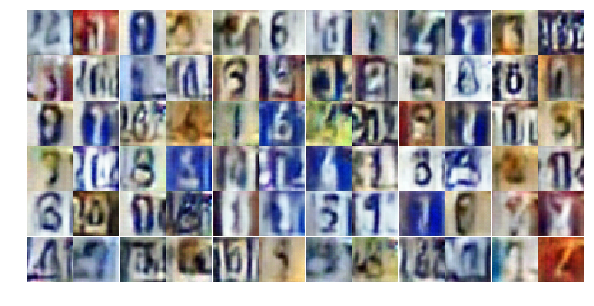

Epoch 13/25... Discriminator Loss: 1.3022... Generator Loss: 0.7265
Epoch 13/25... Discriminator Loss: 1.2096... Generator Loss: 0.8659
Epoch 13/25... Discriminator Loss: 1.2489... Generator Loss: 0.7911
Epoch 13/25... Discriminator Loss: 1.4236... Generator Loss: 0.6706
Epoch 13/25... Discriminator Loss: 1.3175... Generator Loss: 0.6072
Epoch 13/25... Discriminator Loss: 1.1722... Generator Loss: 0.8872
Epoch 13/25... Discriminator Loss: 1.2173... Generator Loss: 0.7981
Epoch 13/25... Discriminator Loss: 1.2947... Generator Loss: 0.5429
Epoch 13/25... Discriminator Loss: 1.2172... Generator Loss: 0.7922
Epoch 13/25... Discriminator Loss: 1.2550... Generator Loss: 0.8212


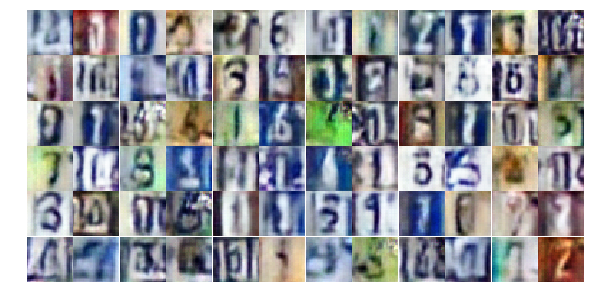

Epoch 13/25... Discriminator Loss: 1.1994... Generator Loss: 0.9302
Epoch 13/25... Discriminator Loss: 1.1906... Generator Loss: 0.8494
Epoch 13/25... Discriminator Loss: 1.2588... Generator Loss: 0.7951
Epoch 13/25... Discriminator Loss: 1.1838... Generator Loss: 0.8427
Epoch 13/25... Discriminator Loss: 1.1124... Generator Loss: 0.8333
Epoch 13/25... Discriminator Loss: 1.2162... Generator Loss: 0.7921
Epoch 13/25... Discriminator Loss: 1.1641... Generator Loss: 0.8650
Epoch 13/25... Discriminator Loss: 1.3925... Generator Loss: 0.6828
Epoch 13/25... Discriminator Loss: 1.0470... Generator Loss: 1.0266
Epoch 13/25... Discriminator Loss: 1.3487... Generator Loss: 0.6198


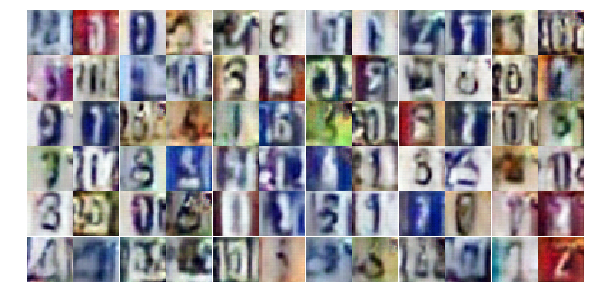

Epoch 13/25... Discriminator Loss: 1.2242... Generator Loss: 0.8177
Epoch 13/25... Discriminator Loss: 1.2442... Generator Loss: 0.7903
Epoch 13/25... Discriminator Loss: 1.2487... Generator Loss: 0.7954
Epoch 13/25... Discriminator Loss: 1.2284... Generator Loss: 0.8557
Epoch 13/25... Discriminator Loss: 1.2290... Generator Loss: 0.8368
Epoch 13/25... Discriminator Loss: 1.2282... Generator Loss: 0.7256
Epoch 13/25... Discriminator Loss: 1.3451... Generator Loss: 0.6850
Epoch 13/25... Discriminator Loss: 1.3504... Generator Loss: 0.7207
Epoch 13/25... Discriminator Loss: 1.2121... Generator Loss: 0.7879
Epoch 13/25... Discriminator Loss: 1.3755... Generator Loss: 0.7902


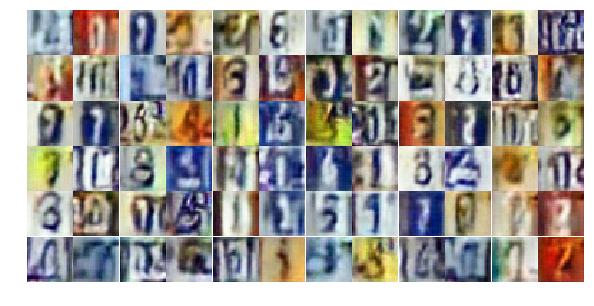

Epoch 13/25... Discriminator Loss: 1.2186... Generator Loss: 0.8321
Epoch 13/25... Discriminator Loss: 1.3186... Generator Loss: 0.6578
Epoch 13/25... Discriminator Loss: 1.2863... Generator Loss: 0.6976
Epoch 13/25... Discriminator Loss: 1.1746... Generator Loss: 0.8096
Epoch 13/25... Discriminator Loss: 1.2539... Generator Loss: 0.8102
Epoch 13/25... Discriminator Loss: 1.2015... Generator Loss: 0.9901
Epoch 13/25... Discriminator Loss: 1.1651... Generator Loss: 0.9242
Epoch 13/25... Discriminator Loss: 1.3322... Generator Loss: 0.8579
Epoch 13/25... Discriminator Loss: 1.2727... Generator Loss: 0.6799
Epoch 13/25... Discriminator Loss: 1.3795... Generator Loss: 0.6760


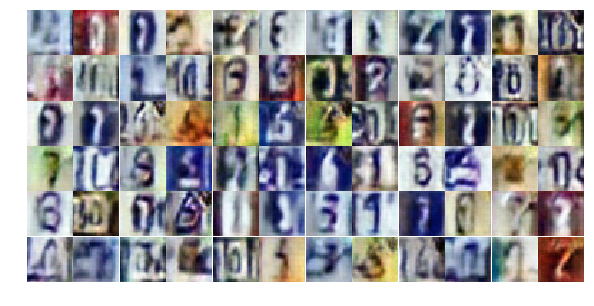

Epoch 13/25... Discriminator Loss: 1.2118... Generator Loss: 0.8588
Epoch 13/25... Discriminator Loss: 1.1668... Generator Loss: 0.9225
Epoch 13/25... Discriminator Loss: 1.3501... Generator Loss: 0.6565
Epoch 13/25... Discriminator Loss: 1.4995... Generator Loss: 0.9104
Epoch 13/25... Discriminator Loss: 1.3855... Generator Loss: 0.7003
Epoch 13/25... Discriminator Loss: 1.2517... Generator Loss: 0.6883
Epoch 13/25... Discriminator Loss: 1.3482... Generator Loss: 0.7568
Epoch 13/25... Discriminator Loss: 1.2536... Generator Loss: 0.7934
Epoch 13/25... Discriminator Loss: 1.3196... Generator Loss: 0.6971
Epoch 13/25... Discriminator Loss: 1.2127... Generator Loss: 0.7993


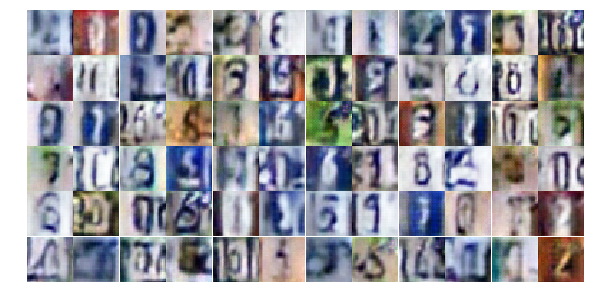

Epoch 13/25... Discriminator Loss: 1.1516... Generator Loss: 0.9826
Epoch 13/25... Discriminator Loss: 1.1145... Generator Loss: 0.8572
Epoch 13/25... Discriminator Loss: 1.2330... Generator Loss: 0.7294
Epoch 13/25... Discriminator Loss: 1.2722... Generator Loss: 0.6636
Epoch 14/25... Discriminator Loss: 1.2926... Generator Loss: 0.6337
Epoch 14/25... Discriminator Loss: 1.2206... Generator Loss: 0.8457
Epoch 14/25... Discriminator Loss: 1.1225... Generator Loss: 0.8126
Epoch 14/25... Discriminator Loss: 1.1658... Generator Loss: 0.9032
Epoch 14/25... Discriminator Loss: 1.2967... Generator Loss: 0.7683
Epoch 14/25... Discriminator Loss: 1.3228... Generator Loss: 0.6723


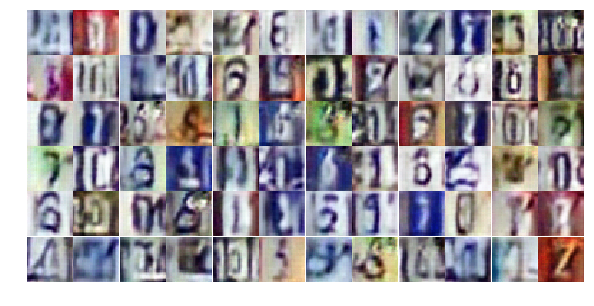

Epoch 14/25... Discriminator Loss: 1.3800... Generator Loss: 0.7209
Epoch 14/25... Discriminator Loss: 1.2934... Generator Loss: 0.6215
Epoch 14/25... Discriminator Loss: 1.2578... Generator Loss: 0.6786
Epoch 14/25... Discriminator Loss: 1.2696... Generator Loss: 0.7743
Epoch 14/25... Discriminator Loss: 1.3063... Generator Loss: 0.6647
Epoch 14/25... Discriminator Loss: 1.3395... Generator Loss: 0.7597
Epoch 14/25... Discriminator Loss: 1.0741... Generator Loss: 0.9098
Epoch 14/25... Discriminator Loss: 1.3266... Generator Loss: 0.6748
Epoch 14/25... Discriminator Loss: 1.3867... Generator Loss: 0.6596
Epoch 14/25... Discriminator Loss: 1.2494... Generator Loss: 0.7505


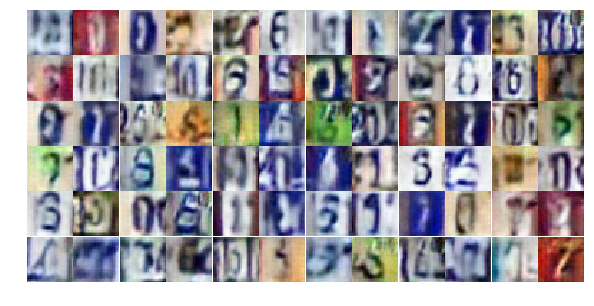

Epoch 14/25... Discriminator Loss: 1.2551... Generator Loss: 0.8357
Epoch 14/25... Discriminator Loss: 1.2737... Generator Loss: 0.8255
Epoch 14/25... Discriminator Loss: 1.2390... Generator Loss: 0.7984
Epoch 14/25... Discriminator Loss: 1.2557... Generator Loss: 0.7592
Epoch 14/25... Discriminator Loss: 1.4364... Generator Loss: 0.6486
Epoch 14/25... Discriminator Loss: 1.2694... Generator Loss: 0.6950
Epoch 14/25... Discriminator Loss: 1.3498... Generator Loss: 0.7166
Epoch 14/25... Discriminator Loss: 1.3043... Generator Loss: 0.6426
Epoch 14/25... Discriminator Loss: 1.3449... Generator Loss: 0.7720
Epoch 14/25... Discriminator Loss: 1.3634... Generator Loss: 0.5893


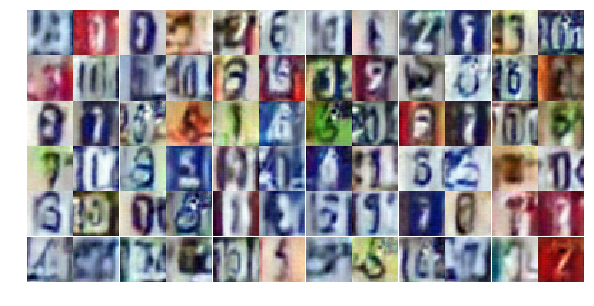

Epoch 14/25... Discriminator Loss: 1.2819... Generator Loss: 0.7153
Epoch 14/25... Discriminator Loss: 1.1759... Generator Loss: 0.7928
Epoch 14/25... Discriminator Loss: 1.2201... Generator Loss: 0.8833
Epoch 14/25... Discriminator Loss: 1.2635... Generator Loss: 0.8771
Epoch 14/25... Discriminator Loss: 1.2284... Generator Loss: 0.8728
Epoch 14/25... Discriminator Loss: 1.2777... Generator Loss: 0.8701
Epoch 14/25... Discriminator Loss: 1.1924... Generator Loss: 0.8940
Epoch 14/25... Discriminator Loss: 1.2385... Generator Loss: 0.9200
Epoch 14/25... Discriminator Loss: 1.2953... Generator Loss: 0.7340
Epoch 14/25... Discriminator Loss: 1.4173... Generator Loss: 0.7434


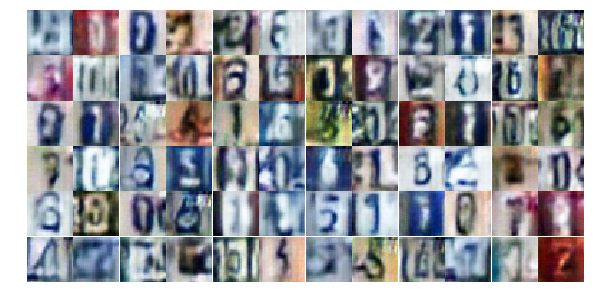

Epoch 14/25... Discriminator Loss: 1.2937... Generator Loss: 0.7072
Epoch 14/25... Discriminator Loss: 1.1747... Generator Loss: 0.8233
Epoch 14/25... Discriminator Loss: 1.1843... Generator Loss: 0.7459
Epoch 14/25... Discriminator Loss: 1.3687... Generator Loss: 0.7913
Epoch 14/25... Discriminator Loss: 1.2821... Generator Loss: 0.7878
Epoch 14/25... Discriminator Loss: 1.3915... Generator Loss: 0.6236
Epoch 14/25... Discriminator Loss: 1.2916... Generator Loss: 0.7481
Epoch 14/25... Discriminator Loss: 1.1835... Generator Loss: 0.8494
Epoch 14/25... Discriminator Loss: 1.4222... Generator Loss: 0.6232
Epoch 14/25... Discriminator Loss: 1.3831... Generator Loss: 0.7090


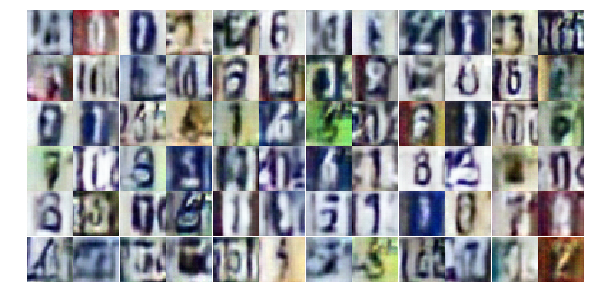

Epoch 14/25... Discriminator Loss: 1.3549... Generator Loss: 0.7442
Epoch 14/25... Discriminator Loss: 1.2923... Generator Loss: 0.8382
Epoch 14/25... Discriminator Loss: 1.3096... Generator Loss: 0.6992
Epoch 14/25... Discriminator Loss: 1.3512... Generator Loss: 0.7082
Epoch 14/25... Discriminator Loss: 1.1937... Generator Loss: 0.9192
Epoch 14/25... Discriminator Loss: 1.4535... Generator Loss: 0.5828
Epoch 14/25... Discriminator Loss: 1.2627... Generator Loss: 0.7581
Epoch 14/25... Discriminator Loss: 1.2637... Generator Loss: 0.7021
Epoch 14/25... Discriminator Loss: 1.3479... Generator Loss: 0.8144
Epoch 14/25... Discriminator Loss: 1.3662... Generator Loss: 0.6982


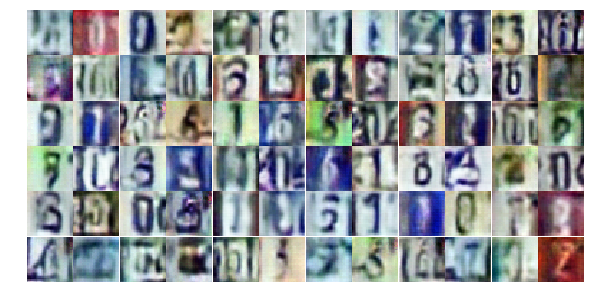

Epoch 14/25... Discriminator Loss: 1.2491... Generator Loss: 0.7820
Epoch 14/25... Discriminator Loss: 1.2428... Generator Loss: 0.9222
Epoch 15/25... Discriminator Loss: 1.4138... Generator Loss: 0.7229
Epoch 15/25... Discriminator Loss: 1.2520... Generator Loss: 0.9173
Epoch 15/25... Discriminator Loss: 1.1338... Generator Loss: 0.9422
Epoch 15/25... Discriminator Loss: 1.2732... Generator Loss: 0.8823
Epoch 15/25... Discriminator Loss: 1.2595... Generator Loss: 0.7618
Epoch 15/25... Discriminator Loss: 1.1450... Generator Loss: 0.9082
Epoch 15/25... Discriminator Loss: 1.3309... Generator Loss: 0.7224
Epoch 15/25... Discriminator Loss: 1.2576... Generator Loss: 0.7742


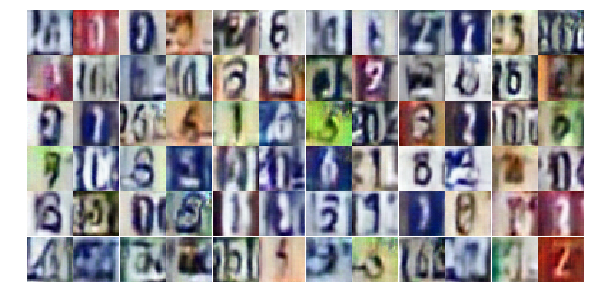

Epoch 15/25... Discriminator Loss: 1.2838... Generator Loss: 0.6883
Epoch 15/25... Discriminator Loss: 1.2981... Generator Loss: 0.7032
Epoch 15/25... Discriminator Loss: 1.3180... Generator Loss: 0.7981
Epoch 15/25... Discriminator Loss: 1.5420... Generator Loss: 0.5688
Epoch 15/25... Discriminator Loss: 1.4171... Generator Loss: 0.8323
Epoch 15/25... Discriminator Loss: 1.2353... Generator Loss: 0.7691
Epoch 15/25... Discriminator Loss: 1.3302... Generator Loss: 0.6942
Epoch 15/25... Discriminator Loss: 1.3672... Generator Loss: 0.6385
Epoch 15/25... Discriminator Loss: 1.3167... Generator Loss: 0.7789
Epoch 15/25... Discriminator Loss: 1.2808... Generator Loss: 0.7818


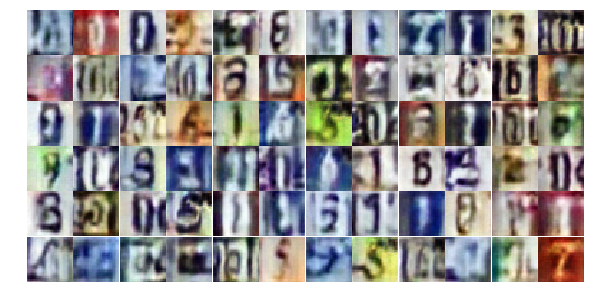

Epoch 15/25... Discriminator Loss: 1.2436... Generator Loss: 0.8567
Epoch 15/25... Discriminator Loss: 1.4354... Generator Loss: 0.6603
Epoch 15/25... Discriminator Loss: 1.2530... Generator Loss: 0.8168
Epoch 15/25... Discriminator Loss: 1.3378... Generator Loss: 0.7366
Epoch 15/25... Discriminator Loss: 1.2518... Generator Loss: 0.7578
Epoch 15/25... Discriminator Loss: 1.2920... Generator Loss: 0.7862
Epoch 15/25... Discriminator Loss: 1.2675... Generator Loss: 0.7603
Epoch 15/25... Discriminator Loss: 1.3455... Generator Loss: 0.5938
Epoch 15/25... Discriminator Loss: 1.2805... Generator Loss: 0.7699
Epoch 15/25... Discriminator Loss: 1.3861... Generator Loss: 0.5710


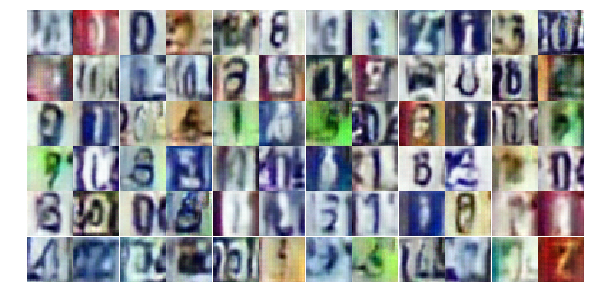

Epoch 15/25... Discriminator Loss: 1.2851... Generator Loss: 0.8928
Epoch 15/25... Discriminator Loss: 1.2664... Generator Loss: 0.6812
Epoch 15/25... Discriminator Loss: 1.2330... Generator Loss: 0.7542
Epoch 15/25... Discriminator Loss: 1.3352... Generator Loss: 0.6979
Epoch 15/25... Discriminator Loss: 1.4381... Generator Loss: 0.6317
Epoch 15/25... Discriminator Loss: 1.2216... Generator Loss: 0.8587
Epoch 15/25... Discriminator Loss: 1.3302... Generator Loss: 1.1513
Epoch 15/25... Discriminator Loss: 1.3968... Generator Loss: 0.5987
Epoch 15/25... Discriminator Loss: 1.2232... Generator Loss: 0.7312
Epoch 15/25... Discriminator Loss: 1.2799... Generator Loss: 0.7866


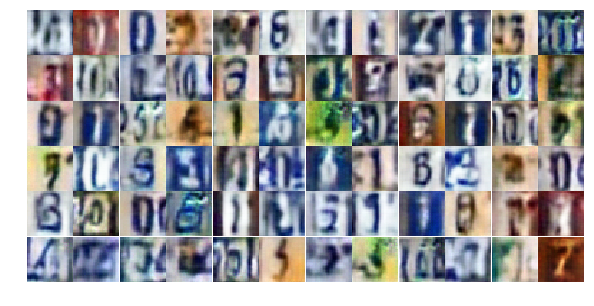

Epoch 15/25... Discriminator Loss: 1.2756... Generator Loss: 0.8299
Epoch 15/25... Discriminator Loss: 1.4260... Generator Loss: 0.5387
Epoch 15/25... Discriminator Loss: 1.2945... Generator Loss: 0.7917
Epoch 15/25... Discriminator Loss: 1.1506... Generator Loss: 0.9011
Epoch 15/25... Discriminator Loss: 1.1979... Generator Loss: 0.7324
Epoch 15/25... Discriminator Loss: 1.3046... Generator Loss: 0.5485
Epoch 15/25... Discriminator Loss: 1.1229... Generator Loss: 0.8952
Epoch 15/25... Discriminator Loss: 1.4118... Generator Loss: 0.5512
Epoch 15/25... Discriminator Loss: 1.3960... Generator Loss: 0.6083
Epoch 15/25... Discriminator Loss: 1.3357... Generator Loss: 0.8217


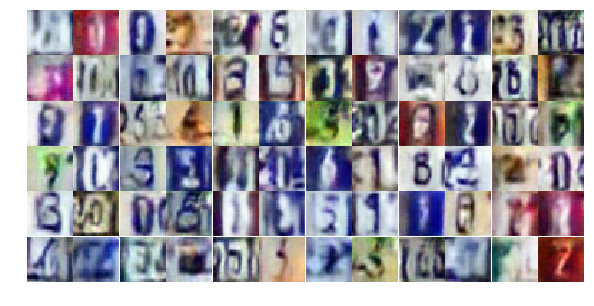

Epoch 15/25... Discriminator Loss: 1.2648... Generator Loss: 0.7503
Epoch 15/25... Discriminator Loss: 1.3940... Generator Loss: 0.7559
Epoch 15/25... Discriminator Loss: 1.2856... Generator Loss: 0.7281
Epoch 15/25... Discriminator Loss: 1.2789... Generator Loss: 0.7144
Epoch 15/25... Discriminator Loss: 1.1694... Generator Loss: 0.8349
Epoch 15/25... Discriminator Loss: 1.2963... Generator Loss: 0.6693
Epoch 15/25... Discriminator Loss: 1.4345... Generator Loss: 0.5599
Epoch 15/25... Discriminator Loss: 1.3781... Generator Loss: 0.7264
Epoch 15/25... Discriminator Loss: 1.3253... Generator Loss: 0.6960
Epoch 16/25... Discriminator Loss: 1.3414... Generator Loss: 0.8058


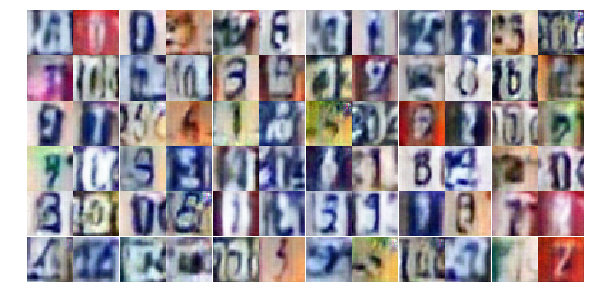

Epoch 16/25... Discriminator Loss: 1.2565... Generator Loss: 0.7751
Epoch 16/25... Discriminator Loss: 1.1325... Generator Loss: 0.9052
Epoch 16/25... Discriminator Loss: 1.1669... Generator Loss: 0.9731
Epoch 16/25... Discriminator Loss: 1.2869... Generator Loss: 0.8305
Epoch 16/25... Discriminator Loss: 1.2466... Generator Loss: 0.7427
Epoch 16/25... Discriminator Loss: 1.2489... Generator Loss: 0.8108
Epoch 16/25... Discriminator Loss: 1.3739... Generator Loss: 0.6317
Epoch 16/25... Discriminator Loss: 1.3642... Generator Loss: 0.6706
Epoch 16/25... Discriminator Loss: 1.2569... Generator Loss: 0.7494
Epoch 16/25... Discriminator Loss: 1.2065... Generator Loss: 0.8422


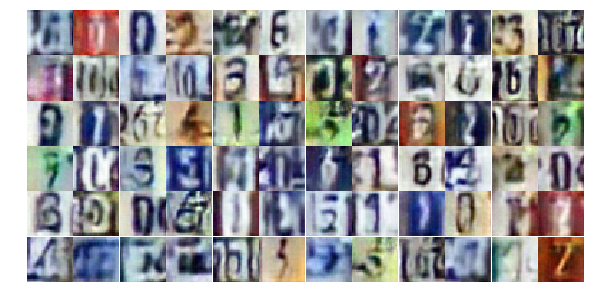

Epoch 16/25... Discriminator Loss: 1.3400... Generator Loss: 0.7672
Epoch 16/25... Discriminator Loss: 1.1128... Generator Loss: 0.9464
Epoch 16/25... Discriminator Loss: 1.2842... Generator Loss: 0.8622
Epoch 16/25... Discriminator Loss: 1.1581... Generator Loss: 0.8078
Epoch 16/25... Discriminator Loss: 1.4110... Generator Loss: 0.5871
Epoch 16/25... Discriminator Loss: 1.3208... Generator Loss: 0.7299
Epoch 16/25... Discriminator Loss: 1.3191... Generator Loss: 0.6631
Epoch 16/25... Discriminator Loss: 1.3090... Generator Loss: 0.7113
Epoch 16/25... Discriminator Loss: 1.2843... Generator Loss: 0.8634
Epoch 16/25... Discriminator Loss: 1.2317... Generator Loss: 0.8295


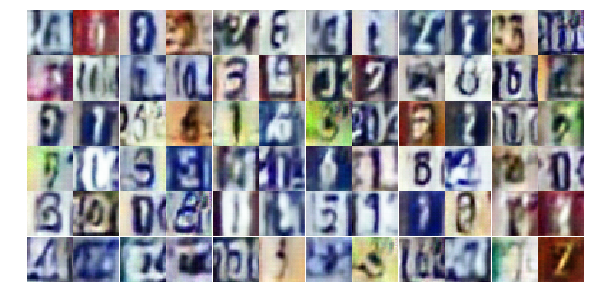

Epoch 16/25... Discriminator Loss: 1.3298... Generator Loss: 0.7278
Epoch 16/25... Discriminator Loss: 1.2642... Generator Loss: 0.7420
Epoch 16/25... Discriminator Loss: 1.3343... Generator Loss: 0.7266
Epoch 16/25... Discriminator Loss: 1.2545... Generator Loss: 0.7682
Epoch 16/25... Discriminator Loss: 1.3607... Generator Loss: 0.7194
Epoch 16/25... Discriminator Loss: 1.3959... Generator Loss: 0.6732
Epoch 16/25... Discriminator Loss: 1.3044... Generator Loss: 0.7287
Epoch 16/25... Discriminator Loss: 1.2783... Generator Loss: 0.8880
Epoch 16/25... Discriminator Loss: 1.2554... Generator Loss: 0.7566
Epoch 16/25... Discriminator Loss: 1.3434... Generator Loss: 0.6307


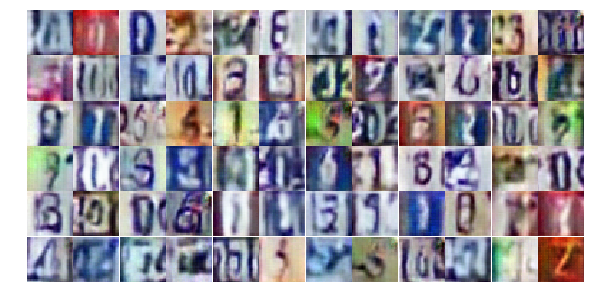

Epoch 16/25... Discriminator Loss: 1.1988... Generator Loss: 0.9811
Epoch 16/25... Discriminator Loss: 1.2634... Generator Loss: 0.7607
Epoch 16/25... Discriminator Loss: 1.1799... Generator Loss: 0.8720
Epoch 16/25... Discriminator Loss: 1.2628... Generator Loss: 0.8131
Epoch 16/25... Discriminator Loss: 1.4648... Generator Loss: 0.6279
Epoch 16/25... Discriminator Loss: 1.2894... Generator Loss: 0.8465
Epoch 16/25... Discriminator Loss: 1.2388... Generator Loss: 0.7725
Epoch 16/25... Discriminator Loss: 1.4468... Generator Loss: 0.5484
Epoch 16/25... Discriminator Loss: 1.3192... Generator Loss: 0.6490
Epoch 16/25... Discriminator Loss: 1.2699... Generator Loss: 0.7350


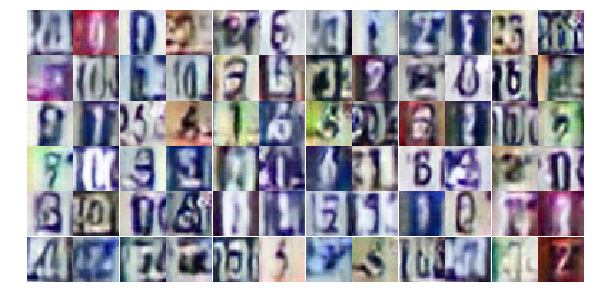

Epoch 16/25... Discriminator Loss: 1.3146... Generator Loss: 0.8725
Epoch 16/25... Discriminator Loss: 1.2641... Generator Loss: 0.7930
Epoch 16/25... Discriminator Loss: 1.3241... Generator Loss: 0.6946
Epoch 16/25... Discriminator Loss: 1.4280... Generator Loss: 0.6494
Epoch 16/25... Discriminator Loss: 1.3957... Generator Loss: 0.6036
Epoch 16/25... Discriminator Loss: 1.3008... Generator Loss: 0.6930
Epoch 16/25... Discriminator Loss: 1.3377... Generator Loss: 0.7321
Epoch 16/25... Discriminator Loss: 1.2719... Generator Loss: 0.6906
Epoch 16/25... Discriminator Loss: 1.2557... Generator Loss: 0.8101
Epoch 16/25... Discriminator Loss: 1.0972... Generator Loss: 1.0768


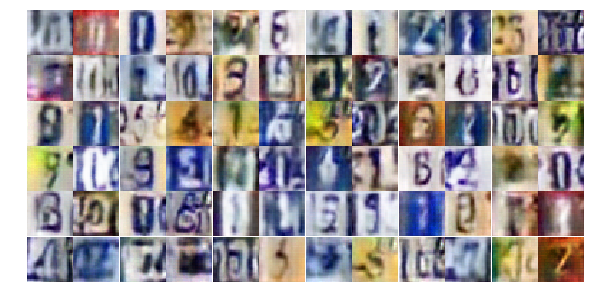

Epoch 16/25... Discriminator Loss: 1.3022... Generator Loss: 0.5830
Epoch 16/25... Discriminator Loss: 1.2939... Generator Loss: 0.7300
Epoch 16/25... Discriminator Loss: 1.4679... Generator Loss: 0.5290
Epoch 16/25... Discriminator Loss: 1.2388... Generator Loss: 0.7928
Epoch 16/25... Discriminator Loss: 1.2875... Generator Loss: 0.8369
Epoch 16/25... Discriminator Loss: 1.3441... Generator Loss: 0.7008
Epoch 17/25... Discriminator Loss: 1.3400... Generator Loss: 0.8050
Epoch 17/25... Discriminator Loss: 1.3792... Generator Loss: 0.6763
Epoch 17/25... Discriminator Loss: 1.3387... Generator Loss: 0.7693
Epoch 17/25... Discriminator Loss: 1.3084... Generator Loss: 0.7393


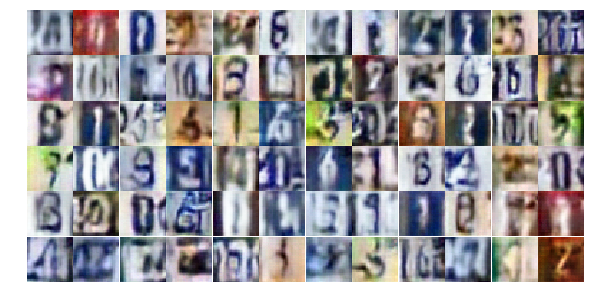

Epoch 17/25... Discriminator Loss: 1.2614... Generator Loss: 0.8625
Epoch 17/25... Discriminator Loss: 1.2386... Generator Loss: 0.7284
Epoch 17/25... Discriminator Loss: 1.2398... Generator Loss: 0.7872
Epoch 17/25... Discriminator Loss: 1.2980... Generator Loss: 0.7434
Epoch 17/25... Discriminator Loss: 1.3867... Generator Loss: 0.6535
Epoch 17/25... Discriminator Loss: 1.2728... Generator Loss: 0.7492
Epoch 17/25... Discriminator Loss: 1.2840... Generator Loss: 0.7105
Epoch 17/25... Discriminator Loss: 1.2814... Generator Loss: 0.8515
Epoch 17/25... Discriminator Loss: 1.2285... Generator Loss: 0.8182
Epoch 17/25... Discriminator Loss: 1.3096... Generator Loss: 0.7448


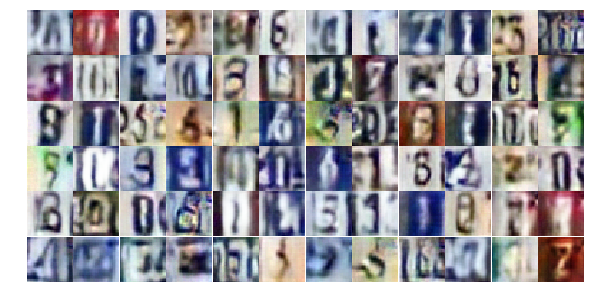

Epoch 17/25... Discriminator Loss: 1.2777... Generator Loss: 0.7172
Epoch 17/25... Discriminator Loss: 1.3173... Generator Loss: 0.6780
Epoch 17/25... Discriminator Loss: 1.0702... Generator Loss: 0.9621
Epoch 17/25... Discriminator Loss: 1.3236... Generator Loss: 0.8286
Epoch 17/25... Discriminator Loss: 1.2384... Generator Loss: 0.8475
Epoch 17/25... Discriminator Loss: 1.2208... Generator Loss: 0.7590
Epoch 17/25... Discriminator Loss: 1.2732... Generator Loss: 0.7836
Epoch 17/25... Discriminator Loss: 1.3157... Generator Loss: 0.7616
Epoch 17/25... Discriminator Loss: 1.3363... Generator Loss: 0.8004
Epoch 17/25... Discriminator Loss: 1.2719... Generator Loss: 0.6980


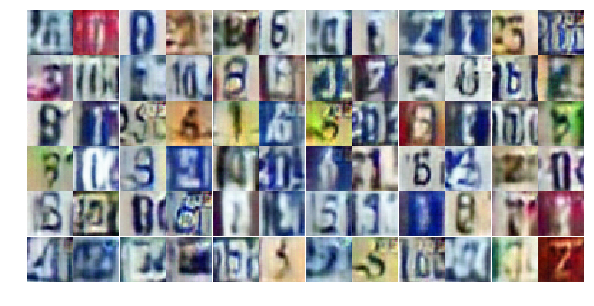

Epoch 17/25... Discriminator Loss: 1.3858... Generator Loss: 0.7348
Epoch 17/25... Discriminator Loss: 1.4104... Generator Loss: 0.6343
Epoch 17/25... Discriminator Loss: 1.2234... Generator Loss: 0.7981
Epoch 17/25... Discriminator Loss: 1.3085... Generator Loss: 0.7786
Epoch 17/25... Discriminator Loss: 1.2486... Generator Loss: 0.8108
Epoch 17/25... Discriminator Loss: 1.2900... Generator Loss: 0.7538
Epoch 17/25... Discriminator Loss: 1.3140... Generator Loss: 0.7727
Epoch 17/25... Discriminator Loss: 1.2869... Generator Loss: 0.6455
Epoch 17/25... Discriminator Loss: 1.3658... Generator Loss: 0.6699
Epoch 17/25... Discriminator Loss: 1.3027... Generator Loss: 0.7262


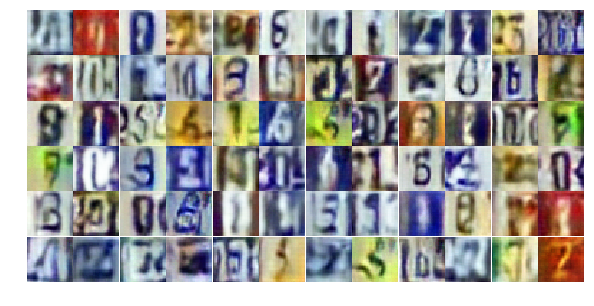

Epoch 17/25... Discriminator Loss: 1.2994... Generator Loss: 0.6983
Epoch 17/25... Discriminator Loss: 1.3787... Generator Loss: 0.7050
Epoch 17/25... Discriminator Loss: 1.2169... Generator Loss: 0.8454
Epoch 17/25... Discriminator Loss: 1.2805... Generator Loss: 0.8135
Epoch 17/25... Discriminator Loss: 1.4368... Generator Loss: 0.6116
Epoch 17/25... Discriminator Loss: 1.1491... Generator Loss: 0.8601
Epoch 17/25... Discriminator Loss: 1.3625... Generator Loss: 0.6900
Epoch 17/25... Discriminator Loss: 1.4563... Generator Loss: 0.7293
Epoch 17/25... Discriminator Loss: 1.2814... Generator Loss: 0.8264
Epoch 17/25... Discriminator Loss: 1.2201... Generator Loss: 0.7400


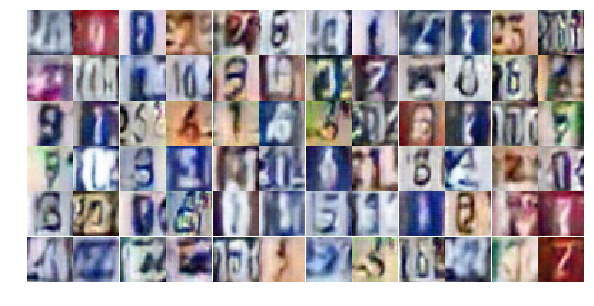

Epoch 17/25... Discriminator Loss: 1.3839... Generator Loss: 0.6000
Epoch 17/25... Discriminator Loss: 1.1277... Generator Loss: 1.0613
Epoch 17/25... Discriminator Loss: 1.2372... Generator Loss: 0.8385
Epoch 17/25... Discriminator Loss: 1.3214... Generator Loss: 0.6317
Epoch 17/25... Discriminator Loss: 1.3544... Generator Loss: 0.7630
Epoch 17/25... Discriminator Loss: 1.4014... Generator Loss: 0.6644
Epoch 17/25... Discriminator Loss: 1.0885... Generator Loss: 0.9615
Epoch 17/25... Discriminator Loss: 1.3246... Generator Loss: 0.7765
Epoch 17/25... Discriminator Loss: 1.3280... Generator Loss: 0.7884
Epoch 17/25... Discriminator Loss: 1.1949... Generator Loss: 0.7855


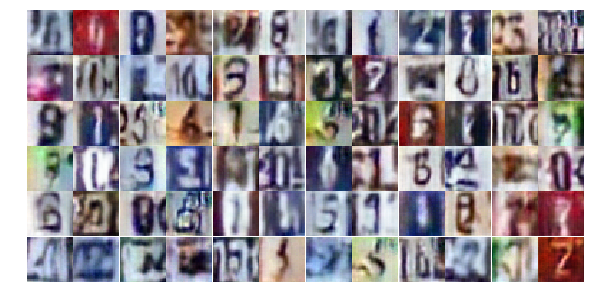

Epoch 17/25... Discriminator Loss: 1.2805... Generator Loss: 0.7736
Epoch 17/25... Discriminator Loss: 1.6392... Generator Loss: 1.0150
Epoch 17/25... Discriminator Loss: 1.0318... Generator Loss: 1.0409
Epoch 17/25... Discriminator Loss: 1.2926... Generator Loss: 0.8586
Epoch 18/25... Discriminator Loss: 1.2833... Generator Loss: 0.7281
Epoch 18/25... Discriminator Loss: 1.2712... Generator Loss: 0.7821
Epoch 18/25... Discriminator Loss: 1.3663... Generator Loss: 0.7077
Epoch 18/25... Discriminator Loss: 1.2803... Generator Loss: 0.7878
Epoch 18/25... Discriminator Loss: 1.3720... Generator Loss: 0.6922
Epoch 18/25... Discriminator Loss: 1.3382... Generator Loss: 0.7508


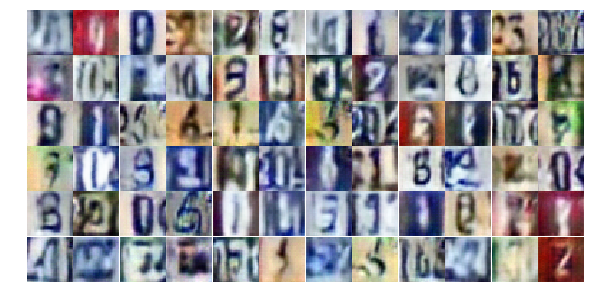

Epoch 18/25... Discriminator Loss: 1.2763... Generator Loss: 0.8343
Epoch 18/25... Discriminator Loss: 1.3675... Generator Loss: 0.6477
Epoch 18/25... Discriminator Loss: 1.2953... Generator Loss: 0.7359
Epoch 18/25... Discriminator Loss: 1.2269... Generator Loss: 0.8744
Epoch 18/25... Discriminator Loss: 1.3826... Generator Loss: 0.8614
Epoch 18/25... Discriminator Loss: 1.3179... Generator Loss: 0.7372
Epoch 18/25... Discriminator Loss: 1.2641... Generator Loss: 0.8596
Epoch 18/25... Discriminator Loss: 1.3454... Generator Loss: 0.7463
Epoch 18/25... Discriminator Loss: 1.2505... Generator Loss: 0.6984
Epoch 18/25... Discriminator Loss: 1.2957... Generator Loss: 0.8289


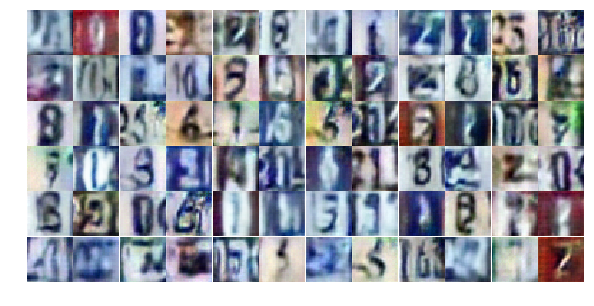

Epoch 18/25... Discriminator Loss: 1.0837... Generator Loss: 0.9269
Epoch 18/25... Discriminator Loss: 1.3502... Generator Loss: 0.7499
Epoch 18/25... Discriminator Loss: 1.2670... Generator Loss: 0.7422
Epoch 18/25... Discriminator Loss: 1.3372... Generator Loss: 0.7152
Epoch 18/25... Discriminator Loss: 1.3287... Generator Loss: 0.7561
Epoch 18/25... Discriminator Loss: 1.2707... Generator Loss: 0.7131
Epoch 18/25... Discriminator Loss: 1.3002... Generator Loss: 0.7854
Epoch 18/25... Discriminator Loss: 1.4220... Generator Loss: 0.6598
Epoch 18/25... Discriminator Loss: 1.1877... Generator Loss: 0.8445
Epoch 18/25... Discriminator Loss: 1.3140... Generator Loss: 0.6769


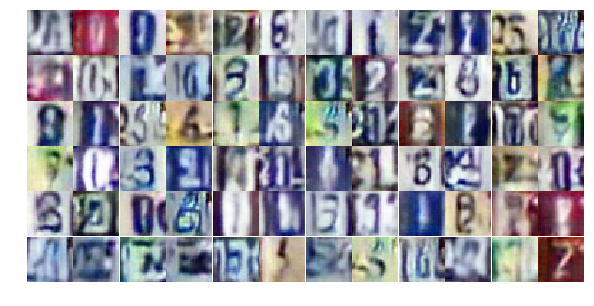

Epoch 18/25... Discriminator Loss: 1.2737... Generator Loss: 0.7442
Epoch 18/25... Discriminator Loss: 1.3512... Generator Loss: 0.7318
Epoch 18/25... Discriminator Loss: 1.3212... Generator Loss: 0.7593
Epoch 18/25... Discriminator Loss: 1.2527... Generator Loss: 0.7939
Epoch 18/25... Discriminator Loss: 1.2459... Generator Loss: 0.6772
Epoch 18/25... Discriminator Loss: 1.3707... Generator Loss: 0.6844
Epoch 18/25... Discriminator Loss: 1.3165... Generator Loss: 0.6691
Epoch 18/25... Discriminator Loss: 1.1274... Generator Loss: 0.9602
Epoch 18/25... Discriminator Loss: 1.3187... Generator Loss: 0.8752
Epoch 18/25... Discriminator Loss: 1.3415... Generator Loss: 0.8848


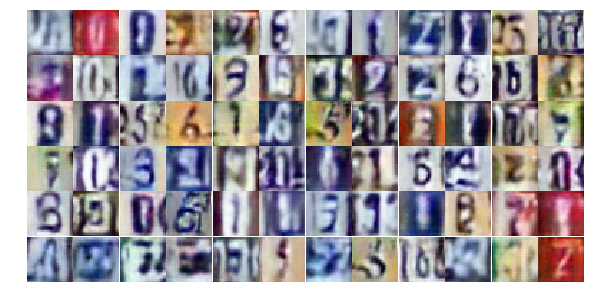

Epoch 18/25... Discriminator Loss: 1.2972... Generator Loss: 0.8338
Epoch 18/25... Discriminator Loss: 1.1897... Generator Loss: 0.7701
Epoch 18/25... Discriminator Loss: 1.3588... Generator Loss: 0.6810
Epoch 18/25... Discriminator Loss: 1.3527... Generator Loss: 0.6287
Epoch 18/25... Discriminator Loss: 1.4040... Generator Loss: 0.7581
Epoch 18/25... Discriminator Loss: 1.2541... Generator Loss: 0.7952
Epoch 18/25... Discriminator Loss: 1.3608... Generator Loss: 0.7412
Epoch 18/25... Discriminator Loss: 1.2441... Generator Loss: 0.8823
Epoch 18/25... Discriminator Loss: 1.4923... Generator Loss: 0.5868
Epoch 18/25... Discriminator Loss: 1.2812... Generator Loss: 0.7246


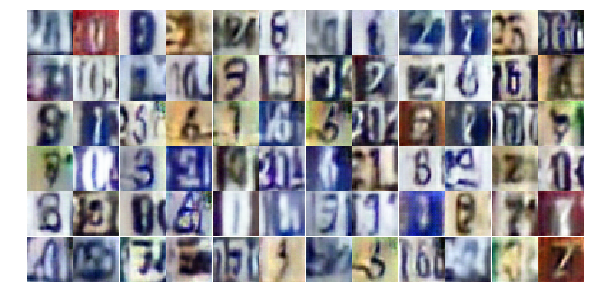

Epoch 18/25... Discriminator Loss: 1.2928... Generator Loss: 0.7235
Epoch 18/25... Discriminator Loss: 1.3146... Generator Loss: 0.7622
Epoch 18/25... Discriminator Loss: 1.3279... Generator Loss: 0.8279
Epoch 18/25... Discriminator Loss: 1.4163... Generator Loss: 0.6713
Epoch 18/25... Discriminator Loss: 1.1971... Generator Loss: 0.9291
Epoch 18/25... Discriminator Loss: 1.3253... Generator Loss: 0.7534
Epoch 18/25... Discriminator Loss: 1.2360... Generator Loss: 0.8146
Epoch 18/25... Discriminator Loss: 1.4017... Generator Loss: 0.8052
Epoch 18/25... Discriminator Loss: 1.2802... Generator Loss: 0.7537
Epoch 18/25... Discriminator Loss: 1.3460... Generator Loss: 0.6912


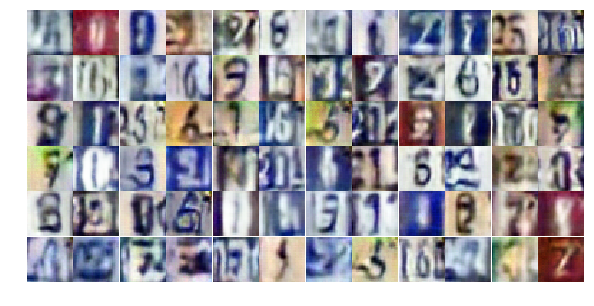

Epoch 18/25... Discriminator Loss: 1.3908... Generator Loss: 0.8084
Epoch 19/25... Discriminator Loss: 1.1560... Generator Loss: 0.8723
Epoch 19/25... Discriminator Loss: 1.3886... Generator Loss: 0.6346
Epoch 19/25... Discriminator Loss: 1.4662... Generator Loss: 0.6346
Epoch 19/25... Discriminator Loss: 1.3809... Generator Loss: 0.8794
Epoch 19/25... Discriminator Loss: 1.2755... Generator Loss: 0.7512
Epoch 19/25... Discriminator Loss: 1.3120... Generator Loss: 0.7385
Epoch 19/25... Discriminator Loss: 1.3475... Generator Loss: 0.7714
Epoch 19/25... Discriminator Loss: 1.3266... Generator Loss: 0.7435
Epoch 19/25... Discriminator Loss: 1.3562... Generator Loss: 0.6976


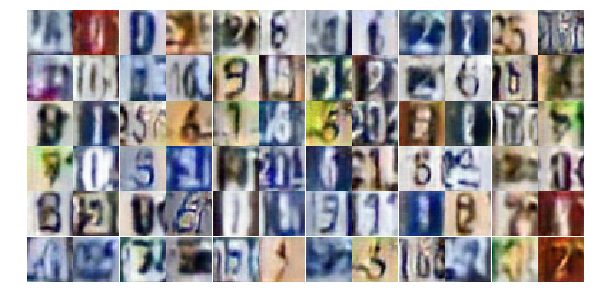

Epoch 19/25... Discriminator Loss: 1.2756... Generator Loss: 0.6936
Epoch 19/25... Discriminator Loss: 1.3415... Generator Loss: 0.7090
Epoch 19/25... Discriminator Loss: 1.2718... Generator Loss: 0.8301
Epoch 19/25... Discriminator Loss: 1.3642... Generator Loss: 0.6842
Epoch 19/25... Discriminator Loss: 1.3285... Generator Loss: 0.6954
Epoch 19/25... Discriminator Loss: 1.3039... Generator Loss: 0.6884
Epoch 19/25... Discriminator Loss: 1.1511... Generator Loss: 0.9325
Epoch 19/25... Discriminator Loss: 1.3315... Generator Loss: 0.8558
Epoch 19/25... Discriminator Loss: 1.3323... Generator Loss: 0.6162
Epoch 19/25... Discriminator Loss: 1.3310... Generator Loss: 0.7261


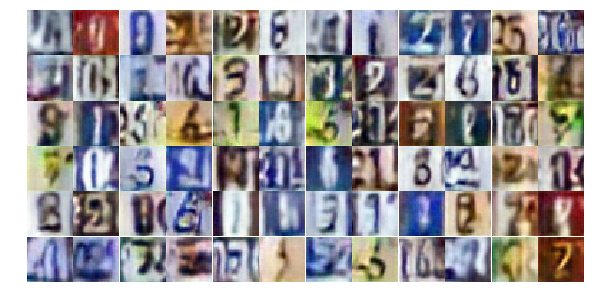

Epoch 19/25... Discriminator Loss: 1.4007... Generator Loss: 0.6023
Epoch 19/25... Discriminator Loss: 1.3213... Generator Loss: 0.7618
Epoch 19/25... Discriminator Loss: 1.2780... Generator Loss: 0.6810
Epoch 19/25... Discriminator Loss: 1.3453... Generator Loss: 0.6911
Epoch 19/25... Discriminator Loss: 1.3734... Generator Loss: 0.8259
Epoch 19/25... Discriminator Loss: 1.3078... Generator Loss: 0.7168
Epoch 19/25... Discriminator Loss: 1.2931... Generator Loss: 0.8518
Epoch 19/25... Discriminator Loss: 1.1713... Generator Loss: 0.8161
Epoch 19/25... Discriminator Loss: 1.2992... Generator Loss: 0.7058
Epoch 19/25... Discriminator Loss: 1.3747... Generator Loss: 0.7143


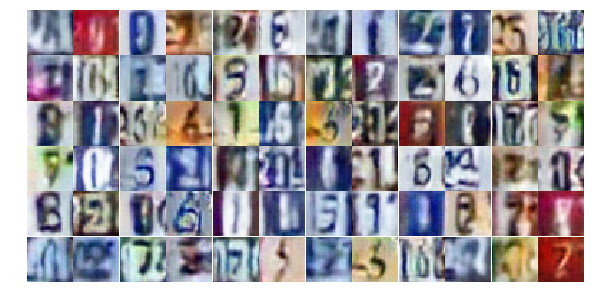

Epoch 19/25... Discriminator Loss: 1.2244... Generator Loss: 0.9297
Epoch 19/25... Discriminator Loss: 1.2600... Generator Loss: 0.7982
Epoch 19/25... Discriminator Loss: 1.2639... Generator Loss: 0.7200
Epoch 19/25... Discriminator Loss: 1.2825... Generator Loss: 0.7622
Epoch 19/25... Discriminator Loss: 1.2556... Generator Loss: 0.8168
Epoch 19/25... Discriminator Loss: 1.0329... Generator Loss: 1.0633
Epoch 19/25... Discriminator Loss: 1.2908... Generator Loss: 0.7972
Epoch 19/25... Discriminator Loss: 1.3733... Generator Loss: 1.0288
Epoch 19/25... Discriminator Loss: 1.3454... Generator Loss: 0.6674
Epoch 19/25... Discriminator Loss: 1.3046... Generator Loss: 0.6811


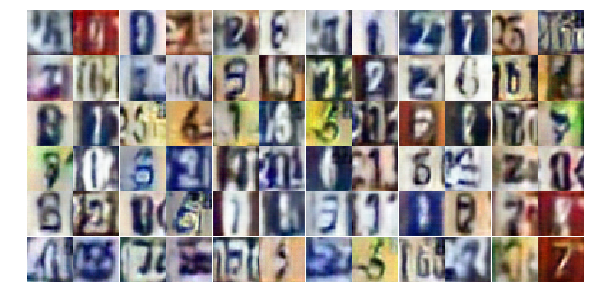

Epoch 19/25... Discriminator Loss: 1.2695... Generator Loss: 0.7182
Epoch 19/25... Discriminator Loss: 1.2796... Generator Loss: 0.6999
Epoch 19/25... Discriminator Loss: 1.1962... Generator Loss: 0.7562
Epoch 19/25... Discriminator Loss: 1.3498... Generator Loss: 0.7783
Epoch 19/25... Discriminator Loss: 1.2740... Generator Loss: 0.6792
Epoch 19/25... Discriminator Loss: 1.3221... Generator Loss: 0.6893
Epoch 19/25... Discriminator Loss: 1.2510... Generator Loss: 0.8410
Epoch 19/25... Discriminator Loss: 1.3061... Generator Loss: 0.8611
Epoch 19/25... Discriminator Loss: 1.2882... Generator Loss: 0.6887
Epoch 19/25... Discriminator Loss: 1.2063... Generator Loss: 0.8786


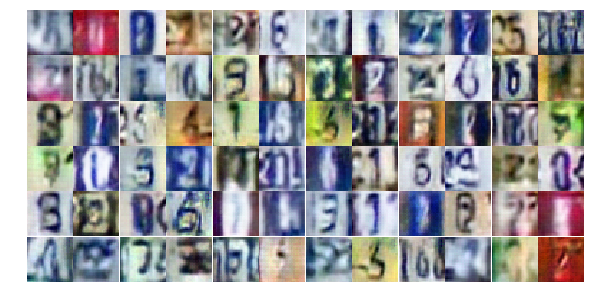

Epoch 19/25... Discriminator Loss: 1.2801... Generator Loss: 0.6699
Epoch 19/25... Discriminator Loss: 1.1382... Generator Loss: 0.8224
Epoch 19/25... Discriminator Loss: 1.2618... Generator Loss: 0.7411
Epoch 19/25... Discriminator Loss: 1.3022... Generator Loss: 0.7184
Epoch 19/25... Discriminator Loss: 1.6186... Generator Loss: 0.7019
Epoch 19/25... Discriminator Loss: 1.2187... Generator Loss: 0.8109
Epoch 19/25... Discriminator Loss: 1.3535... Generator Loss: 0.6734
Epoch 19/25... Discriminator Loss: 1.3430... Generator Loss: 0.7860
Epoch 20/25... Discriminator Loss: 1.5260... Generator Loss: 0.6093
Epoch 20/25... Discriminator Loss: 1.2692... Generator Loss: 0.7572


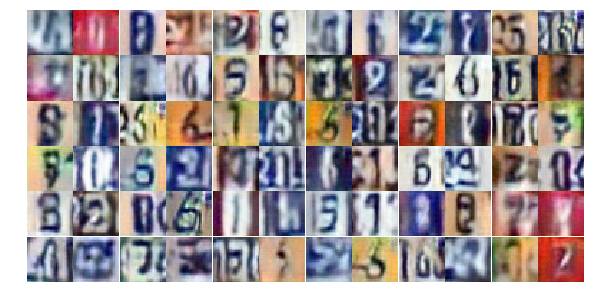

Epoch 20/25... Discriminator Loss: 1.4800... Generator Loss: 0.5994
Epoch 20/25... Discriminator Loss: 1.2891... Generator Loss: 0.8159
Epoch 20/25... Discriminator Loss: 1.2881... Generator Loss: 0.7506
Epoch 20/25... Discriminator Loss: 1.3956... Generator Loss: 0.6672
Epoch 20/25... Discriminator Loss: 1.3388... Generator Loss: 0.8155
Epoch 20/25... Discriminator Loss: 1.3365... Generator Loss: 0.7718
Epoch 20/25... Discriminator Loss: 1.3262... Generator Loss: 0.7859
Epoch 20/25... Discriminator Loss: 1.1578... Generator Loss: 0.9022
Epoch 20/25... Discriminator Loss: 1.3756... Generator Loss: 0.7020
Epoch 20/25... Discriminator Loss: 1.2321... Generator Loss: 0.8708


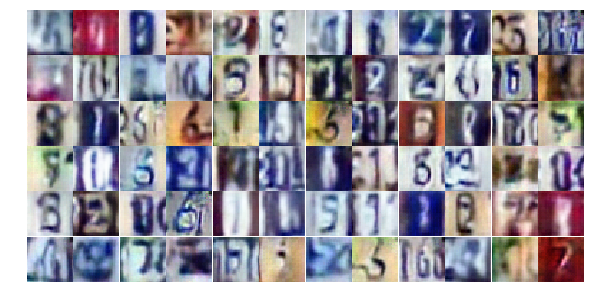

Epoch 20/25... Discriminator Loss: 1.3079... Generator Loss: 0.7339
Epoch 20/25... Discriminator Loss: 1.3349... Generator Loss: 0.7477
Epoch 20/25... Discriminator Loss: 1.2869... Generator Loss: 0.8252
Epoch 20/25... Discriminator Loss: 1.2215... Generator Loss: 0.8325
Epoch 20/25... Discriminator Loss: 1.3925... Generator Loss: 0.6757
Epoch 20/25... Discriminator Loss: 1.3010... Generator Loss: 0.7214
Epoch 20/25... Discriminator Loss: 1.2901... Generator Loss: 0.6604
Epoch 20/25... Discriminator Loss: 1.2536... Generator Loss: 0.7775
Epoch 20/25... Discriminator Loss: 1.3407... Generator Loss: 0.8032
Epoch 20/25... Discriminator Loss: 1.4068... Generator Loss: 0.6607


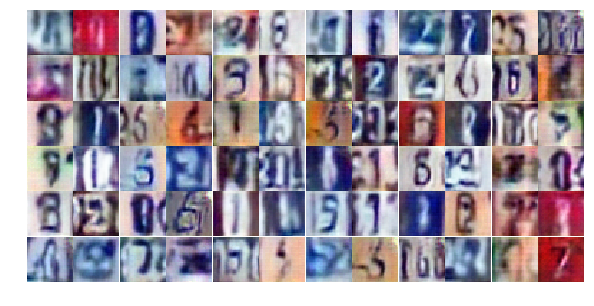

Epoch 20/25... Discriminator Loss: 1.2195... Generator Loss: 0.7844
Epoch 20/25... Discriminator Loss: 1.4668... Generator Loss: 0.6309
Epoch 20/25... Discriminator Loss: 1.2745... Generator Loss: 0.8412
Epoch 20/25... Discriminator Loss: 1.3946... Generator Loss: 0.7929
Epoch 20/25... Discriminator Loss: 1.3391... Generator Loss: 0.7532
Epoch 20/25... Discriminator Loss: 1.3030... Generator Loss: 0.7512
Epoch 20/25... Discriminator Loss: 1.3927... Generator Loss: 0.6432
Epoch 20/25... Discriminator Loss: 1.2594... Generator Loss: 0.7018
Epoch 20/25... Discriminator Loss: 1.3334... Generator Loss: 0.6644
Epoch 20/25... Discriminator Loss: 1.0572... Generator Loss: 0.8881


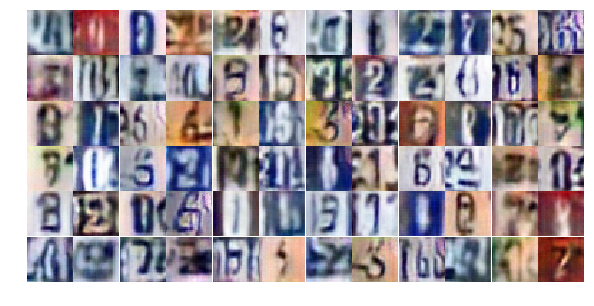

Epoch 20/25... Discriminator Loss: 1.3578... Generator Loss: 0.6484
Epoch 20/25... Discriminator Loss: 1.1990... Generator Loss: 0.7768
Epoch 20/25... Discriminator Loss: 1.3369... Generator Loss: 0.7452
Epoch 20/25... Discriminator Loss: 1.2465... Generator Loss: 0.8085
Epoch 20/25... Discriminator Loss: 1.3356... Generator Loss: 0.7503
Epoch 20/25... Discriminator Loss: 1.2807... Generator Loss: 0.7348
Epoch 20/25... Discriminator Loss: 1.2390... Generator Loss: 0.7107
Epoch 20/25... Discriminator Loss: 1.3219... Generator Loss: 0.6979
Epoch 20/25... Discriminator Loss: 1.3576... Generator Loss: 0.6931
Epoch 20/25... Discriminator Loss: 1.2754... Generator Loss: 0.7393


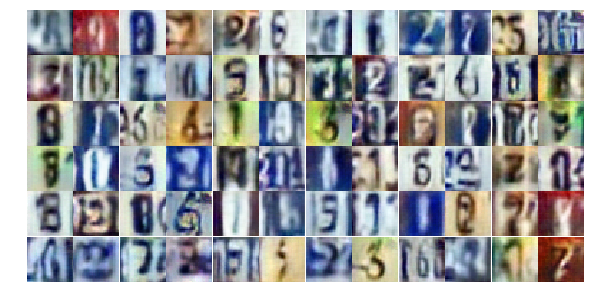

Epoch 20/25... Discriminator Loss: 1.2953... Generator Loss: 0.7181
Epoch 20/25... Discriminator Loss: 1.1246... Generator Loss: 0.8610
Epoch 20/25... Discriminator Loss: 1.3862... Generator Loss: 0.7414
Epoch 20/25... Discriminator Loss: 1.3098... Generator Loss: 0.7497
Epoch 20/25... Discriminator Loss: 1.2260... Generator Loss: 0.7941
Epoch 20/25... Discriminator Loss: 1.3503... Generator Loss: 0.6322
Epoch 20/25... Discriminator Loss: 1.2137... Generator Loss: 0.9024
Epoch 20/25... Discriminator Loss: 1.3470... Generator Loss: 0.7735
Epoch 20/25... Discriminator Loss: 1.4851... Generator Loss: 0.6766
Epoch 20/25... Discriminator Loss: 1.1913... Generator Loss: 1.0195


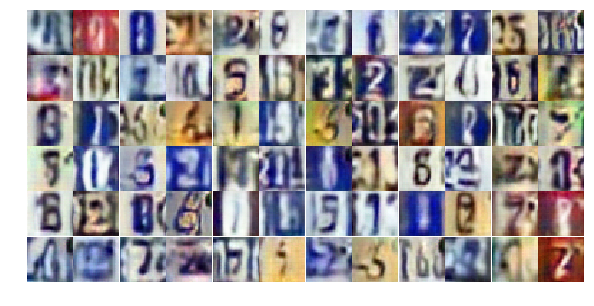

Epoch 20/25... Discriminator Loss: 1.4035... Generator Loss: 0.6957
Epoch 20/25... Discriminator Loss: 1.2386... Generator Loss: 0.7702
Epoch 20/25... Discriminator Loss: 1.4566... Generator Loss: 0.6367
Epoch 20/25... Discriminator Loss: 1.4904... Generator Loss: 0.7411
Epoch 20/25... Discriminator Loss: 1.3484... Generator Loss: 0.7652
Epoch 20/25... Discriminator Loss: 1.0245... Generator Loss: 0.9509
Epoch 21/25... Discriminator Loss: 1.3989... Generator Loss: 0.7016
Epoch 21/25... Discriminator Loss: 1.2599... Generator Loss: 0.7336
Epoch 21/25... Discriminator Loss: 1.2499... Generator Loss: 0.7332
Epoch 21/25... Discriminator Loss: 1.2362... Generator Loss: 0.6654


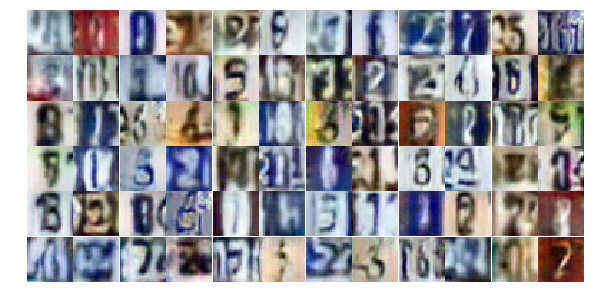

Epoch 21/25... Discriminator Loss: 1.3217... Generator Loss: 0.8793
Epoch 21/25... Discriminator Loss: 1.4156... Generator Loss: 0.5554
Epoch 21/25... Discriminator Loss: 1.2436... Generator Loss: 0.8336
Epoch 21/25... Discriminator Loss: 1.2771... Generator Loss: 0.7928
Epoch 21/25... Discriminator Loss: 1.3475... Generator Loss: 0.6901
Epoch 21/25... Discriminator Loss: 1.3266... Generator Loss: 0.7709
Epoch 21/25... Discriminator Loss: 1.2218... Generator Loss: 0.7712
Epoch 21/25... Discriminator Loss: 1.2478... Generator Loss: 0.8256
Epoch 21/25... Discriminator Loss: 1.3700... Generator Loss: 0.6997
Epoch 21/25... Discriminator Loss: 1.2818... Generator Loss: 0.7030


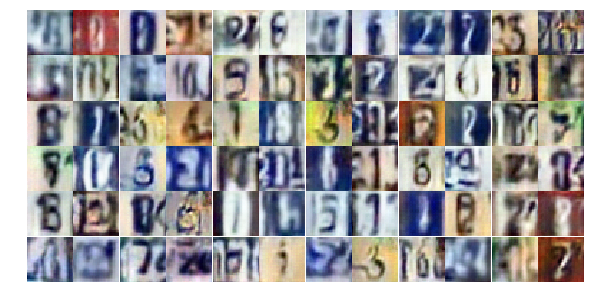

Epoch 21/25... Discriminator Loss: 1.3242... Generator Loss: 0.7912
Epoch 21/25... Discriminator Loss: 1.3760... Generator Loss: 0.7477
Epoch 21/25... Discriminator Loss: 1.3378... Generator Loss: 0.6446
Epoch 21/25... Discriminator Loss: 1.4090... Generator Loss: 0.6486
Epoch 21/25... Discriminator Loss: 1.3548... Generator Loss: 0.8984
Epoch 21/25... Discriminator Loss: 1.3953... Generator Loss: 0.6949
Epoch 21/25... Discriminator Loss: 1.2825... Generator Loss: 0.7119
Epoch 21/25... Discriminator Loss: 1.3323... Generator Loss: 0.7541
Epoch 21/25... Discriminator Loss: 1.2560... Generator Loss: 0.7657
Epoch 21/25... Discriminator Loss: 1.3733... Generator Loss: 0.7184


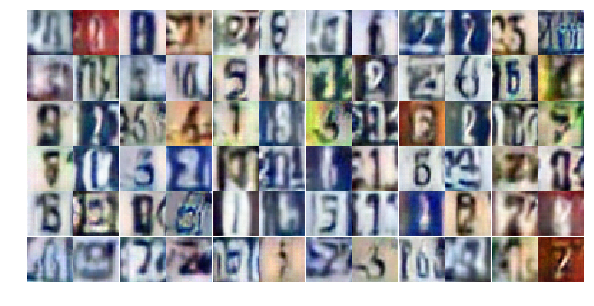

Epoch 21/25... Discriminator Loss: 1.3369... Generator Loss: 0.7638
Epoch 21/25... Discriminator Loss: 1.3290... Generator Loss: 0.9213
Epoch 21/25... Discriminator Loss: 1.3755... Generator Loss: 0.6417
Epoch 21/25... Discriminator Loss: 1.3036... Generator Loss: 0.6902
Epoch 21/25... Discriminator Loss: 1.3173... Generator Loss: 0.9310
Epoch 21/25... Discriminator Loss: 1.4088... Generator Loss: 0.6811
Epoch 21/25... Discriminator Loss: 1.2657... Generator Loss: 0.8220
Epoch 21/25... Discriminator Loss: 1.4023... Generator Loss: 0.6552
Epoch 21/25... Discriminator Loss: 1.2101... Generator Loss: 0.7988
Epoch 21/25... Discriminator Loss: 1.4904... Generator Loss: 0.6708


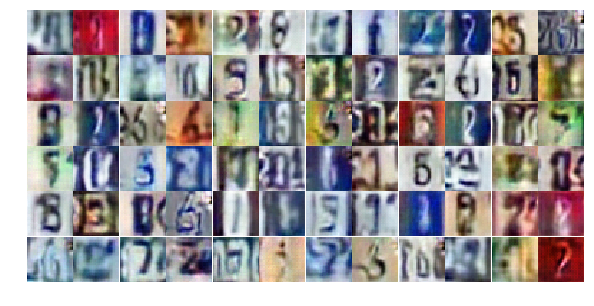

Epoch 21/25... Discriminator Loss: 1.5022... Generator Loss: 0.6797
Epoch 21/25... Discriminator Loss: 1.3031... Generator Loss: 0.7537
Epoch 21/25... Discriminator Loss: 1.3601... Generator Loss: 0.7097
Epoch 21/25... Discriminator Loss: 1.2723... Generator Loss: 0.8018
Epoch 21/25... Discriminator Loss: 1.3989... Generator Loss: 0.8203
Epoch 21/25... Discriminator Loss: 1.2556... Generator Loss: 0.7455
Epoch 21/25... Discriminator Loss: 1.3355... Generator Loss: 0.7996
Epoch 21/25... Discriminator Loss: 1.3781... Generator Loss: 0.6298
Epoch 21/25... Discriminator Loss: 1.2849... Generator Loss: 0.6727
Epoch 21/25... Discriminator Loss: 1.1298... Generator Loss: 1.1703


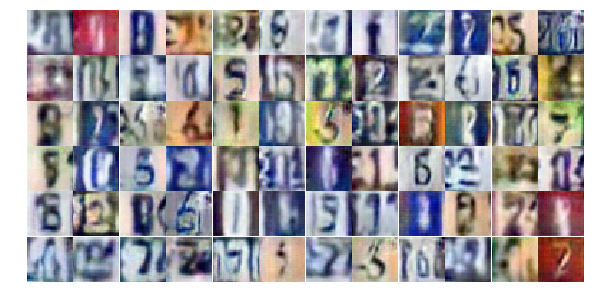

Epoch 21/25... Discriminator Loss: 1.4937... Generator Loss: 0.6814
Epoch 21/25... Discriminator Loss: 1.2398... Generator Loss: 0.7355
Epoch 21/25... Discriminator Loss: 1.2639... Generator Loss: 0.7890
Epoch 21/25... Discriminator Loss: 1.3601... Generator Loss: 0.7707
Epoch 21/25... Discriminator Loss: 1.3007... Generator Loss: 0.7623
Epoch 21/25... Discriminator Loss: 1.3285... Generator Loss: 0.7934
Epoch 21/25... Discriminator Loss: 1.4395... Generator Loss: 0.6649
Epoch 21/25... Discriminator Loss: 1.3979... Generator Loss: 0.7048
Epoch 21/25... Discriminator Loss: 1.4153... Generator Loss: 0.7475
Epoch 21/25... Discriminator Loss: 1.3199... Generator Loss: 0.7941


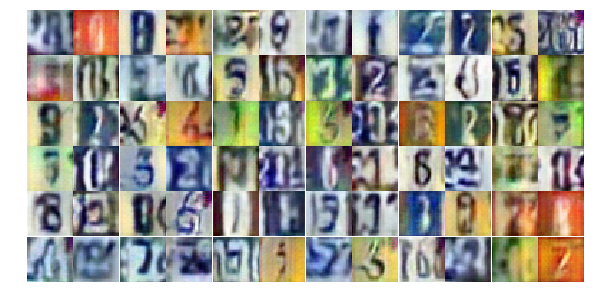

Epoch 21/25... Discriminator Loss: 1.4531... Generator Loss: 0.7447
Epoch 21/25... Discriminator Loss: 1.1474... Generator Loss: 0.8967
Epoch 21/25... Discriminator Loss: 1.2598... Generator Loss: 0.7590
Epoch 22/25... Discriminator Loss: 1.3873... Generator Loss: 0.7816
Epoch 22/25... Discriminator Loss: 1.2909... Generator Loss: 0.7473
Epoch 22/25... Discriminator Loss: 1.2993... Generator Loss: 0.6602
Epoch 22/25... Discriminator Loss: 1.3673... Generator Loss: 0.7569
Epoch 22/25... Discriminator Loss: 1.3901... Generator Loss: 0.7306
Epoch 22/25... Discriminator Loss: 1.3103... Generator Loss: 0.7397
Epoch 22/25... Discriminator Loss: 1.3325... Generator Loss: 0.7562


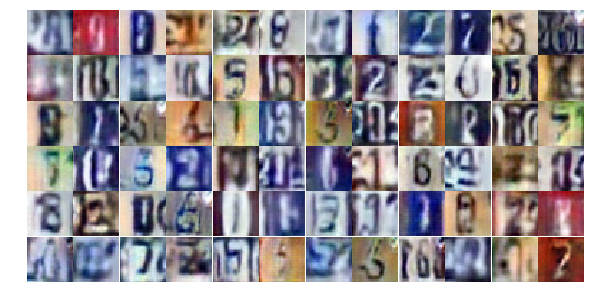

Epoch 22/25... Discriminator Loss: 1.3270... Generator Loss: 0.7445
Epoch 22/25... Discriminator Loss: 1.3833... Generator Loss: 0.7393
Epoch 22/25... Discriminator Loss: 1.3573... Generator Loss: 0.6402
Epoch 22/25... Discriminator Loss: 1.3328... Generator Loss: 0.6710
Epoch 22/25... Discriminator Loss: 1.3328... Generator Loss: 0.7139
Epoch 22/25... Discriminator Loss: 1.2831... Generator Loss: 0.6760
Epoch 22/25... Discriminator Loss: 1.3368... Generator Loss: 0.7775
Epoch 22/25... Discriminator Loss: 1.2663... Generator Loss: 0.8471
Epoch 22/25... Discriminator Loss: 1.3194... Generator Loss: 0.7603
Epoch 22/25... Discriminator Loss: 1.5749... Generator Loss: 0.5856


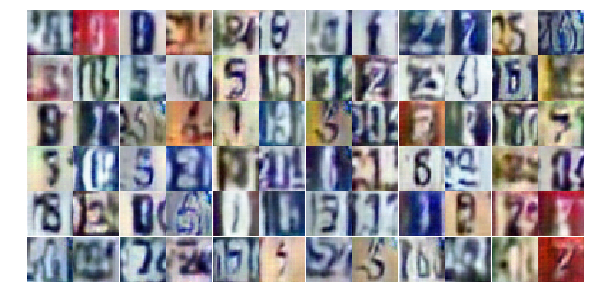

Epoch 22/25... Discriminator Loss: 1.1613... Generator Loss: 0.7770
Epoch 22/25... Discriminator Loss: 1.3225... Generator Loss: 0.8295
Epoch 22/25... Discriminator Loss: 1.3769... Generator Loss: 0.6869
Epoch 22/25... Discriminator Loss: 1.3084... Generator Loss: 0.7428
Epoch 22/25... Discriminator Loss: 1.2474... Generator Loss: 0.8438
Epoch 22/25... Discriminator Loss: 1.3482... Generator Loss: 0.6471
Epoch 22/25... Discriminator Loss: 1.2869... Generator Loss: 0.7091
Epoch 22/25... Discriminator Loss: 1.4016... Generator Loss: 0.6758
Epoch 22/25... Discriminator Loss: 1.3594... Generator Loss: 1.3554
Epoch 22/25... Discriminator Loss: 1.1039... Generator Loss: 1.0394


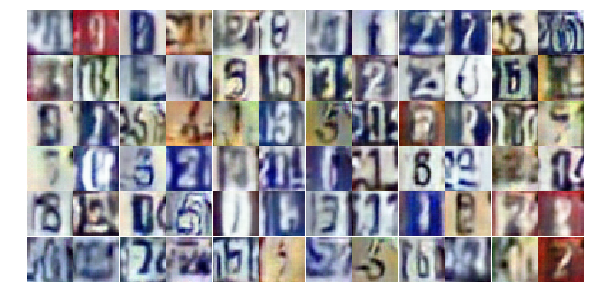

Epoch 22/25... Discriminator Loss: 1.2781... Generator Loss: 0.8007
Epoch 22/25... Discriminator Loss: 1.1441... Generator Loss: 0.8281
Epoch 22/25... Discriminator Loss: 1.1923... Generator Loss: 0.8366
Epoch 22/25... Discriminator Loss: 1.2861... Generator Loss: 0.7369
Epoch 22/25... Discriminator Loss: 1.3646... Generator Loss: 0.6988
Epoch 22/25... Discriminator Loss: 1.3545... Generator Loss: 0.8299
Epoch 22/25... Discriminator Loss: 1.3676... Generator Loss: 0.5910
Epoch 22/25... Discriminator Loss: 1.4690... Generator Loss: 0.7008
Epoch 22/25... Discriminator Loss: 1.4033... Generator Loss: 0.7256
Epoch 22/25... Discriminator Loss: 1.3245... Generator Loss: 0.7166


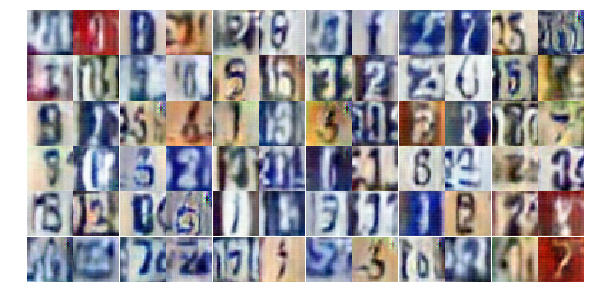

Epoch 22/25... Discriminator Loss: 1.3907... Generator Loss: 0.7171
Epoch 22/25... Discriminator Loss: 1.3021... Generator Loss: 0.7926
Epoch 22/25... Discriminator Loss: 1.2575... Generator Loss: 0.8007
Epoch 22/25... Discriminator Loss: 1.2366... Generator Loss: 0.9111
Epoch 22/25... Discriminator Loss: 1.2390... Generator Loss: 0.8195
Epoch 22/25... Discriminator Loss: 1.3625... Generator Loss: 0.7203
Epoch 22/25... Discriminator Loss: 1.3913... Generator Loss: 0.7723
Epoch 22/25... Discriminator Loss: 1.1918... Generator Loss: 0.8492
Epoch 22/25... Discriminator Loss: 1.1963... Generator Loss: 0.9298
Epoch 22/25... Discriminator Loss: 1.3039... Generator Loss: 0.7653


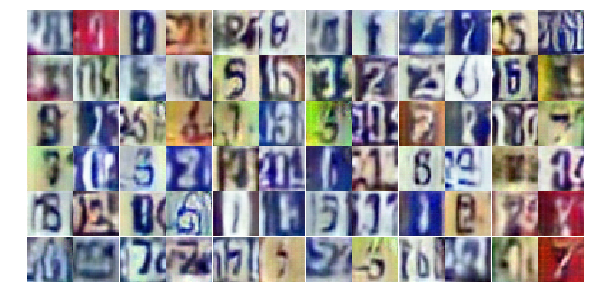

Epoch 22/25... Discriminator Loss: 1.3228... Generator Loss: 0.6510
Epoch 22/25... Discriminator Loss: 1.4485... Generator Loss: 0.6450
Epoch 22/25... Discriminator Loss: 1.3526... Generator Loss: 0.7143
Epoch 22/25... Discriminator Loss: 1.2765... Generator Loss: 0.7627
Epoch 22/25... Discriminator Loss: 1.2194... Generator Loss: 0.7646
Epoch 22/25... Discriminator Loss: 1.3735... Generator Loss: 0.7644
Epoch 22/25... Discriminator Loss: 1.2967... Generator Loss: 0.7514
Epoch 22/25... Discriminator Loss: 1.3392... Generator Loss: 0.8191
Epoch 22/25... Discriminator Loss: 1.3267... Generator Loss: 0.6636
Epoch 22/25... Discriminator Loss: 1.4136... Generator Loss: 0.7385


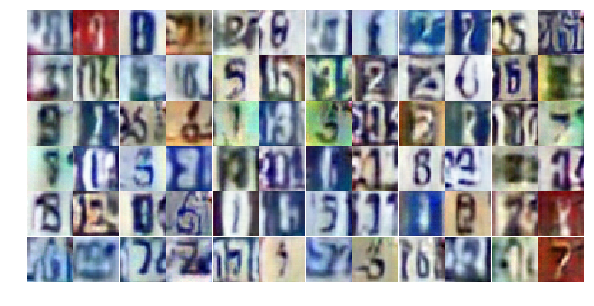

Epoch 23/25... Discriminator Loss: 1.1880... Generator Loss: 1.2154
Epoch 23/25... Discriminator Loss: 1.4020... Generator Loss: 0.6245
Epoch 23/25... Discriminator Loss: 1.4069... Generator Loss: 0.6571
Epoch 23/25... Discriminator Loss: 1.4911... Generator Loss: 0.5447
Epoch 23/25... Discriminator Loss: 1.3379... Generator Loss: 0.6724
Epoch 23/25... Discriminator Loss: 1.1247... Generator Loss: 0.9180
Epoch 23/25... Discriminator Loss: 1.4437... Generator Loss: 0.5791
Epoch 23/25... Discriminator Loss: 1.2965... Generator Loss: 0.7322
Epoch 23/25... Discriminator Loss: 1.2471... Generator Loss: 0.7347
Epoch 23/25... Discriminator Loss: 1.2899... Generator Loss: 0.7941


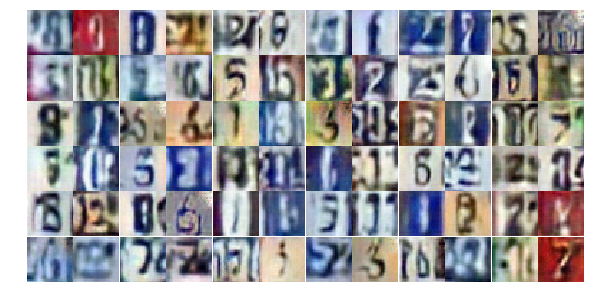

Epoch 23/25... Discriminator Loss: 1.2919... Generator Loss: 0.7142
Epoch 23/25... Discriminator Loss: 1.3246... Generator Loss: 0.7535
Epoch 23/25... Discriminator Loss: 1.3216... Generator Loss: 0.7203
Epoch 23/25... Discriminator Loss: 1.2744... Generator Loss: 0.7162
Epoch 23/25... Discriminator Loss: 1.1676... Generator Loss: 0.9146
Epoch 23/25... Discriminator Loss: 1.4314... Generator Loss: 0.6675
Epoch 23/25... Discriminator Loss: 1.3205... Generator Loss: 1.0172
Epoch 23/25... Discriminator Loss: 1.2622... Generator Loss: 0.7323
Epoch 23/25... Discriminator Loss: 1.2369... Generator Loss: 0.7516
Epoch 23/25... Discriminator Loss: 1.2688... Generator Loss: 0.7521


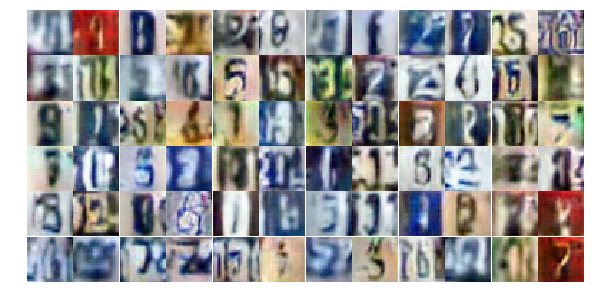

Epoch 23/25... Discriminator Loss: 1.2722... Generator Loss: 0.6891
Epoch 23/25... Discriminator Loss: 1.2763... Generator Loss: 0.8099
Epoch 23/25... Discriminator Loss: 1.1840... Generator Loss: 0.8060
Epoch 23/25... Discriminator Loss: 1.2567... Generator Loss: 0.7493
Epoch 23/25... Discriminator Loss: 1.2431... Generator Loss: 0.8616
Epoch 23/25... Discriminator Loss: 1.1924... Generator Loss: 0.7791
Epoch 23/25... Discriminator Loss: 1.2970... Generator Loss: 0.7751
Epoch 23/25... Discriminator Loss: 1.3253... Generator Loss: 0.7338
Epoch 23/25... Discriminator Loss: 1.3515... Generator Loss: 0.8158
Epoch 23/25... Discriminator Loss: 1.3186... Generator Loss: 0.6276


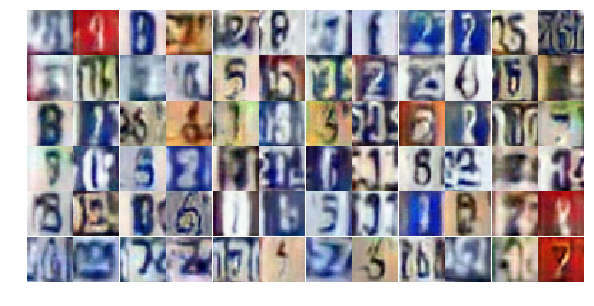

Epoch 23/25... Discriminator Loss: 1.3841... Generator Loss: 0.6924
Epoch 23/25... Discriminator Loss: 1.3974... Generator Loss: 0.7399
Epoch 23/25... Discriminator Loss: 1.3377... Generator Loss: 0.7218
Epoch 23/25... Discriminator Loss: 1.3594... Generator Loss: 0.6922
Epoch 23/25... Discriminator Loss: 1.3200... Generator Loss: 0.6494
Epoch 23/25... Discriminator Loss: 1.3478... Generator Loss: 0.6013
Epoch 23/25... Discriminator Loss: 1.5157... Generator Loss: 0.6379
Epoch 23/25... Discriminator Loss: 1.1715... Generator Loss: 0.8254
Epoch 23/25... Discriminator Loss: 1.4288... Generator Loss: 0.7250
Epoch 23/25... Discriminator Loss: 1.3272... Generator Loss: 0.7694


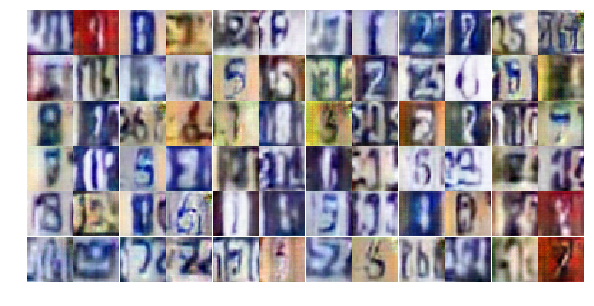

Epoch 23/25... Discriminator Loss: 1.3102... Generator Loss: 0.6703
Epoch 23/25... Discriminator Loss: 1.3680... Generator Loss: 0.5958
Epoch 23/25... Discriminator Loss: 1.3932... Generator Loss: 0.6748
Epoch 23/25... Discriminator Loss: 1.3044... Generator Loss: 0.8182
Epoch 23/25... Discriminator Loss: 1.2640... Generator Loss: 0.9958
Epoch 23/25... Discriminator Loss: 1.3292... Generator Loss: 0.6559
Epoch 23/25... Discriminator Loss: 1.2659... Generator Loss: 0.8085
Epoch 23/25... Discriminator Loss: 1.3687... Generator Loss: 0.6996
Epoch 23/25... Discriminator Loss: 1.2185... Generator Loss: 0.7010
Epoch 23/25... Discriminator Loss: 1.3775... Generator Loss: 0.7856


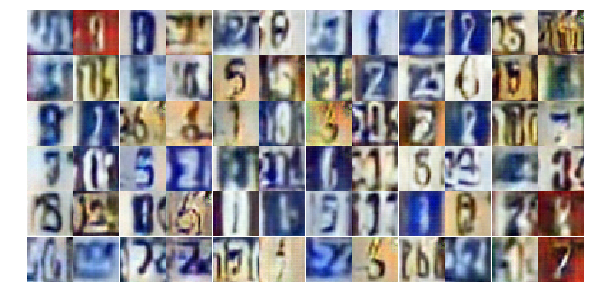

Epoch 23/25... Discriminator Loss: 1.2508... Generator Loss: 0.7475
Epoch 23/25... Discriminator Loss: 1.3696... Generator Loss: 0.7038
Epoch 23/25... Discriminator Loss: 1.2250... Generator Loss: 0.9027
Epoch 23/25... Discriminator Loss: 1.1062... Generator Loss: 0.8340
Epoch 23/25... Discriminator Loss: 1.2931... Generator Loss: 0.8243
Epoch 23/25... Discriminator Loss: 1.4021... Generator Loss: 0.8033
Epoch 23/25... Discriminator Loss: 1.2661... Generator Loss: 0.6970
Epoch 24/25... Discriminator Loss: 1.1569... Generator Loss: 0.8224
Epoch 24/25... Discriminator Loss: 1.2987... Generator Loss: 0.7418
Epoch 24/25... Discriminator Loss: 1.1765... Generator Loss: 0.7399


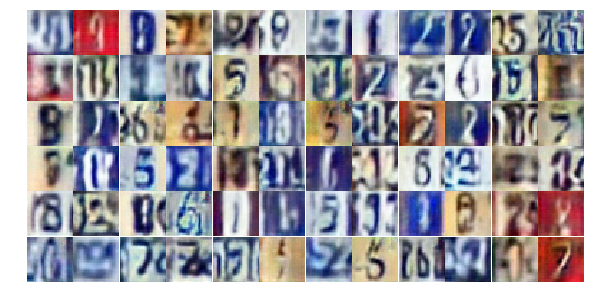

Epoch 24/25... Discriminator Loss: 1.1777... Generator Loss: 0.7852
Epoch 24/25... Discriminator Loss: 1.3926... Generator Loss: 0.7958
Epoch 24/25... Discriminator Loss: 1.3539... Generator Loss: 0.6453
Epoch 24/25... Discriminator Loss: 1.3704... Generator Loss: 0.7561
Epoch 24/25... Discriminator Loss: 1.2773... Generator Loss: 0.6923
Epoch 24/25... Discriminator Loss: 1.3601... Generator Loss: 0.7028
Epoch 24/25... Discriminator Loss: 1.3914... Generator Loss: 0.7214
Epoch 24/25... Discriminator Loss: 1.2521... Generator Loss: 0.7265
Epoch 24/25... Discriminator Loss: 1.4406... Generator Loss: 0.6263
Epoch 24/25... Discriminator Loss: 1.1741... Generator Loss: 0.8972


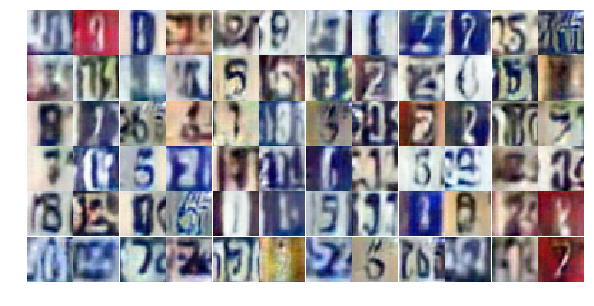

Epoch 24/25... Discriminator Loss: 1.3029... Generator Loss: 0.6855
Epoch 24/25... Discriminator Loss: 1.3741... Generator Loss: 0.6685
Epoch 24/25... Discriminator Loss: 1.2097... Generator Loss: 0.7864
Epoch 24/25... Discriminator Loss: 1.2642... Generator Loss: 0.8576
Epoch 24/25... Discriminator Loss: 1.4660... Generator Loss: 0.5794
Epoch 24/25... Discriminator Loss: 1.2433... Generator Loss: 0.7755
Epoch 24/25... Discriminator Loss: 1.3704... Generator Loss: 0.7105
Epoch 24/25... Discriminator Loss: 1.3535... Generator Loss: 0.6973
Epoch 24/25... Discriminator Loss: 1.4170... Generator Loss: 0.5997
Epoch 24/25... Discriminator Loss: 1.4343... Generator Loss: 0.7069


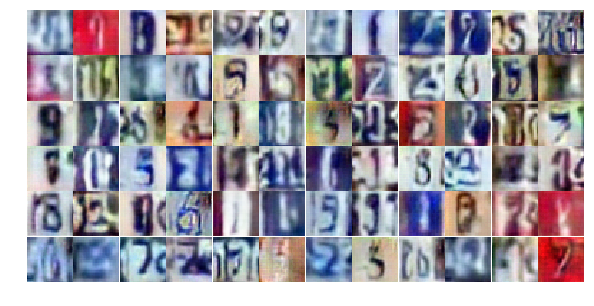

Epoch 24/25... Discriminator Loss: 1.2913... Generator Loss: 0.7559
Epoch 24/25... Discriminator Loss: 1.3671... Generator Loss: 0.6772
Epoch 24/25... Discriminator Loss: 1.5431... Generator Loss: 0.8148
Epoch 24/25... Discriminator Loss: 1.4060... Generator Loss: 0.6906
Epoch 24/25... Discriminator Loss: 1.2855... Generator Loss: 0.8702
Epoch 24/25... Discriminator Loss: 1.0621... Generator Loss: 0.9304
Epoch 24/25... Discriminator Loss: 1.1979... Generator Loss: 0.8795
Epoch 24/25... Discriminator Loss: 1.4074... Generator Loss: 0.7207
Epoch 24/25... Discriminator Loss: 1.3959... Generator Loss: 0.7184
Epoch 24/25... Discriminator Loss: 1.2660... Generator Loss: 0.7871


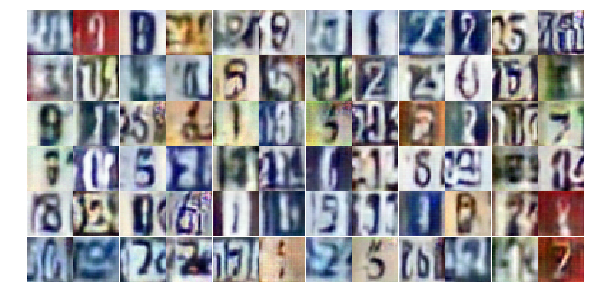

Epoch 24/25... Discriminator Loss: 1.3046... Generator Loss: 0.7517
Epoch 24/25... Discriminator Loss: 1.4281... Generator Loss: 0.5858
Epoch 24/25... Discriminator Loss: 1.4591... Generator Loss: 0.6648
Epoch 24/25... Discriminator Loss: 1.3423... Generator Loss: 0.6185
Epoch 24/25... Discriminator Loss: 1.5131... Generator Loss: 0.5110
Epoch 24/25... Discriminator Loss: 0.9683... Generator Loss: 0.9903
Epoch 24/25... Discriminator Loss: 1.2854... Generator Loss: 0.8721
Epoch 24/25... Discriminator Loss: 1.3061... Generator Loss: 0.7564
Epoch 24/25... Discriminator Loss: 1.4198... Generator Loss: 0.7480
Epoch 24/25... Discriminator Loss: 1.3306... Generator Loss: 0.6206


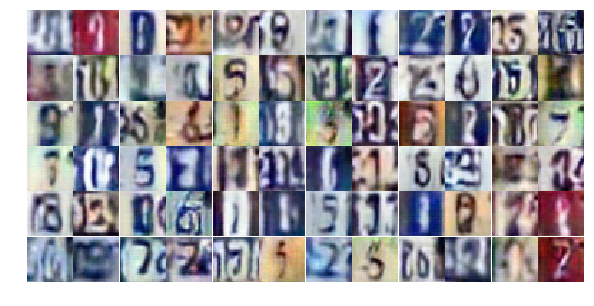

Epoch 24/25... Discriminator Loss: 1.2963... Generator Loss: 0.7176
Epoch 24/25... Discriminator Loss: 1.3649... Generator Loss: 0.7144
Epoch 24/25... Discriminator Loss: 1.2875... Generator Loss: 0.7408
Epoch 24/25... Discriminator Loss: 1.2887... Generator Loss: 0.7806
Epoch 24/25... Discriminator Loss: 1.1922... Generator Loss: 0.8780
Epoch 24/25... Discriminator Loss: 1.4751... Generator Loss: 0.6892
Epoch 24/25... Discriminator Loss: 1.3654... Generator Loss: 0.6712
Epoch 24/25... Discriminator Loss: 1.4104... Generator Loss: 0.9166
Epoch 24/25... Discriminator Loss: 1.4308... Generator Loss: 0.5985
Epoch 24/25... Discriminator Loss: 1.3263... Generator Loss: 0.7395


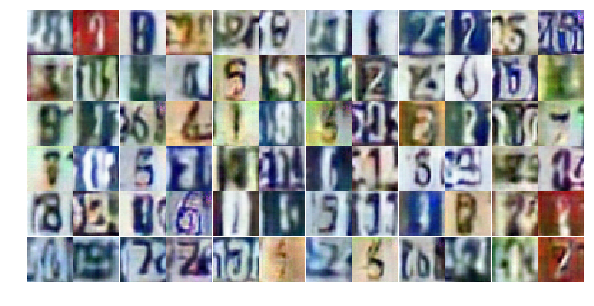

Epoch 24/25... Discriminator Loss: 1.2621... Generator Loss: 0.7218
Epoch 24/25... Discriminator Loss: 1.2987... Generator Loss: 0.8035
Epoch 24/25... Discriminator Loss: 1.4202... Generator Loss: 0.6313
Epoch 24/25... Discriminator Loss: 1.3236... Generator Loss: 0.7444
Epoch 24/25... Discriminator Loss: 1.3809... Generator Loss: 0.6983
Epoch 25/25... Discriminator Loss: 1.3906... Generator Loss: 0.6994
Epoch 25/25... Discriminator Loss: 1.2821... Generator Loss: 0.8165
Epoch 25/25... Discriminator Loss: 1.2172... Generator Loss: 0.8161
Epoch 25/25... Discriminator Loss: 1.3639... Generator Loss: 0.6870
Epoch 25/25... Discriminator Loss: 1.3258... Generator Loss: 0.7233


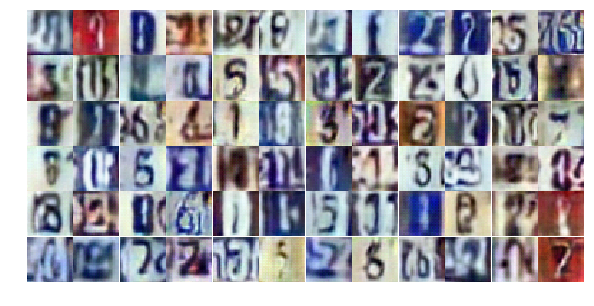

Epoch 25/25... Discriminator Loss: 1.2873... Generator Loss: 0.7685
Epoch 25/25... Discriminator Loss: 1.3765... Generator Loss: 0.6683
Epoch 25/25... Discriminator Loss: 1.2988... Generator Loss: 0.7443
Epoch 25/25... Discriminator Loss: 1.3442... Generator Loss: 0.6852
Epoch 25/25... Discriminator Loss: 1.3606... Generator Loss: 0.7063
Epoch 25/25... Discriminator Loss: 1.4039... Generator Loss: 0.6091
Epoch 25/25... Discriminator Loss: 1.3811... Generator Loss: 0.6888
Epoch 25/25... Discriminator Loss: 1.3558... Generator Loss: 0.8147
Epoch 25/25... Discriminator Loss: 1.3581... Generator Loss: 0.7331
Epoch 25/25... Discriminator Loss: 1.3355... Generator Loss: 0.7542


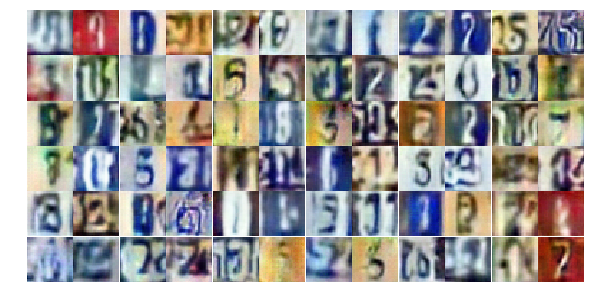

Epoch 25/25... Discriminator Loss: 1.4583... Generator Loss: 0.6658
Epoch 25/25... Discriminator Loss: 1.2752... Generator Loss: 0.7111
Epoch 25/25... Discriminator Loss: 1.4025... Generator Loss: 0.7428
Epoch 25/25... Discriminator Loss: 1.3118... Generator Loss: 0.7107
Epoch 25/25... Discriminator Loss: 1.3665... Generator Loss: 0.8837
Epoch 25/25... Discriminator Loss: 1.3035... Generator Loss: 0.7793
Epoch 25/25... Discriminator Loss: 1.3368... Generator Loss: 0.7292
Epoch 25/25... Discriminator Loss: 1.3491... Generator Loss: 0.6533
Epoch 25/25... Discriminator Loss: 1.4829... Generator Loss: 0.6279
Epoch 25/25... Discriminator Loss: 1.3279... Generator Loss: 0.6825


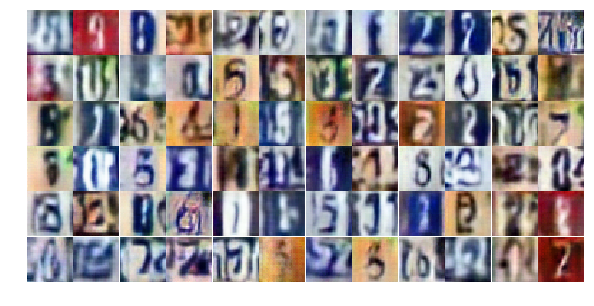

Epoch 25/25... Discriminator Loss: 1.3387... Generator Loss: 0.6342
Epoch 25/25... Discriminator Loss: 1.2793... Generator Loss: 0.7801
Epoch 25/25... Discriminator Loss: 1.4073... Generator Loss: 0.6468
Epoch 25/25... Discriminator Loss: 1.3561... Generator Loss: 0.7894
Epoch 25/25... Discriminator Loss: 1.3998... Generator Loss: 0.6497
Epoch 25/25... Discriminator Loss: 1.3746... Generator Loss: 0.6681
Epoch 25/25... Discriminator Loss: 1.4148... Generator Loss: 0.7215
Epoch 25/25... Discriminator Loss: 1.2489... Generator Loss: 0.7592
Epoch 25/25... Discriminator Loss: 1.3109... Generator Loss: 0.6594
Epoch 25/25... Discriminator Loss: 1.2228... Generator Loss: 0.8408


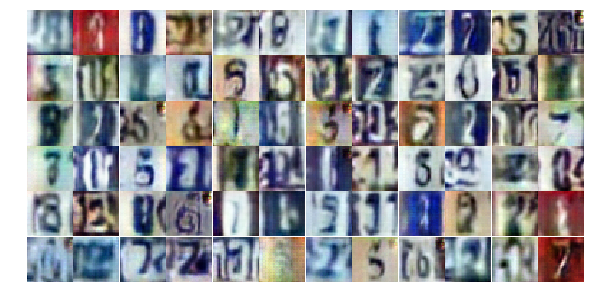

Epoch 25/25... Discriminator Loss: 1.5218... Generator Loss: 0.7183
Epoch 25/25... Discriminator Loss: 1.4240... Generator Loss: 0.6386
Epoch 25/25... Discriminator Loss: 1.3502... Generator Loss: 0.7235
Epoch 25/25... Discriminator Loss: 1.4786... Generator Loss: 0.7518
Epoch 25/25... Discriminator Loss: 1.3972... Generator Loss: 0.6432
Epoch 25/25... Discriminator Loss: 1.3792... Generator Loss: 0.7279
Epoch 25/25... Discriminator Loss: 1.3060... Generator Loss: 0.7784
Epoch 25/25... Discriminator Loss: 1.1103... Generator Loss: 0.8355
Epoch 25/25... Discriminator Loss: 1.2603... Generator Loss: 0.6981
Epoch 25/25... Discriminator Loss: 1.2284... Generator Loss: 0.8496


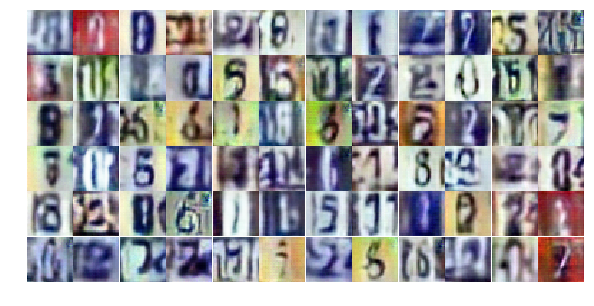

Epoch 25/25... Discriminator Loss: 1.4323... Generator Loss: 0.6769
Epoch 25/25... Discriminator Loss: 1.3411... Generator Loss: 0.6570
Epoch 25/25... Discriminator Loss: 1.3274... Generator Loss: 0.7651
Epoch 25/25... Discriminator Loss: 1.3781... Generator Loss: 0.7402
Epoch 25/25... Discriminator Loss: 1.3876... Generator Loss: 0.6976
Epoch 25/25... Discriminator Loss: 1.2698... Generator Loss: 0.8134
Epoch 25/25... Discriminator Loss: 1.4357... Generator Loss: 0.6957
Epoch 25/25... Discriminator Loss: 1.2642... Generator Loss: 0.7008
Epoch 25/25... Discriminator Loss: 1.2884... Generator Loss: 0.7355
Epoch 25/25... Discriminator Loss: 1.2271... Generator Loss: 0.7979


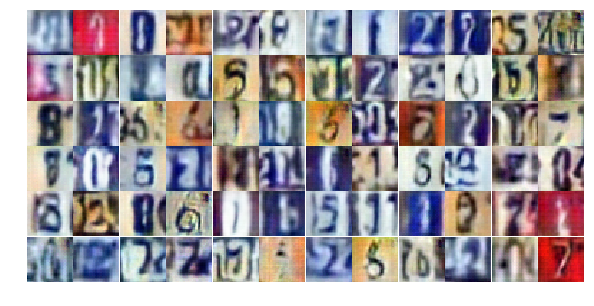

Epoch 25/25... Discriminator Loss: 1.3369... Generator Loss: 0.8072
Epoch 25/25... Discriminator Loss: 1.3917... Generator Loss: 0.6001


In [21]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

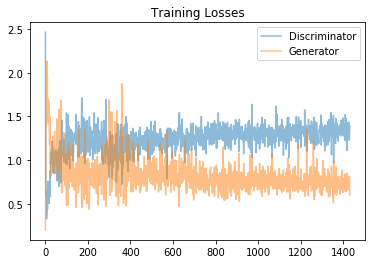

In [22]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

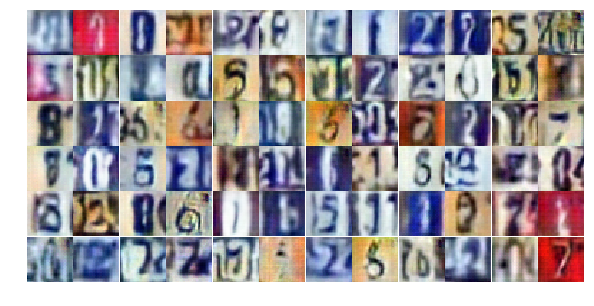

In [23]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))